#<font color="ceylan">LIBRAIRIES

In [ ]:
pip install shap

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 540.1/540.1 kB 17.0 MB/s eta 0:00:00


In [ ]:
import numpy as np
import pandas as pd
import gc
import time
from contextlib import contextmanager
from sklearn.model_selection import KFold, StratifiedKFold, train_test_split
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
import json
import plotly.graph_objs as go


from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score,roc_curve,auc
from sklearn.dummy import DummyClassifier
import lightgbm as lgb
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from sklearn.model_selection import StratifiedKFold, RandomizedSearchCV
from sklearn.model_selection import GridSearchCV, StratifiedKFold
from sklearn.base import BaseEstimator
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from contextlib import contextmanager
import time

@contextmanager
def timer(name):
    """Contexte pour chronométrer un bloc de code."""
    start_time = time.time()
    yield
    end_time = time.time()
    print(f"{name} a pris {end_time - start_time:.2f} secondes.")


import flask
from flask import Flask, request, jsonify
import xgboost as xgb
import pickle
import threading
import requests

from scipy.stats import spearmanr
from itertools import islice
from sklearn.preprocessing import OneHotEncoder
from sklearn.utils import class_weight
from sklearn.metrics import confusion_matrix

import shap

/usr/local/lib/python3.10/dist-packages/dask/dataframe/__init__.py:42: FutureWarning: 
Dask dataframe query planning is disabled because dask-expr is not installed.

You can install it with `pip install dask[dataframe]` or `conda install dask`.
This will raise in a future version.

  warnings.warn(msg, FutureWarning)


In [ ]:
print(xgb.__version__)

2.1.1


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import os
data_dir = '/content/data'
os.makedirs(data_dir, exist_ok=True)

In [ ]:
!cp /content/drive/MyDrive/P7/*.csv /content/data/

#<font color="ceylan">Enregistrements

In [ ]:
cleaned_df_1 = pd.read_csv('/content/drive/MyDrive/P7/cleaned_df_1.csv')

In [ ]:
sample_10 = pd.read_csv('/content/drive/MyDrive/P7/sample_10.csv')

In [ ]:
sample_10.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 49650 entries, 0 to 49649
Columns: 521 entries, SK_ID_CURR to CC_NAME_CONTRACT_STATUS_nan_VAR
dtypes: bool(128), float64(344), int64(39), object(10)
memory usage: 154.9+ MB


In [ ]:
df_final_train = pd.read_csv('/content/drive/MyDrive/P7/df_final_train.csv')

In [ ]:
df_final_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 49650 entries, 0 to 49649
Columns: 301 entries, EXT_SOURCE_3 to TARGET
dtypes: bool(50), float64(235), int64(16)
memory usage: 97.4 MB


In [ ]:
df_final_test = pd.read_csv('/content/drive/MyDrive/P7/df_final_test.csv')

In [ ]:
df_final_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307507 entries, 0 to 307506
Columns: 300 entries, EXT_SOURCE_3 to CLOSED_MONTHS_BALANCE_MAX_MAX
dtypes: bool(50), float64(235), int64(15)
memory usage: 601.2 MB


In [ ]:
df_final_test_limited = df_final_test.head(100)

In [ ]:
df_final_test_limited.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Columns: 300 entries, EXT_SOURCE_3 to CLOSED_MONTHS_BALANCE_MAX_MAX
dtypes: bool(50), float64(235), int64(15)
memory usage: 200.3 KB


In [ ]:
df_final_test_limited.to_csv('/content/drive/MyDrive/P7/df_final_test_limited.csv', index=False)

In [ ]:
df_final_test_limited.head()

,EXT_SOURCE_3,EXT_SOURCE_2,NAME_EDUCATION_TYPE_Secondary / secondary special,CODE_GENDER,NAME_CONTRACT_TYPE_Revolving loans,EXT_SOURCE_1,CC_CNT_DRAWINGS_ATM_CURRENT_MEAN,FLAG_DOCUMENT_3,PREV_NAME_PRODUCT_TYPE_walk-in_MEAN,BURO_CREDIT_TYPE_Microloan_MEAN,...,HOUR_APPR_PROCESS_START,ORGANIZATION_TYPE_University,"PREV_NAME_TYPE_SUITE_Spouse, partner_MEAN",FLAG_OWN_CAR,CLOSED_AMT_CREDIT_SUM_LIMIT_SUM,ORGANIZATION_TYPE_Transport: type 3,CLOSED_AMT_CREDIT_SUM_LIMIT_MEAN,FONDKAPREMONT_MODE_not specified,OCCUPATION_TYPE_Sales staff,CLOSED_MONTHS_BALANCE_MAX_MAX
0,0.139376,0.262949,True,0,False,0.083037,NaN,1,0.000000,0.0,...,10,False,0.0,0,0.0,False,0.0,False,False,0.0
1,NaN,0.622246,False,1,False,0.311267,NaN,1,0.000000,0.0,...,11,False,0.0,0,0.0,False,0.0,False,False,NaN
2,0.729567,0.555912,True,0,True,NaN,NaN,0,0.000000,0.0,...,9,False,0.0,1,0.0,False,0.0,False,False,NaN
3,NaN,0.650442,True,1,False,NaN,NaN,1,0.000000,NaN,...,17,False,0.0,0,NaN,False,NaN,False,False,NaN
4,NaN,0.322738,True,0,False,NaN,NaN,0,0.166667,0.0,...,11,False,0.0,0,0.0,False,0.0,False,False,NaN


#<font color="yellow">Préparation des données à l'aide d'un kernel pré-établit

#COMPÉTITION SUR LE RISQUE DE DÉFAUT DE CRÉDIT À DOMICILE

La plupart des caractéristiques sont créées en appliquant les fonctions min, max, mean, sum et var à des tables groupées.
Peu de sélection de caractéristiques est effectuée et le sur-apprentissage pourrait être un problème car de nombreuses caractéristiques sont liées.
Les principales idées suivantes ont été utilisées :
  - Diviser ou soustraire des caractéristiques importantes pour obtenir des taux (comme l'annuité et le revenu)
  - Dans les données du Bureau : créer des caractéristiques spécifiques pour les crédits actifs et les crédits fermés
  - Dans les demandes précédentes : créer des caractéristiques spécifiques pour les demandes approuvées et refusées
  - Modularité : une fonction pour chaque table (sauf bureau_balance et application_test)
  - Codage One-Hot pour les caractéristiques catégorielles

Toutes les tables sont jointes avec le DF d'application en utilisant la clé SK_ID_CURR (sauf bureau_balance).


In [ ]:
import numpy as np
import pandas as pd
import gc
import time
from contextlib import contextmanager
from lightgbm import LGBMClassifier
from sklearn.metrics import roc_auc_score, roc_curve
from sklearn.model_selection import KFold, StratifiedKFold, train_test_split
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
import json

warnings.simplefilter(action='ignore', category=FutureWarning)


PATH = "/content/drive/MyDrive/"

NUM_ROWS = 500000

@contextmanager
def timer(title):
    t0 = time.time()
    yield
    print("{} - terminé en {:.0f}s".format(title, time.time() - t0))

# Codage One-Hot pour les colonnes catégorielles avec get_dummies
def one_hot_encoder(df, nan_as_category = True):
    original_columns = list(df.columns)
    categorical_columns = [col for col in df.columns if df[col].dtype == 'object']
    df = pd.get_dummies(df, columns= categorical_columns, dummy_na= nan_as_category)
    new_columns = [c for c in df.columns if c not in original_columns]
    return df, new_columns

# Prétraitement de application_train.csv et application_test.csv
def application_train_test(num_rows=None, nan_as_category=False):
    # Lecture des données et fusion
    df = pd.read_csv(PATH+'application_train.csv', nrows= num_rows)
    print("Échantillons d'entraînement : {}".format(len(df)))

    # Optionnel : Supprimer 4 applications avec CODE_GENDER XNA (ensemble d'entraînement)
    df = df[df['CODE_GENDER'] != 'XNA']

    # Caractéristiques catégorielles avec codage binaire (0 ou 1 ; deux catégories)
    for bin_feature in ['CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY']:
        df[bin_feature], uniques = pd.factorize(df[bin_feature])
    # Caractéristiques catégorielles avec codage One-Hot
    df, cat_cols = one_hot_encoder(df, nan_as_category)

    # Valeurs NaN pour DAYS_EMPLOYED : 365.243 -> nan
    df['DAYS_EMPLOYED'].replace(365243, np.nan, inplace= True)

    # Quelques nouvelles caractéristiques simples (pourcentages)
    df['DAYS_EMPLOYED_PERC'] = df['DAYS_EMPLOYED'] / df['DAYS_BIRTH']
    df['INCOME_CREDIT_PERC'] = df['AMT_INCOME_TOTAL'] / df['AMT_CREDIT']
    df['INCOME_PER_PERSON'] = df['AMT_INCOME_TOTAL'] / df['CNT_FAM_MEMBERS']
    df['ANNUITY_INCOME_PERC'] = df['AMT_ANNUITY'] / df['AMT_INCOME_TOTAL']
    df['PAYMENT_RATE'] = df['AMT_ANNUITY'] / df['AMT_CREDIT']

    gc.collect()
    return df

# Prétraitement de bureau.csv et bureau_balance.csv
def bureau_and_balance(num_rows = None, nan_as_category = True):
    bureau = pd.read_csv(PATH+'bureau.csv', nrows = num_rows)
    bb = pd.read_csv(PATH+'bureau_balance.csv', nrows = num_rows)
    bb, bb_cat = one_hot_encoder(bb, nan_as_category)
    bureau, bureau_cat = one_hot_encoder(bureau, nan_as_category)

    # Bureau balance : Effectuer des agrégations et fusionner avec bureau.csv
    bb_aggregations = {'MONTHS_BALANCE': ['min', 'max', 'size']}
    for col in bb_cat:
        bb_aggregations[col] = ['mean']
    bb_agg = bb.groupby('SK_ID_BUREAU').agg(bb_aggregations)
    bb_agg.columns = pd.Index([e[0] + "_" + e[1].upper() for e in bb_agg.columns.tolist()])
    bureau = bureau.join(bb_agg, how='left', on='SK_ID_BUREAU')
    bureau.drop(['SK_ID_BUREAU'], axis=1, inplace= True)
    del bb, bb_agg
    gc.collect()

    # Caractéristiques numériques du bureau et du bureau_balance
    num_aggregations = {
        'DAYS_CREDIT': ['min', 'max', 'mean', 'var'],
        'DAYS_CREDIT_ENDDATE': ['min', 'max', 'mean'],
        'DAYS_CREDIT_UPDATE': ['mean'],
        'CREDIT_DAY_OVERDUE': ['max', 'mean'],
        'AMT_CREDIT_MAX_OVERDUE': ['mean'],
        'AMT_CREDIT_SUM': ['max', 'mean', 'sum'],
        'AMT_CREDIT_SUM_DEBT': ['max', 'mean', 'sum'],
        'AMT_CREDIT_SUM_OVERDUE': ['mean'],
        'AMT_CREDIT_SUM_LIMIT': ['mean', 'sum'],
        'AMT_ANNUITY': ['max', 'mean'],
        'CNT_CREDIT_PROLONG': ['sum'],
        'MONTHS_BALANCE_MIN': ['min'],
        'MONTHS_BALANCE_MAX': ['max'],
        'MONTHS_BALANCE_SIZE': ['mean', 'sum']
    }
    # Caractéristiques catégorielles du bureau et du bureau_balance
    cat_aggregations = {}
    for cat in bureau_cat: cat_aggregations[cat] = ['mean']
    for cat in bb_cat: cat_aggregations[cat + "_MEAN"] = ['mean']

    bureau_agg = bureau.groupby('SK_ID_CURR').agg({**num_aggregations, **cat_aggregations})
    bureau_agg.columns = pd.Index(['BURO_' + e[0] + "_" + e[1].upper() for e in bureau_agg.columns.tolist()])
    # Bureau : Crédits actifs - en utilisant uniquement les agrégations numériques
    active = bureau[bureau['CREDIT_ACTIVE_Active'] == 1]
    active_agg = active.groupby('SK_ID_CURR').agg(num_aggregations)
    active_agg.columns = pd.Index(['ACTIVE_' + e[0] + "_" + e[1].upper() for e in active_agg.columns.tolist()])
    bureau_agg = bureau_agg.join(active_agg, how='left', on='SK_ID_CURR')
    del active, active_agg
    gc.collect()
    # Bureau : Crédits clôturés - en utilisant uniquement les agrégations numériques
    closed = bureau[bureau['CREDIT_ACTIVE_Closed'] == 1]
    closed_agg = closed.groupby('SK_ID_CURR').agg(num_aggregations)
    closed_agg.columns = pd.Index(['CLOSED_' + e[0] + "_" + e[1].upper() for e in closed_agg.columns.tolist()])
    bureau_agg = bureau_agg.join(closed_agg, how='left', on='SK_ID_CURR')
    del closed, closed_agg, bureau
    gc.collect()
    return bureau_agg

# Prétraitement de previous_applications.csv
def previous_applications(num_rows = None, nan_as_category = True):
    prev = pd.read_csv(PATH+'previous_application.csv', nrows = num_rows)
    prev, cat_cols = one_hot_encoder(prev, nan_as_category= True)
    # Valeurs 365.243 jours -> nan
    prev['DAYS_FIRST_DRAWING'].replace(365243, np.nan, inplace= True)
    prev['DAYS_FIRST_DUE'].replace(365243, np.nan, inplace= True)
    prev['DAYS_LAST_DUE_1ST_VERSION'].replace(365243, np.nan, inplace= True)
    prev['DAYS_LAST_DUE'].replace(365243, np.nan, inplace= True)
    prev['DAYS_TERMINATION'].replace(365243, np.nan, inplace= True)
    # Ajouter une caractéristique : pourcentage de la valeur demandée / valeur reçue
    prev['APP_CREDIT_PERC'] = prev['AMT_APPLICATION'] / prev['AMT_CREDIT']
    # Caractéristiques numériques des demandes précédentes
    num_aggregations = {
        'AMT_ANNUITY': ['min', 'max', 'mean'],
        'AMT_APPLICATION': ['min', 'max', 'mean'],
        'AMT_CREDIT': ['min', 'max', 'mean'],
        'APP_CREDIT_PERC': ['min', 'max', 'mean', 'var'],
        'AMT_DOWN_PAYMENT': ['min', 'max', 'mean'],
        'AMT_GOODS_PRICE': ['min', 'max', 'mean'],
        'HOUR_APPR_PROCESS_START': ['min', 'max', 'mean'],
        'RATE_DOWN_PAYMENT': ['min', 'max', 'mean'],
        'DAYS_DECISION': ['min', 'max', 'mean'],
        'CNT_PAYMENT': ['mean', 'sum'],
    }
    # Caractéristiques catégorielles des demandes précédentes
    cat_aggregations = {}
    for cat in cat_cols:
        cat_aggregations[cat] = ['mean']

    prev_agg = prev.groupby('SK_ID_CURR').agg({**num_aggregations, **cat_aggregations})
    prev_agg.columns = pd.Index(['PREV_' + e[0] + "_" + e[1].upper() for e in prev_agg.columns.tolist()])
    # Demandes précédentes : Demandes approuvées - uniquement les caractéristiques numériques
    approved = prev[prev['NAME_CONTRACT_STATUS_Approved'] == 1]
    approved_agg = approved.groupby('SK_ID_CURR').agg(num_aggregations)
    approved_agg.columns = pd.Index(['APPROVED_' + e[0] + "_" + e[1].upper() for e in approved_agg.columns.tolist()])
    prev_agg = prev_agg.join(approved_agg, how='left', on='SK_ID_CURR')
    # Demandes précédentes : Demandes refusées - uniquement les caractéristiques numériques
    refused = prev[prev['NAME_CONTRACT_STATUS_Refused'] == 1]
    refused_agg = refused.groupby('SK_ID_CURR').agg(num_aggregations)
    refused_agg.columns = pd.Index(['REFUSED_' + e[0] + "_" + e[1].upper() for e in refused_agg.columns.tolist()])
    prev_agg = prev_agg.join(refused_agg, how='left', on='SK_ID_CURR')
    del refused, refused_agg, approved, approved_agg, prev
    gc.collect()
    return prev_agg

# Prétraitement de POS_CASH_balance.csv
def pos_cash(num_rows = None, nan_as_category = True):
    pos = pd.read_csv(PATH+'pos_cash_balance.csv', nrows = num_rows)
    pos, cat_cols = one_hot_encoder(pos, nan_as_category= True)
    # Caractéristiques
    aggregations = {
        'MONTHS_BALANCE': ['max', 'mean', 'size'],
        'SK_DPD': ['max', 'mean'],
        'SK_DPD_DEF': ['max', 'mean']
    }
    for cat in cat_cols:
        aggregations[cat] = ['mean']

    pos_agg = pos.groupby('SK_ID_CURR').agg(aggregations)
    pos_agg.columns = pd.Index(['POS_' + e[0] + "_" + e[1].upper() for e in pos_agg.columns.tolist()])
    # Compter les comptes de caisse POS
    pos_agg['POS_COUNT'] = pos.groupby('SK_ID_CURR').size()
    del pos
    gc.collect()
    return pos_agg

# Prétraitement de installments_payments.csv
# Fonctionnalités : Effectuer des agrégations
def installments_payments(num_rows=None):
    ins = pd.read_csv(PATH+'installments_payments.csv', nrows=num_rows)
    ins, cat_cols = one_hot_encoder(ins, nan_as_category= True)
    # Agrégations par groupe de prêts
    aggregations = {
        'NUM_INSTALMENT_VERSION': ['nunique'],
        'AMT_INSTALMENT': ['max', 'mean', 'sum'],
        'AMT_PAYMENT': ['min', 'max', 'mean', 'sum'],
        'DAYS_ENTRY_PAYMENT': ['max', 'mean', 'sum']
    }
    for cat in cat_cols:
        aggregations[cat] = ['mean']
    ins_agg = ins.groupby('SK_ID_CURR').agg(aggregations)
    ins_agg.columns = pd.Index(['INSTAL_' + e[0] + "_" + e[1].upper() for e in ins_agg.columns.tolist()])
    # Compter les comptes d'échéances
    ins_agg['INSTAL_COUNT'] = ins.groupby('SK_ID_CURR').size()
    del ins
    gc.collect()
    return ins_agg

# Prétraiter credit_card_balance.csv
def credit_card_balance(num_rows=None, nan_as_category=True):
    cc = pd.read_csv(PATH+'credit_card_balance.csv', nrows=num_rows)
    cc, cat_cols = one_hot_encoder(cc, nan_as_category=True)
    # Agrégations générales
    cc.drop(['SK_ID_PREV'], axis=1, inplace=True)
    cc_agg = cc.groupby('SK_ID_CURR').agg(['min', 'max', 'mean', 'sum', 'var'])
    cc_agg.columns = pd.Index(['CC_' + e[0] + "_" + e[1].upper() for e in cc_agg.columns.tolist()])
    # Compter les lignes de carte de crédit
    cc_agg['CC_COUNT'] = cc.groupby('SK_ID_CURR').size()
    del cc
    gc.collect()
    return cc_agg

# LightGBM GBDT avec KFold ou Stratified KFold
# Paramètres du noyau Tilii : https://www.kaggle.com/tilii7/olivier-lightgbm-parameters-by-bayesian-opt/code
def kfold_lightgbm(df, num_folds, stratified=False, debug=False):
    # Diviser en données d'entraînement/validation et données de test
    train_df, test_df = train_test_split(df, test_size=0.25)
    print("Démarrage de LightGBM. Forme de l'entraînement : {}, forme du test : {}".format(train_df.shape, test_df.shape))
    del df
    gc.collect()

    # Modèle de validation croisée
    if stratified:
        folds = StratifiedKFold(n_splits=num_folds, shuffle=True, random_state=1001)
    else:
        folds = KFold(n_splits=num_folds, shuffle=True, random_state=1001)

    # Créer des tableaux et des dataframes pour stocker les résultats
    oof_preds = np.zeros(train_df.shape[0])
    sub_preds = np.zeros(test_df.shape[0])
    feature_importance_df = pd.DataFrame()
    feats = [f for f in train_df.columns if f not in ['TARGET', 'SK_ID_CURR', 'SK_ID_BUREAU', 'SK_ID_PREV', 'index']]

    for n_fold, (train_idx, valid_idx) in enumerate(folds.split(train_df[feats], train_df['TARGET'])):
        train_x, train_y = train_df[feats].iloc[train_idx], train_df['TARGET'].iloc[train_idx]
        valid_x, valid_y = train_df[feats].iloc[valid_idx], train_df['TARGET'].iloc[valid_idx]

        # Paramètres LightGBM trouvés par optimisation bayésienne
        clf = LGBMClassifier(
            nthread=4,
            n_estimators=10000,
            learning_rate=0.02,
            num_leaves=34,
            colsample_bytree=0.9497036,
            subsample=0.8715623,
            max_depth=8,
            reg_alpha=0.041545473,
            reg_lambda=0.0735294,
            min_split_gain=0.0222415,
            min_child_weight=39.3259775,
            silent=-1,
            verbose=-1,
        )

        clf.fit(
            train_x,
            train_y,
            eval_set=[(train_x, train_y), (valid_x, valid_y)],
            eval_metric='auc',
            verbose=200,
            early_stopping_rounds=200
        )

        oof_preds[valid_idx] = clf.predict_proba(valid_x, num_iteration=clf.best_iteration_)[:, 1]
        # sub_preds += clf.predict_proba(test_df[feats], num_iteration=clf.best_iteration_)[:, 1] / folds.n_splits

        fold_importance_df = pd.DataFrame()
        fold_importance_df["feature"] = feats
        fold_importance_df["importance"] = clf.feature_importances_
        fold_importance_df["fold"] = n_fold + 1
        feature_importance_df = pd.concat([feature_importance_df, fold_importance_df], axis=0)
        print('Fold %2d AUC : %.6f' % (n_fold + 1, roc_auc_score(valid_y, oof_preds[valid_idx])))
        del clf, train_x, train_y, valid_x, valid_y
        gc.collect()

    print('Score AUC complet %.6f' % roc_auc_score(train_df['TARGET'], oof_preds))
    # Écrire le fichier de soumission et tracer l'importance des caractéristiques
    if not debug:
        test_df['TARGET'] = sub_preds
        test_df[['SK_ID_CURR', 'TARGET']].to_csv(submission_file_name, index=False)
    display_importances(feature_importance_df)
    return feature_importance_df

# Afficher/tracer l'importance des caractéristiques
def display_importances(feature_importance_df_):
    cols = feature_importance_df_[["feature", "importance"]].groupby("feature").mean().sort_values(by="importance", ascending=False)[:40].index
    best_features = feature_importance_df_.loc[feature_importance_df_.feature.isin(cols)]
    plt.figure(figsize=(8, 10))
    sns.barplot(x="importance", y="feature", data=best_features.sort_values(by="importance", ascending=False))
    plt.title('Caractéristiques LightGBM (moyenne sur les plis)')
    plt.tight_layout()
    plt.savefig('lgbm_importances01.png')

def join_df(num_rows=None):
    df = application_train_test(num_rows)
    with timer("Traiter bureau et bureau_balance"):
        bureau = bureau_and_balance()
        print("Forme du df Bureau :", bureau.shape)
        df = df.join(bureau, how='left', on='SK_ID_CURR')
        del bureau
        gc.collect()
    with timer("Traiter previous_applications"):
        prev = previous_applications()
        print("Forme du df previous_applications :", prev.shape)
        df = df.join(prev, how='left', on='SK_ID_CURR')
        del prev
        gc.collect()
    with timer("Traiter POS-CASH balance"):
        pos = pos_cash()
        print("Forme du df pos-cash balance :", pos.shape)
        df = df.join(pos, how='left', on='SK_ID_CURR')
        del pos
        gc.collect()
    with timer("Traiter les paiements d'échéances"):
        ins = installments_payments()
        print("Forme du df installments payments :", ins.shape)
        df = df.join(ins, how='left', on='SK_ID_CURR')
        del ins
        gc.collect()
    with timer("Traiter le solde de carte de crédit"):
        cc = credit_card_balance()
        print("Forme du df credit card balance :", cc.shape)
        df = df.join(cc, how='left', on='SK_ID_CURR')
        del cc
        gc.collect()

    return df

def join_raw_df(num_rows=None):
    """Directement adaptée à partir de la fonction lightgbm_with_simple_features.join_df, cette
    fonction réalise les jointures des différentes tables sans réaliser de traitement sur les variables."""

    df = pd.read_csv(PATH+'application_train.csv', nrows=num_rows)
    skidcurr = df.SK_ID_CURR.unique()
    print("Échantillons d'entraînement : {}".format(len(df)))
    with timer("Traiter bureau et bureau_balance"):
        bureau = pd.read_csv(PATH+'bureau.csv')
        bureau = bureau[bureau.SK_ID_CURR.isin(skidcurr)]
        bb = pd.read_csv(PATH+'bureau_balance.csv')
        bureau = bureau.join(bb, how='inner', on='SK_ID_BUREAU', )
        bureau.drop(['SK_ID_BUREAU'], axis=1, inplace=True)
        print("Forme du df Bureau :", bureau.shape)
        df = df.join(bureau, how='inner', on='SK_ID_CURR', rsuffix='_bureau')
        del bureau, bb
        gc.collect()
    with timer("Traiter previous_applications"):
        prev = pd.read_csv(PATH+'previous_application.csv')
        prev = prev[prev.SK_ID_CURR.isin(skidcurr)]
        print("Forme du df previous_applications :", prev.shape)
        df = df.join(prev, how='inner', on='SK_ID_CURR', rsuffix='_prev')
        del prev
        gc.collect()
    with timer("Traiter POS-CASH balance"):
        pos = pd.read_csv(PATH+'POS_CASH_balance.csv')
        pos = pos[pos.SK_ID_CURR.isin(skidcurr)]
        print("Forme du df pos-cash balance :", pos.shape)
        df = df.join(pos, how='left', on='SK_ID_CURR', rsuffix='_pos')
        del pos
        gc.collect()
    with timer("Traiter les paiements d'échéances"):
        ins = pd.read_csv(PATH+'installments_payments.csv')
        ins = ins[ins.SK_ID_CURR.isin(skidcurr)]
        print("Forme du df installments payments :", ins.shape)
        df = df.join(ins, how='inner', on='SK_ID_CURR', rsuffix='_ins')
        del ins
        gc.collect()
    with timer("Traiter le solde de carte de crédit"):
        cc = pd.read_csv(PATH+'credit_card_balance.csv')
        cc = cc[cc.SK_ID_CURR.isin(skidcurr)]
        print("Forme du df credit card balance :", cc.shape)
        df = df.join(cc, how='inner', on='SK_ID_CURR', rsuffix='_cc')
        del cc
        gc.collect()

    return df

def main(debug=False):
    num_rows = NUM_ROWS if debug else None
    df = join_df(num_rows)
    # with timer("Exécuter LightGBM avec kfold"):
    #     feat_importance = kfold_lightgbm(df, num_folds=10, stratified=True, debug=debug)

if __name__ == "__main__":
    print("Résultats")
    submission_file_name = "submission_kernel02.csv"
    with timer("Exécution complète du modèle"):
        main(debug=True)

Résultats
Échantillons d'entraînement : 307511
Forme du df Bureau : (305811, 116)
Traiter bureau et bureau_balance - terminé en 50s
Forme du df previous_applications : (338857, 249)
Traiter previous_applications - terminé en 49s
Forme du df pos-cash balance : (337252, 18)
Traiter POS-CASH balance - terminé en 27s
Forme du df installments payments : (339587, 12)
Traiter les paiements d'échéances - terminé en 42s
Forme du df credit card balance : (99497, 141)
Traiter le solde de carte de crédit - terminé en 13s
Exécution complète du modèle - terminé en 190s


In [ ]:
if __name__ == "__main__":
    print("Résultats")
    submission_file_name = "submission_kernel02.csv"
    with timer("Exécution complète du modèle"):
        main(debug=True)

Résultats
Échantillons d'entraînement : 307511
Forme du df Bureau : (305811, 116)
Traiter bureau et bureau_balance - terminé en 35s
Forme du df previous_applications : (338857, 249)
Traiter previous_applications - terminé en 45s
Forme du df pos-cash balance : (337252, 18)
Traiter POS-CASH balance - terminé en 25s
Forme du df installments payments : (339587, 12)
Traiter les paiements d'échéances - terminé en 34s
Forme du df credit card balance : (99497, 141)
Traiter le solde de carte de crédit - terminé en 14s
Exécution complète du modèle - terminé en 160s


# <font color="yellow">Création du jeu de données : avec features engineering

In [ ]:
df = join_df(num_rows=NUM_ROWS)

Échantillons d'entraînement : 307511
Forme du df Bureau : (305811, 116)
Traiter bureau et bureau_balance - terminé en 33s
Forme du df previous_applications : (338857, 249)
Traiter previous_applications - terminé en 54s
Forme du df pos-cash balance : (337252, 18)
Traiter POS-CASH balance - terminé en 26s
Forme du df installments payments : (339587, 12)
Traiter les paiements d'échéances - terminé en 40s
Forme du df credit card balance : (99497, 141)
Traiter le solde de carte de crédit - terminé en 13s


# <font color="yellow">Analyse exploratoire

In [ ]:
df.info()
df.head()
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 307507 entries, 0 to 307510
Columns: 783 entries, SK_ID_CURR to CC_COUNT
dtypes: bool(133), float64(591), int64(43), object(16)
memory usage: 1.5+ GB
<class 'pandas.core.frame.DataFrame'>
Index: 307507 entries, 0 to 307510
Columns: 783 entries, SK_ID_CURR to CC_COUNT
dtypes: bool(133), float64(591), int64(43), object(16)
memory usage: 1.5+ GB


# <font color="yellow">Proportion des classes

Nous devons résoudre un problème de classification. Il s'agit de prédire la probabilité d'appartenance à chacune des classes cibles (TARGET). Nous avons dans ce cas précis une classification binaire (1 - client ayant des difficultés de paiement : il/elle a eu un retard de paiement de plus de X jours sur au moins l'une des Y premières échéances du prêt dans notre échantillon, 0 - tous les autres cas )

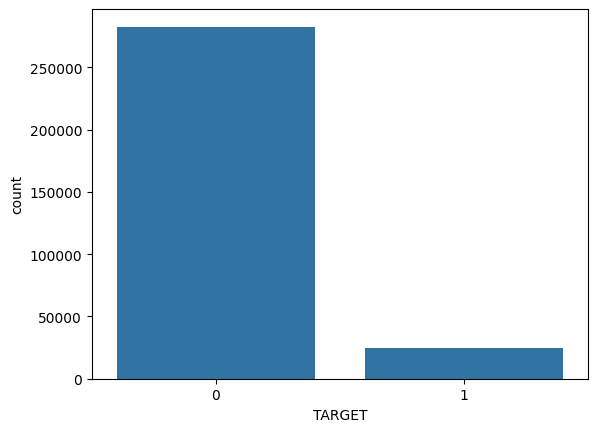

In [ ]:
fig, ax = plt.subplots()
sns.countplot(data=df, x='TARGET', ax=ax)
xticks = ax.xaxis.get_ticks_position()
ax.xaxis.set_ticks([0, 1])
plt.show()

On constate un déséquillibre certain dans le jeu de données. Il nous faudra le prendre en compte pour optimiser le modèle.

# <font color="yellow">Valeurs manquantes

In [ ]:
import missingno as msno
msno.bar(df)

<Axes: >

Il y a beaucoup de valeurs manquantes et nous ne pouvons pas toutes les imputer. L'algorithme LGBM prend en compte les valeurs NaN. Je vais voir, à la suite, quelle stratégie adopter pour la suppression de certaines variables.

In [ ]:
# Calculer le nombre de valeurs manquantes pour chaque colonne
missing_values = df.isnull().sum()

# Calculer le ratio de valeurs manquantes pour chaque colonne
total_rows = len(df)
missing_ratios = missing_values / total_rows

# Filtrer les colonnes avec un ratio de valeurs manquantes supérieur à 13%
high_missing_cols = missing_ratios[missing_ratios > 0.13]

# Imprimer les colonnes concernées
print("Variables avec plus de 13% de valeurs manquantes :")
print(high_missing_cols.index.tolist())

Variables avec plus de 13% de valeurs manquantes :
['DAYS_EMPLOYED', 'OWN_CAR_AGE', 'EXT_SOURCE_1', 'EXT_SOURCE_3', 'APARTMENTS_AVG', 'BASEMENTAREA_AVG', 'YEARS_BEGINEXPLUATATION_AVG', 'YEARS_BUILD_AVG', 'COMMONAREA_AVG', 'ELEVATORS_AVG', 'ENTRANCES_AVG', 'FLOORSMAX_AVG', 'FLOORSMIN_AVG', 'LANDAREA_AVG', 'LIVINGAPARTMENTS_AVG', 'LIVINGAREA_AVG', 'NONLIVINGAPARTMENTS_AVG', 'NONLIVINGAREA_AVG', 'APARTMENTS_MODE', 'BASEMENTAREA_MODE', 'YEARS_BEGINEXPLUATATION_MODE', 'YEARS_BUILD_MODE', 'COMMONAREA_MODE', 'ELEVATORS_MODE', 'ENTRANCES_MODE', 'FLOORSMAX_MODE', 'FLOORSMIN_MODE', 'LANDAREA_MODE', 'LIVINGAPARTMENTS_MODE', 'LIVINGAREA_MODE', 'NONLIVINGAPARTMENTS_MODE', 'NONLIVINGAREA_MODE', 'APARTMENTS_MEDI', 'BASEMENTAREA_MEDI', 'YEARS_BEGINEXPLUATATION_MEDI', 'YEARS_BUILD_MEDI', 'COMMONAREA_MEDI', 'ELEVATORS_MEDI', 'ENTRANCES_MEDI', 'FLOORSMAX_MEDI', 'FLOORSMIN_MEDI', 'LANDAREA_MEDI', 'LIVINGAPARTMENTS_MEDI', 'LIVINGAREA_MEDI', 'NONLIVINGAPARTMENTS_MEDI', 'NONLIVINGAREA_MEDI', 'TOTALAREA_MODE'

# <font color="yellow">Corrélation avec la cible

Je cherche à identifier quelles sont les variables les plus corrélées avec la cible "TARGET".
Pour éviter de saturer la RAM je le fais sur un échantillon de lignes pris aléatoirement.

In [ ]:
sample_df = df.sample(frac=0.50)
corr = sample_df.drop('SK_ID_CURR', axis=1).corr().abs()
corr['TARGET'].sort_values(ascending=False).head(50)

,TARGET
TARGET,1.000000
EXT_SOURCE_3,0.179166
EXT_SOURCE_2,0.156827
EXT_SOURCE_1,0.155026
BURO_DAYS_CREDIT_MEAN,0.089578
CC_AMT_BALANCE_MEAN,0.080701
CC_AMT_TOTAL_RECEIVABLE_MEAN,0.080180
CC_AMT_RECIVABLE_MEAN,0.080178
BURO_MONTHS_BALANCE_SIZE_MEAN,0.080083
PREV_NAME_CONTRACT_STATUS_Refused_MEAN,0.079930


Je regarde ensuite les variables non corélées avec la cible.

In [ ]:
min_corr = corr['TARGET'].sort_values(ascending=True).head(50)
min_corr

,TARGET
PREV_NAME_CASH_LOAN_PURPOSE_Money for a third person_MEAN,0.000012
POS_NAME_CONTRACT_STATUS_Completed_MEAN,0.000042
PREV_NAME_CASH_LOAN_PURPOSE_Buying a new car_MEAN,0.000061
ACTIVE_AMT_CREDIT_SUM_DEBT_SUM,0.000072
ORGANIZATION_TYPE_Industry: type 8,0.000133
ORGANIZATION_TYPE_Realtor,0.000169
BURO_STATUS_X_MEAN_MEAN,0.000193
BURO_CREDIT_TYPE_Another type of loan_MEAN,0.000196
CLOSED_CREDIT_DAY_OVERDUE_MAX,0.000220
CC_SK_DPD_MAX,0.000232


Cette analyse est très rapide car je vais ensuite utiliser l'algorithme de prédiction lui-même pour sélectionner les caractéristiques les plus importantes sachant que j'ai un jeu de données de grande dimension et qu'il est composé de différents types de variables (booléennes, numériques, catégorielles).

# <font color="yellow">Réduction dimensionnalité : 1er filtrage avant entraînement du modèle pour sélection des features les plus importantes

Le principe de ce premier filtrage est de supprimer les colonnes qui sont trop fortement corrélées entre elles.

***Avantages :***

Réduction de la redondance : Les colonnes très fortement corrélées apportent essentiellement la même information. En les supprimant, vous réduisez la redondance dans vos données, ce qui peut améliorer les performances du modèle et accélérer les calculs.

Gestion de la multicolinéarité : La présence de variables fortement corrélées peut poser des problèmes de multicolinéarité, ce qui peut rendre les estimations des coefficients instables et difficiles à interpréter. En supprimant ces variables, vous atténuez ce problème.

Réduction de la dimensionnalité initiale : Avec 783 colonnes, réduire la dimensionnalité dès le départ peut rendre les calculs ultérieurs plus rapides et plus stables.

***Considérations :***

Seuil de corrélation : définir un seuil de corrélation au-delà duquel vous considérerez que deux colonnes sont trop fortement corrélées. Un seuil courant est 0,8 ou 0,9 en valeur absolue,




In [ ]:
# on réorganise les colonnes de la moins corrélée à la plus corrélée avec la cible
sorted_idx = corr['TARGET'].sort_values().index
sorted_corr = corr.loc[sorted_idx, sorted_idx]

# triangle supérieur des corrélations
upper = sorted_corr.where(np.triu(np.ones(sorted_corr.shape), k=1).astype(np.bool_))

# define threshold
threshold = .8

# Select columns with correlations above threshold
to_drop = [column for column in upper.columns if any(upper[column] > threshold)]

print('There are {} columns to remove.'.format(len(to_drop)))

There are 260 columns to remove.


Détail sur le code ci-dessus:

Il trie les colonnes du DataFrame corr (qui contient les corrélations entre les variables) par ordre croissant de corrélation avec la variable cible 'TARGET'. Le résultat est stocké dans sorted_idx.

Il réorganise les lignes et les colonnes du DataFrame corr en fonction de l'ordre trié sorted_idx, créant ainsi un nouveau DataFrame sorted_corr.

Il crée une nouvelle matrice upper qui contient uniquement la partie supérieure du triangle de la matrice de corrélation sorted_corr (les éléments au-dessus de la diagonale principale).

Il définit un seuil de corrélation threshold à 0,8.

Il parcourt les colonnes de upper et crée une liste to_drop contenant les noms des colonnes qui ont au moins une corrélation supérieure au seuil threshold avec une autre colonne.

Enfin, il affiche le nombre de colonnes à supprimer (len(to_drop)).

In [ ]:
#Suppression des colonnes identifiées
cleaned_df_1 = df.drop(columns=to_drop)
cleaned_df_1.replace([])

,SK_ID_CURR,TARGET,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,REGION_POPULATION_RELATIVE,DAYS_BIRTH,...,CC_NAME_CONTRACT_STATUS_Sent proposal_SUM,CC_NAME_CONTRACT_STATUS_Signed_MIN,CC_NAME_CONTRACT_STATUS_Signed_MAX,CC_NAME_CONTRACT_STATUS_Signed_SUM,CC_NAME_CONTRACT_STATUS_Signed_VAR,CC_NAME_CONTRACT_STATUS_nan_MIN,CC_NAME_CONTRACT_STATUS_nan_MAX,CC_NAME_CONTRACT_STATUS_nan_MEAN,CC_NAME_CONTRACT_STATUS_nan_SUM,CC_NAME_CONTRACT_STATUS_nan_VAR
0,100002,1,0,0,0,202500.0,406597.5,24700.5,0.018801,-9461,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,100003,0,1,0,1,270000.0,1293502.5,35698.5,0.003541,-16765,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,100004,0,0,1,0,67500.0,135000.0,6750.0,0.010032,-19046,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,100006,0,1,0,0,135000.0,312682.5,29686.5,0.008019,-19005,...,0.0,False,False,0.0,0.0,False,False,0.0,0.0,0.0
4,100007,0,0,0,0,121500.0,513000.0,21865.5,0.028663,-19932,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307506,456251,0,0,0,1,157500.0,254700.0,27558.0,0.032561,-9327,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
307507,456252,0,1,0,0,72000.0,269550.0,12001.5,0.025164,-20775,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
307508,456253,0,1,0,0,153000.0,677664.0,29979.0,0.005002,-14966,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
307509,456254,1,1,0,0,171000.0,370107.0,20205.0,0.005313,-11961,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
print(''.join(cleaned_df_1.columns))

Je dois enregistrer le fichier joint et cleané afin de limiter la RAM.

In [ ]:
cleaned_df_1.to_csv('/content/drive/MyDrive/P7/cleaned_df_1.csv', index=False)

# <font color="yellow">Entraînement d'un modèle de régression logistique (demande du référentiel d'évaluation)

Un modèle de régression logistique ne pourra pas gérer les valeurs manquantes (ValueError: Input X contains NaN), je vais les supprimer sans procéder à une imputation quelconque.

In [ ]:
from sklearn.linear_model import LogisticRegression

In [ ]:
cleaned_df_1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307507 entries, 0 to 307506
Columns: 521 entries, SK_ID_CURR to CC_NAME_CONTRACT_STATUS_nan_VAR
dtypes: bool(128), float64(344), int64(39), object(10)
memory usage: 959.6+ MB


In [ ]:
cleaned_df_1_LR = cleaned_df_1.dropna()
cleaned_df_1_LR.info()

<class 'pandas.core.frame.DataFrame'>
Index: 42 entries, 6789 to 300062
Columns: 521 entries, SK_ID_CURR to CC_NAME_CONTRACT_STATUS_nan_VAR
dtypes: bool(128), float64(344), int64(39), object(10)
memory usage: 134.5+ KB


Trop restrictif, imputons par 0 lorsque c'est possible

In [ ]:
cleaned_df_1_LR_0 = cleaned_df_1.fillna(0)
cleaned_df_1_LR_0.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307507 entries, 0 to 307506
Columns: 521 entries, SK_ID_CURR to CC_NAME_CONTRACT_STATUS_nan_VAR
dtypes: bool(128), float64(344), int64(39), object(10)
memory usage: 959.6+ MB


In [ ]:
# Fonction pour écrêter les valeurs extrêmes (seulement pour les colonnes numériques)
def clip_values(x):
    if pd.api.types.is_numeric_dtype(x) and not pd.api.types.is_bool_dtype(x):
        q1, q3 = x.quantile([0.25, 0.75])
        iqr = q3 - q1
        lower_bound = q1 - (1.5 * iqr)
        upper_bound = q3 + (1.5 * iqr)
        return x.clip(lower_bound, upper_bound)
    else:
        return x

# Préparation des données (utilisation de seulement 50% des données)
cleaned_df_1_LR_0_sample = cleaned_df_1_LR_0.sample(frac=0.5, random_state=42)

X = cleaned_df_1_LR_0_sample.drop('TARGET', axis=1)
y = cleaned_df_1_LR_0_sample['TARGET']

# Vérification et traitement des valeurs infinies ou extrêmes
print("Colonnes avec des valeurs infinies :")
print(X.isin([np.inf, -np.inf]).any())

# Remplacement des valeurs infinies par NaN (seulement pour les colonnes numériques)
X = X.apply(lambda x: x.replace([np.inf, -np.inf], np.nan) if pd.api.types.is_numeric_dtype(x) else x)

# Remplacement des NaN par la moyenne de la colonne (seulement pour les colonnes numériques)
X = X.apply(lambda x: x.fillna(x.mean()) if pd.api.types.is_numeric_dtype(x) else x)

# Écrêtage des valeurs extrêmes
X = X.apply(clip_values)

# Conversion des colonnes booléennes en int
X = X.apply(lambda x: x.astype(int) if pd.api.types.is_bool_dtype(x) else x)

# Normalisation des données
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Division en ensembles d'entraînement et de test
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42)

# Entraînement du modèle de régression logistique
regression_model = LogisticRegression()
regression_model.fit(X_train, y_train)

# Prédictions sur l'ensemble de test
y_pred_regression = regression_model.predict(X_test)

# Calcul des métriques
accuracy_regression = accuracy_score(y_test, y_pred_regression)
precision_regression = precision_score(y_test, y_pred_regression, zero_division=1)
recall_regression = recall_score(y_test, y_pred_regression, zero_division=1)
f1_regression = f1_score(y_test, y_pred_regression, zero_division=1)
auc_regression = roc_auc_score(y_test, regression_model.predict_proba(X_test)[:, 1])

# Affichage des résultats
print(f"Précision du modèle LogisticRegression : {accuracy_regression}")
print(f"Précision du modèle LogisticRegression : {precision_regression}")
print(f"Rappel du modèle LogisticRegression : {recall_regression}")
print(f"Score F1 du modèle LogisticRegression : {f1_regression}")
print(f"AUC-ROC du modèle LogisticRegression : {auc_regression}")

Colonnes avec des valeurs infinies :
SK_ID_CURR                          False
CODE_GENDER                         False
FLAG_OWN_CAR                        False
FLAG_OWN_REALTY                     False
AMT_INCOME_TOTAL                    False
                                    ...  
CC_NAME_CONTRACT_STATUS_nan_MIN     False
CC_NAME_CONTRACT_STATUS_nan_MAX     False
CC_NAME_CONTRACT_STATUS_nan_MEAN    False
CC_NAME_CONTRACT_STATUS_nan_SUM     False
CC_NAME_CONTRACT_STATUS_nan_VAR     False
Length: 520, dtype: bool
Précision du modèle LogisticRegression : 0.9193196969204254
Précision du modèle LogisticRegression : 0.5967741935483871
Rappel du modèle LogisticRegression : 0.014841556357801846
Score F1 du modèle LogisticRegression : 0.0289628180039139
AUC-ROC du modèle LogisticRegression : 0.7524690763410676


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


# <font color="yellow">Entraînement du modèle Light GBMC Classifieur

## <font color="orange">Préparation du jeu de données

In [ ]:
cleaned_df_1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307507 entries, 0 to 307506
Columns: 521 entries, SK_ID_CURR to CC_NAME_CONTRACT_STATUS_nan_VAR
dtypes: bool(128), float64(344), int64(39), object(10)
memory usage: 959.6+ MB


## <font color="orange">Optimisation sytème : point technique

Dans Google Colab, il est généralement recommandé d'utiliser le GPU T4 plutôt que le CPU pour l'entraînement de modèles de machine learning, et ce pour plusieurs raisons :

Accélération des calculs
Les GPU sont spécialement conçus pour effectuer des calculs parallèles de manière très efficace, ce qui les rend beaucoup plus rapides que les CPU pour l'entraînement de réseaux de neurones profonds et d'autres tâches de machine learning intensives.

Temps d'entraînement réduit
Grâce à la puissance de calcul supérieure du GPU T4, le temps d'entraînement des modèles est considérablement réduit par rapport à un CPU. Cela permet de gagner un temps précieux, surtout pour les gros modèles qui nécessitent de nombreuses époques d'entraînement.

Frameworks optimisés pour GPU
La plupart des frameworks populaires de machine learning comme TensorFlow, PyTorch, Keras, etc. sont hautement optimisés pour tirer parti des GPU Nvidia. Ils offrent des performances accrues et une meilleure utilisation des ressources GPU.

Ressources gratuites
Dans Google Colab, on peut accéder gratuitement à un GPU T4 pendant une certaine durée, ce qui est un avantage considérable par rapport à l'utilisation d'un CPU ou à l'achat d'une instance GPU sur le cloud.

## <font color="orange">Baseline(s)

**Modèle Dummy Classifier**

In [ ]:
# Diviser le dataset en ensembles d'entraînement et de test
X = cleaned_df_1.drop('TARGET', axis=1)
y = cleaned_df_1['TARGET']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
# Entraîner un modèle DummyClassifier (baseline)
dummy_model = DummyClassifier(strategy='most_frequent')
dummy_model.fit(X_train, y_train)

# Faire des prédictions sur l'ensemble de test
y_pred_dummy = dummy_model.predict(X_test)

# Calculer les métriques
accuracy_dummy = accuracy_score(y_test, y_pred_dummy)
precision_dummy = precision_score(y_test, y_pred_dummy, zero_division=1)
recall_dummy = recall_score(y_test, y_pred_dummy, zero_division=1)
f1_dummy = f1_score(y_test, y_pred_dummy, zero_division=1)
auc_dummy = roc_auc_score(y_test, y_pred_dummy)

print(f"Précision du modèle DummyClassifier : {accuracy_dummy}")
print(f"Précision du modèle DummyClassifier : {precision_dummy}")
print(f"Rappel du modèle DummyClassifier : {recall_dummy}")
print(f"Score F1 du modèle DummyClassifier : {f1_dummy}")
print(f"AUC-ROC du modèle DummyClassifier : {auc_dummy}")

Précision du modèle DummyClassifier : 0.9183603785242757
Précision du modèle DummyClassifier : 1.0
Rappel du modèle DummyClassifier : 0.0
Score F1 du modèle DummyClassifier : 0.0
AUC-ROC du modèle DummyClassifier : 0.5


>Précision du modèle DummyClassifier : 0.9183603785242757

Cette précision élevée (environ 92%) est trompeuse car elle est due au fait que le modèle prédit toujours la classe majoritaire (0), qui représente 90% des données.

>Précision du modèle DummyClassifier : 1.0

Une précision de 1.0 pour la classe majoritaire (0) signifie que le modèle ne fait aucune erreur de prédiction pour cette classe. Cela est dû au fait qu'il prédit toujours la classe 0.

>Rappel du modèle DummyClassifier : 0.0

Un rappel de 0.0 pour la classe minoritaire (1) signifie que le modèle ne détecte aucun exemple de cette classe.

>Score F1 du modèle DummyClassifier : 0.0

Un score F1 de 0.0 pour la classe minoritaire (1) confirme que le modèle est complètement inefficace pour cette classe.

>AUC-ROC du modèle DummyClassifier : 0.5

Une valeur d'AUC-ROC de 0.5 indique que les performances du modèle sont équivalentes à un classifieur aléatoire.

Le modèle DummyClassifier est complètement inefficace pour prédire la classe **minoritaire (1) dans ce jeu de données déséquilibrées.** Il obtient une précision parfaite pour la classe majoritaire (0) simplement parce qu'il prédit toujours cette classe.

Cependant, pour la classe minoritaire (1), qui représente 10% des données, le modèle échoue complètement avec un rappel, un score F1 et une AUC-ROC très faibles.

Ce modèle de référence sert principalement à établir une baseline pour comparer les performances d'autres modèles plus sophistiqués. Tout modèle d'apprentissage supervisé capable de mieux prédire la classe minoritaire devrait obtenir de meilleures métriques que le DummyClassifier pour cette classe.

Pour traiter ce problème de déséquilibre de classes, il faut envisager d'autres techniques comme le rééchantillonnage des données, l'utilisation de métriques adaptées, l'attribution de poids de classe différents ou l'utilisation d'algorithmes d'apprentissage supervisé plus sophistiqués capables de gérer les données déséquilibrées.

**Modèle d'arbre de décision**

Ce modèle va tenter de gérer le déséquilibre des classes à l'aide de la fonction 'compute_class_weight'mais je vais devoir gérer les valeurs manquantes qui ne sont pas tolérées par ce modèle donc je choisi de ne pas l'utiliser.

**Modèle Light GBM Classifier**

Pour ce modèle je dois réduire la taille du jeu de données car la RAM disponible n'est pas suffisante. On se rappelle que le jeu est désiquilibré, je tente de le rééquilibrer.

In [ ]:
# Compter le nombre de "TARGET" 0 et 1 dans sample_10
target_counts = cleaned_df_1["TARGET"].value_counts()
print(target_counts)

nb_target_0 = target_counts[0]
nb_target_1 = target_counts[1]

print(f"Nombre de 'TARGET' 0 : {nb_target_0}")
print(f"Nombre de 'TARGET' 1 : {nb_target_1}")

TARGET
0    282682
1     24825
Name: count, dtype: int64
Nombre de 'TARGET' 0 : 282682
Nombre de 'TARGET' 1 : 24825


In [ ]:
# Séparer les données en deux sous-ensembles en fonction de la valeur de la colonne "TARGET"
df_0 = cleaned_df_1[cleaned_df_1["TARGET"] == 0]
df_1 = cleaned_df_1[cleaned_df_1["TARGET"] == 1]

# Prendre un échantillon de taille fixe pour la classe minoritaire
sample_size = len(df_1)  # Taille de la classe minoritaire
sample_1 = df_1.sample(n=sample_size, random_state=42)

# Prendre un échantillon de même taille pour la classe majoritaire
sample_0 = df_0.sample(n=sample_size, random_state=42)

# Concaténer les deux échantillons pour obtenir un échantillon équilibré
sample_10 = pd.concat([sample_0, sample_1], ignore_index=True)

In [ ]:
# Compter le nombre de "TARGET" 0 et 1 dans sample_10
target_counts = sample_10["TARGET"].value_counts()
print(target_counts)

nb_target_0 = target_counts[0]
nb_target_1 = target_counts[1]

print(f"Nombre de 'TARGET' 0 : {nb_target_0}")
print(f"Nombre de 'TARGET' 1 : {nb_target_1}")

TARGET
0    24825
1    24825
Name: count, dtype: int64
Nombre de 'TARGET' 0 : 24825
Nombre de 'TARGET' 1 : 24825


Je regarde l'équilibre de mon jeu de données

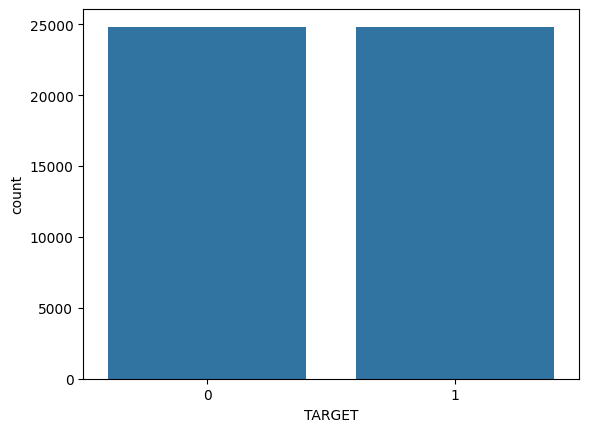

In [ ]:
fig, ax = plt.subplots()
sns.countplot(data=sample_10, x='TARGET', ax=ax)
xticks = ax.xaxis.get_ticks_position()
ax.xaxis.set_ticks([0, 1])
plt.show()

In [ ]:
sample_10.to_csv('/content/drive/MyDrive/P7/sample_10.csv', index=False)

In [ ]:
sample_10.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 49650 entries, 0 to 49649
Columns: 521 entries, SK_ID_CURR to CC_NAME_CONTRACT_STATUS_nan_VAR
dtypes: bool(128), float64(344), int64(39), object(10)
memory usage: 154.9+ MB


In [ ]:
# Diviser le dataset en ensembles d'entraînement et de test
X = sample_10.drop('TARGET', axis=1)
y = sample_10['TARGET']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

Je dois passer au format numpy car le modèle utilisé demande à modifier le nom des colonnes qui ne le lui convient pas.

In [ ]:
X_train_arr = X_train.drop('SK_ID_CURR', axis=1).to_numpy()
X_test_arr = X_test.drop('SK_ID_CURR',axis=1).to_numpy()

Avec is_unbalance=True on indique que les données sont déséquilibrées (une classe est beaucoup plus représentée que l'autre).

Ici les paramètres standards:

**num_leaves** : 31 (nombre maximum de feuilles dans les arbres)

**max_depth** : -1 (pas de limite de profondeur pour les arbres)

learning_rate : 0.1 (taux d'apprentissage)

n_estimators : 100 (nombre d'arbres dans le modèle)

subsample_for_bin : 200000 (nombre d'échantillons pour construire les histogrammes de gradients)

min_split_gain : 0 (gain minimum pour effectuer une division)

min_child_weight : 1e-3 (somme minimale des poids des instances requise dans un nœud enfant)

min_child_samples : 20 (nombre minimum d'échantillons dans un nœud enfant)

subsample : 1 (fraction des échantillons à utiliser pour chaque arbre)

subsample_freq : 0 (fréquence de l'échantillonnage)

colsample_bytree : 1 (fraction des caractéristiques à utiliser pour chaque arbre)

reg_alpha : 0 (régularisation L1)

reg_lambda : 0 (régularisation L2)

random_state : None (graine aléatoire pour la reproductibilité)

n_jobs : -1 (utiliser tous les cœurs de processeur disponibles)

In [ ]:
# Création du pipeline
lgb = LGBMClassifier(objective='binary', metric='AUC', is_unbalance=False)

# Entraînement du modèle
lgb.fit(X_train_arr, y_train)

# Prédictions
y_pred_proba = lgb.predict_proba(X_test_arr)[:, 1]

# Conversion des probabilités en prédictions binaires
y_pred = (y_pred_proba > 0.5).astype(int)

# Evaluation du modèle
accuracy_lgb = accuracy_score(y_test, y_pred)
precision_lgb = precision_score(y_test, y_pred)
recall_lgb = recall_score(y_test, y_pred)
f1_lgb = f1_score(y_test, y_pred)
auc_lgb = roc_auc_score(y_test, y_pred_proba)

print(f"Précision du modèle LightGBM : {accuracy_lgb:.3f}")
print(f"Précision du modèle LightGBM : {precision_lgb:.3f}")
print(f"Rappel du modèle LightGBM : {recall_lgb:.3f}")
print(f"Score F1 du modèle LightGBM : {f1_lgb:.3f}")
print(f"AUC-ROC du modèle LightGBM : {auc_lgb:.3f}")

[LightGBM] [Info] Number of positive: 19848, number of negative: 19872
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.150707 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 40746
[LightGBM] [Info] Number of data points in the train set: 39720, number of used features: 495
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.499698 -> initscore=-0.001208
[LightGBM] [Info] Start training from score -0.001208
Précision du modèle LightGBM : 0.714
Précision du modèle LightGBM : 0.718
Rappel du modèle LightGBM : 0.707
Score F1 du modèle LightGBM : 0.713
AUC-ROC du modèle LightGBM : 0.782


**Number of positive: 19848, number of negative: 19872**

Cela signifie que dans le jeu de données d'entraînement, il y a 19848 exemples où la variable cible (TARGET) est égale à 1 (classe positive), et 19872 exemples où la variable cible est égale à 0 (classe négative).

Auto-choosing row-wise multi-threading, the overhead of testing was 0.120920 seconds. **texte en gras**

LightGBM a automatiquement choisi d'utiliser le multi-threading par ligne (row-wise multi-threading) pour accélérer les calculs. Cela signifie que les données sont divisées en blocs de lignes, et chaque bloc est traité en parallèle sur un thread différent. Le temps de test pour choisir cette méthode était de 0,120920 secondes.

**Total Bins 40746**

LightGBM a créé 40746 bins (regroupements de valeurs) pour les différentes caractéristiques du jeu de données. Les bins sont utilisés pour discrétiser les valeurs continues des caractéristiques, ce qui peut améliorer les performances du modèle.

**Number of data points in the train set: 39720, number of used features: 495**

Le jeu de données d'entraînement contient 39720 exemples (lignes), et 495 caractéristiques (colonnes) ont été utilisées pour entraîner le modèle.


**[binary:BoostFromScore]: pavg=0.499698 -> initscore=-0.001208**

Cette ligne indique que la valeur initiale du score (initscore) pour l'entraînement du modèle est de -0.001208. Ce score est utilisé comme point de départ pour l'optimisation du modèle.

**Précision du modèle LightGBM : 0.714 et Précision du modèle LightGBM : 0.718**

La précision est la proportion de prédictions positives correctes parmi toutes les prédictions positives. Une précision de 0,714 et 0,718 signifie que, respectivement, 71,4% et 71,8% des exemples prédits comme positifs par le modèle étaient effectivement positifs.

**Rappel du modèle LightGBM : 0.707**

Le rappel est la proportion d'exemples positifs correctement identifiés parmi tous les exemples positifs. Un rappel de 0,707 signifie que le modèle a correctement identifié 70,7% des exemples positifs.

**Score F1 du modèle LightGBM : 0.713**

Le score F1 est une moyenne harmonique de la précision et du rappel. Il est compris entre 0 et 1, et une valeur plus élevée indique une meilleure performance du modèle. Un score F1 de 0,713 est considéré comme une bonne performance.

**AUC-ROC du modèle LightGBM : 0.782**

L'AUC-ROC (Area Under the Receiver Operating Characteristic Curve) est une métrique d'évaluation de la performance d'un modèle de classification binaire. Elle mesure la capacité du modèle à distinguer les exemples positifs des exemples négatifs. Une valeur de 0,782 indique que le modèle a une bonne capacité à séparer les deux classes, mais il y a encore de la marge pour l'améliorer.

Si on observe la métrique AUC-ROC, on peut constater une nette amélioration comparé au modèle de classification naive. Je vais tenter d'optimiser les paramètres. On se rappelle par ailleurs que nous pouvons également identifier les features les plus importantes et réduire le jeu de données.

## <font color="orange">Optimisation des hyperparamètres du modèle Light GBM Classifier

'max_depth': Contrôle la profondeur maximale des arbres de décision individuels. Des valeurs plus élevées permettent aux arbres d'être plus complexes et de mieux capturer les relations complexes dans les données, mais peuvent également entraîner un surapprentissage. Les valeurs testées sont 3, 5 et 7.

'num_leaves': Détermine le nombre maximal de feuilles terminales dans les arbres de décision. Des valeurs plus élevées augmentent la complexité du modèle et sa capacité à capturer des relations complexes, mais peuvent également entraîner un surapprentissage. Les valeurs testées sont 31, 63 et 127.

'learning_rate': Contrôle le taux d'apprentissage, qui détermine la contribution de chaque arbre de décision au modèle final. Des valeurs plus faibles ralentissent l'apprentissage mais peuvent permettre d'obtenir de meilleurs résultats. Les valeurs testées sont 0.01, 0.05 et 0.1.

'n_estimators': Détermine le nombre d'arbres de décision à construire. Des valeurs plus élevées augmentent la complexité du modèle et sa capacité à capturer des relations complexes, mais peuvent également entraîner un surapprentissage. Les valeurs testées sont 100, 200 et 300.

'min_child_samples': Définit le nombre minimum d'échantillons requis pour créer une feuille terminale dans un arbre de décision. Des valeurs plus élevées réduisent le risque de surapprentissage mais peuvent également empêcher le modèle de capturer des relations complexes. Les valeurs testées sont 5, 10 et 20.

'subsample': Contrôle la fraction d'échantillons à utiliser pour chaque arbre de décision. Des valeurs inférieures à 1.0 introduisent un échantillonnage aléatoire, ce qui peut aider à réduire le surapprentissage. Les valeurs testées sont 0.6, 0.8 et 1.0 (pas d'échantillonnage).

'colsample_bytree': Détermine la fraction de caractéristiques à utiliser pour chaque arbre de décision. Des valeurs inférieures à 1.0 introduisent un échantillonnage aléatoire des caractéristiques, ce qui peut aider à réduire le surapprentissage. Les valeurs testées sont 0.6, 0.8 et 1.0 (pas d'échantillonnage).

'reg_alpha': Contrôle la régularisation L1 (norme L1) appliquée aux poids des feuilles terminales. Des valeurs plus élevées entraînent une régularisation plus forte et réduisent le risque de surapprentissage. Les valeurs testées sont 0.0 (pas de régularisation), 0.1 et 0.5.

'reg_lambda': Contrôle la régularisation L2 (norme L2) appliquée aux poids des feuilles terminales. Des valeurs plus élevées entraînent une régularisation plus forte et réduisent le risque de surapprentissage. Les valeurs testées sont 0.0 (pas de régularisation), 0.1 et 0.5.

'scale_pos_weight': Ajuste le poids des exemples positifs par rapport aux exemples négatifs dans le cas de données déséquilibrées. Des valeurs supérieures à 1 augmentent le poids des exemples positifs. Les valeurs testées sont 1 (pas d'ajustement), 2 et 3.

## <font color="orange">Choix des hyperparamètres du modèle LightGBM Classifier

**min_data_in_leaf** :
Ce paramètre contrôle le nombre minimum d'instances (données) requises dans une feuille (nœud terminal) de l'arbre de décision. Une valeur plus élevée de min_data_in_leaf empêche la construction d'arbres trop complexes et aide à éviter le surapprentissage. Cependant, une valeur trop élevée peut entraîner un sous-apprentissage.
>>>l'expression np.logspace(2, 4, 10, dtype='int') génère un vecteur de 10 valeurs entières pour min_data_in_leaf, allant de 100 à 10000 environ, avec un espacement logarithmique.

Utiliser un espacement logarithmique plutôt qu'un espacement linéaire permet d'explorer une plage de valeurs plus large, tout en donnant plus de poids aux petites valeurs.

Cette approche peut être utile pour la recherche d'hyperparamètres du paramètre min_data_in_leaf, car elle permet d'explorer à la fois de petites valeurs (100, 200, etc.) et de grandes valeurs (5000, 10000, etc.) dans la même recherche.



**feature_fraction** :
Ce paramètre détermine la fraction de caractéristiques (features) à utiliser pour chaque arbre de décision. À chaque étape de construction d'un arbre, LightGBM sélectionne aléatoirement un sous-ensemble de caractéristiques selon la valeur de feature_fraction. Cette technique, connue sous le nom de "feature subsampling", introduit de la randomisation dans le processus d'apprentissage et aide à réduire la variance du modèle.

Une valeur de feature_fraction inférieure à 1.0 peut améliorer les performances du modèle en réduisant le surapprentissage, en particulier lorsque le nombre de caractéristiques est élevé. Cependant, une valeur trop faible peut entraîner une perte d'informations importantes et dégrader les performances.


## <font color="green">Avec un jeu d'entraînement équilibré

Entraînement sur 100% d'un jeu équilibré (49 650 entrées) - Recherche des meilleurs paramètres (sur un domaine réduit > 3 paramètres) sur le train - Évaluation sur 20% du jeu désiquilibré (20% de 307 507 entrées)

In [ ]:
# Supprimer la colonne 'SK_ID_CURR' des datasets
X_train = sample_10.drop(['TARGET', 'SK_ID_CURR'], axis=1)
y_train = sample_10['TARGET']
X_test = cleaned_df_1.drop(['TARGET', 'SK_ID_CURR'], axis=1)
y_test = cleaned_df_1['TARGET']

# Diviser le dataset en ensembles d'entraînement et de test
X_test, X_unused, y_test, y_unused = train_test_split(X_test, y_test, test_size=0.2, random_state=42)

# Convertir les données en tableaux NumPy
X_train_arr = X_train.values
X_test_arr = X_test.values

# Définir les paramètres à tester
param_grid = {
    'max_depth': [3, 5, 7],
    'n_estimators': [100, 200, 300],
    'learning_rate': [0.01, 0.1, 0.3]
}

# Créer un objet LGBMClassifier pour l'entraînement
lgbm_model_train = LGBMClassifier(random_state=42, is_unbalance=False)

# Créer un objet GridSearchCV
grid_search = GridSearchCV(estimator=lgbm_model_train, param_grid=param_grid, cv=5, scoring='roc_auc', n_jobs=-1, verbose=1)

# Ajuster le GridSearchCV sur les données d'entraînement
grid_search.fit(X_train_arr, y_train)

# Entraîner le modèle avec les meilleurs paramètres
best_lgbm_model = grid_search.best_estimator_

# Prédictions sur l'ensemble d'entraînement
y_pred_train = best_lgbm_model.predict(X_train_arr)

# Évaluation du modèle sur l'ensemble d'entraînement
accuracy_train = accuracy_score(y_train, y_pred_train)
precision_train = precision_score(y_train, y_pred_train)
recall_train = recall_score(y_train, y_pred_train)
f1_train = f1_score(y_train, y_pred_train)
auc_train = roc_auc_score(y_train, best_lgbm_model.predict_proba(X_train_arr)[:, 1])

# Prédictions sur l'ensemble de test
y_pred_test = best_lgbm_model.predict(X_test_arr)

# Évaluation du modèle sur l'ensemble de test
accuracy_test = accuracy_score(y_test, y_pred_test)
precision_test = precision_score(y_test, y_pred_test)
recall_test = recall_score(y_test, y_pred_test)
f1_test = f1_score(y_test, y_pred_test)
auc_test = roc_auc_score(y_test, best_lgbm_model.predict_proba(X_test_arr)[:, 1])

# Création du graphique avec Plotly
trace1 = go.Bar(x=['Accuracy', 'Precision', 'Recall', 'F1-Score', 'AUC-ROC'],
                y=[accuracy_train, precision_train, recall_train, f1_train, auc_train],
                name='LightGBM (Train)', marker=dict(color='skyblue'))

trace2 = go.Bar(x=['Accuracy', 'Precision', 'Recall', 'F1-Score', 'AUC-ROC'],
                y=[accuracy_test, precision_test, recall_test, f1_test, auc_test],
                name='LightGBM (Test)', marker=dict(color='orange'))

data = [trace1, trace2]
layout = go.Layout(title='Performances du modèle LightGBM', xaxis=dict(title='Métrique'), yaxis=dict(title='Valeur'), barmode='group')

fig = go.Figure(data=data, layout=layout)
fig.show()

Fitting 5 folds for each of 27 candidates, totalling 135 fits


In [ ]:
# Supprimer la colonne 'SK_ID_CURR' des datasets
X_train = sample_10.drop(['TARGET', 'SK_ID_CURR'], axis=1)
y_train = sample_10['TARGET']
X_test = cleaned_df_1.drop(['TARGET', 'SK_ID_CURR'], axis=1)
y_test = cleaned_df_1['TARGET']

# Diviser le dataset en ensembles d'entraînement et de test
X_test, X_unused, y_test, y_unused = train_test_split(X_test, y_test, test_size=0.2, random_state=42)

# Convertir les données en tableaux NumPy
X_train_arr = X_train.values
X_test_arr = X_test.values

# Définir les paramètres à tester
param_grid = {
    'max_depth': [3, 5, 7],
    'n_estimators': [100, 200, 300],
    'learning_rate': [0.01, 0.1, 0.3]
}

# Créer un objet LGBMClassifier pour l'entraînement
lgbm_model_train = LGBMClassifier(random_state=42, is_unbalance=False)

# Créer un objet GridSearchCV
grid_search = GridSearchCV(estimator=lgbm_model_train, param_grid=param_grid, cv=5, scoring='roc_auc', n_jobs=-1, verbose=1)

# Ajuster le GridSearchCV sur les données d'entraînement
grid_search.fit(X_train_arr, y_train)

# Entraîner le modèle avec les meilleurs paramètres
best_lgbm_model = grid_search.best_estimator_

# Prédictions sur l'ensemble de test
y_pred_test = best_lgbm_model.predict(X_test_arr)

# Évaluation du modèle sur l'ensemble de test
accuracy_test = accuracy_score(y_test, y_pred_test)
precision_test = precision_score(y_test, y_pred_test)
recall_test = recall_score(y_test, y_pred_test)
f1_test = f1_score(y_test, y_pred_test)
auc_test = roc_auc_score(y_test, best_lgbm_model.predict_proba(X_test_arr)[:, 1])

# Création du graphique avec Plotly
trace1 = go.Bar(x=['Accuracy', 'Precision', 'Recall', 'F1-Score', 'AUC-ROC'],
                y=[accuracy_test, precision_test, recall_test, f1_test, auc_test],
                name='LightGBM (Test)', marker=dict(color='skyblue'))

data = [trace1]
layout = go.Layout(title='Performances du modèle LightGBM', xaxis=dict(title='Métrique'), yaxis=dict(title='Valeur'), barmode='group')

fig = go.Figure(data=data, layout=layout)
fig.show()

In [ ]:
print("Meilleurs paramètres :", grid_search.best_params_)

In [ ]:
print("\nMétriques sur l'ensemble de test :")
print("Accuracy :", accuracy_test)
print("Precision :", precision_test)
print("Recall :", recall_test)
print("F1-Score :", f1_test)
print("AUC-ROC :", auc_test)

Point de vigilance à observer sur un jeu de données désiquilibré :

En utilisant le rappel comme métrique d'évaluation pour GridSearchCV, on s'assure que les meilleurs paramètres sélectionnés maximisent les performances du modèle sur la classe minoritaire, ce qui est crucial dans un contexte de déséquilibre des classes.

## <font color="green">Avec un jeu d'entraînement déséquilibré

Entraînement sur 10% des 307 507 entrées (jeu déséquilibré - pris de façon aléatoire ) - Recherche des meilleurs paramètres (sur un domaine réduit > 3 paramètres) sur le train - Testé sur 20% des 307 507.

In [ ]:
# Diviser le dataset en ensembles d'entraînement et de test
X = cleaned_df_1.drop('TARGET', axis=1)
y = cleaned_df_1['TARGET']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Échantillonnage aléatoire de 10% des données pour réduire la consommation de mémoire RAM
X_train = X_train.sample(frac=0.10, random_state=42)
y_train = y_train[X_train.index]

# Suppression de la colonne 'SK_ID_CURR'
X_train_arr = X_train.drop('SK_ID_CURR', axis=1).to_numpy()
X_test_arr = X_test.drop('SK_ID_CURR', axis=1).to_numpy()

# Définir les paramètres à tester
param_grid = {
    'max_depth': [3, 5, 7],
    'n_estimators': [100, 200, 300],
    'learning_rate': [0.01, 0.1, 0.3]
}

# Créer un objet LGBMClassifier
lgbm_model = LGBMClassifier(random_state=42, is_unbalance=True)

# Créer un objet GridSearchCV
grid_search = GridSearchCV(estimator=lgbm_model, param_grid=param_grid, cv=5, scoring='roc_auc', n_jobs=-1, verbose=1)

# Ajuster le GridSearchCV sur les données d'entraînement
grid_search.fit(X_train_arr, y_train)

# Entraîner le modèle avec les meilleurs paramètres
best_lgbm_model = grid_search.best_estimator_

# Prédictions sur l'ensemble de test
y_pred_test = best_lgbm_model.predict(X_test_arr)

# Prédictions sur l'ensemble d'entraînement
y_pred_train = best_lgbm_model.predict(X_train_arr)

# Évaluation du modèle sur l'ensemble de test
accuracy_test = accuracy_score(y_test, y_pred_test)
precision_test = precision_score(y_test, y_pred_test)
recall_test = recall_score(y_test, y_pred_test)
f1_test = f1_score(y_test, y_pred_test)
auc_test = roc_auc_score(y_test, best_lgbm_model.predict_proba(X_test_arr)[:, 1])

# Évaluation du modèle sur l'ensemble d'entraînement
accuracy_train = accuracy_score(y_train, y_pred_train)
precision_train = precision_score(y_train, y_pred_train)
recall_train = recall_score(y_train, y_pred_train)
f1_train = f1_score(y_train, y_pred_train)
auc_train = roc_auc_score(y_train, best_lgbm_model.predict_proba(X_train_arr)[:, 1])

# Création du graphique avec Plotly
trace1 = go.Bar(x=['Accuracy', 'Precision', 'Recall', 'F1-Score', 'AUC-ROC'],
                y=[accuracy_test, precision_test, recall_test, f1_test, auc_test],
                name='LightGBM (Test)', marker=dict(color='skyblue'))
trace2 = go.Bar(x=['Accuracy', 'Precision', 'Recall', 'F1-Score', 'AUC-ROC'],
                y=[accuracy_train, precision_train, recall_train, f1_train, auc_train],
                name='LightGBM (Train)', marker=dict(color='lightblue'))

data = [trace1, trace2]
layout = go.Layout(title='Performances du modèle LightGBM', xaxis=dict(title='Métrique'), yaxis=dict(title='Valeur'), barmode='group')

fig = go.Figure(data=data, layout=layout)
fig.show()

print("Meilleurs paramètres :", grid_search.best_params_)

In [ ]:
# Diviser le dataset en ensembles d'entraînement et de test
X = cleaned_df_1.drop('TARGET', axis=1)
y = cleaned_df_1['TARGET']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Échantillonnage aléatoire de 10% des données pour réduire la consommation de mémoire RAM
X_train = X_train.sample(frac=0.10, random_state=42)
y_train = y_train[X_train.index]

# Suppression de la colonne 'SK_ID_CURR'
X_train_arr = X_train.drop('SK_ID_CURR', axis=1).to_numpy()
X_test_arr = X_test.drop('SK_ID_CURR', axis=1).to_numpy()

# Définir les paramètres à tester
param_grid = {
    'max_depth': [3, 5, 7],
    'n_estimators': [100, 200, 300],
    'learning_rate': [0.01, 0.1, 0.3]
}

# Créer un objet XGBClassifier
xgb_model = xgb.XGBClassifier(random_state=42)

# Créer un objet GridSearchCV
grid_search = GridSearchCV(estimator=xgb_model, param_grid=param_grid, cv=5, scoring='roc_auc', n_jobs=-1, verbose=1)

# Ajuster le GridSearchCV sur les données d'entraînement
grid_search.fit(X_train_arr, y_train)

# Entraîner le modèle avec les meilleurs paramètres
best_xgb_model = grid_search.best_estimator_

# Prédictions sur l'ensemble de test
y_pred_test = best_xgb_model.predict(X_test_arr)

# Prédictions sur l'ensemble d'entraînement
y_pred_train = best_xgb_model.predict(X_train_arr)

# Évaluation du modèle sur l'ensemble de test
accuracy_test = accuracy_score(y_test, y_pred_test)
precision_test = precision_score(y_test, y_pred_test)
recall_test = recall_score(y_test, y_pred_test)
f1_test = f1_score(y_test, y_pred_test)
auc_test = roc_auc_score(y_test, best_xgb_model.predict_proba(X_test_arr)[:, 1])

# Évaluation du modèle sur l'ensemble d'entraînement
accuracy_train = accuracy_score(y_train, y_pred_train)
precision_train = precision_score(y_train, y_pred_train)
recall_train = recall_score(y_train, y_pred_train)
f1_train = f1_score(y_train, y_pred_train)
auc_train = roc_auc_score(y_train, best_xgb_model.predict_proba(X_train_arr)[:, 1])

# Création du graphique avec Plotly
trace1 = go.Bar(x=['Accuracy', 'Precision', 'Recall', 'F1-Score', 'AUC-ROC'],
                y=[accuracy_test, precision_test, recall_test, f1_test, auc_test],
                name='XGBoost (Test)', marker=dict(color='skyblue'))
trace2 = go.Bar(x=['Accuracy', 'Precision', 'Recall', 'F1-Score', 'AUC-ROC'],
                y=[accuracy_train, precision_train, recall_train, f1_train, auc_train],
                name='XGBoost (Train)', marker=dict(color='lightblue'))

data = [trace1, trace2]
layout = go.Layout(title='Performances du modèle XGBoost', xaxis=dict(title='Métrique'), yaxis=dict(title='Valeur'), barmode='group')

fig = go.Figure(data=data, layout=layout)
fig.show()

Fitting 5 folds for each of 27 candidates, totalling 135 fits


# <font color="orange">Choix des hyperparamètres du modèle XGBoost Classifier

In [ ]:
print(best_xgb_model)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.1, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=3, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=200, n_jobs=None,
              num_parallel_tree=None, random_state=42, ...)


Voici les performances du modèle XGBoost si on entraîne et qu on teste sur 50 % des données déséquilibrées (50% de 307507 lignes)

In [ ]:
# Diviser le dataset en ensembles d'entraînement et de test
X = cleaned_df_1.drop('TARGET', axis=1)
y = cleaned_df_1['TARGET']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Échantillonnage aléatoire de 50% des données pour réduire la consommation de mémoire RAM
X_train = X_train.sample(frac=0.5, random_state=42)
y_train = y_train[X_train.index]

# Suppression de la colonne 'SK_ID_CURR'
X_train_arr = X_train.drop('SK_ID_CURR', axis=1).to_numpy()
X_test_arr = X_test.drop('SK_ID_CURR', axis=1).to_numpy()

# Définition des paramètres XGBoost
xgb_params = {
    'max_depth': 3,
    'n_estimators': 200,
    'learning_rate': 0.1
}

# Création du modèle XGBoost
xgb_model = xgb.XGBClassifier(**xgb_params)

# Entraînement du modèle XGBoost avec les données d'entraînement sous forme de numpy.array
xgb_model.fit(X_train_arr, y_train)

# Prédictions sur l'ensemble de test
y_pred_test_xgb = xgb_model.predict(X_test_arr)

# Prédictions sur l'ensemble d'entraînement
y_pred_train_xgb = xgb_model.predict(X_train_arr)

# Évaluation du modèle sur l'ensemble de test
accuracy_test_xgb = accuracy_score(y_test, y_pred_test_xgb)
precision_test_xgb = precision_score(y_test, y_pred_test_xgb)
recall_test_xgb = recall_score(y_test, y_pred_test_xgb)
f1_test_xgb = f1_score(y_test, y_pred_test_xgb)
auc_test_xgb = roc_auc_score(y_test, xgb_model.predict_proba(X_test_arr)[:, 1])

# Évaluation du modèle sur l'ensemble d'entraînement
accuracy_train_xgb = accuracy_score(y_train, y_pred_train_xgb)
precision_train_xgb = precision_score(y_train, y_pred_train_xgb)
recall_train_xgb = recall_score(y_train, y_pred_train_xgb)
f1_train_xgb = f1_score(y_train, y_pred_train_xgb)
auc_train_xgb = roc_auc_score(y_train, xgb_model.predict_proba(X_train_arr)[:, 1])

# Création du graphique avec Plotly
trace1 = go.Bar(x=['Accuracy', 'Precision', 'Recall', 'F1-Score', 'AUC-ROC'],
                y=[accuracy_test_xgb, precision_test_xgb, recall_test_xgb, f1_test_xgb, auc_test_xgb],
                name='XGBoost (Test)', marker=dict(color='skyblue'))
trace2 = go.Bar(x=['Accuracy', 'Precision', 'Recall', 'F1-Score', 'AUC-ROC'],
                y=[accuracy_train_xgb, precision_train_xgb, recall_train_xgb, f1_train_xgb, auc_train_xgb],
                name='XGBoost (Train)', marker=dict(color='lightblue'))

data = [trace1, trace2]
layout = go.Layout(title='Performances du modèle XGBoost', xaxis=dict(title='Métrique'), yaxis=dict(title='Valeur'), barmode='group')

fig = go.Figure(data=data, layout=layout)
fig.show()

Voici ces performances si on l'entraîne sur un jeu équilibré et qu'on le test sur l'intégralité du jeu déséquilibré.

In [ ]:
# Séparation des données en ensembles d'entraînement et de test
X_train = sample_10.drop('TARGET', axis=1)  # Caractéristiques
y_train = sample_10['TARGET']  # Variable cible

X_test = cleaned_df_1.drop('TARGET', axis=1)  # Caractéristiques de clean_df_1
y_test = cleaned_df_1['TARGET']  # Variable cible de clean_df_1

# Suppression de la colonne 'SK_ID_CURR'
X_train_arr = X_train.drop('SK_ID_CURR', axis=1).to_numpy()
X_test_arr = X_test.drop('SK_ID_CURR', axis=1).to_numpy()

# Sous-ensemble des données pour la recherche d'hyperparamètres
X_train_sub, _, y_train_sub, _ = train_test_split(X_train_arr, y_train, test_size=0.8, random_state=42)

# Espace de recherche réduit
param_grid = {
    'max_depth': [3],
    'n_estimators': [200],
    'learning_rate': [0.1]
}

# Création du modèle XGBoost
xgb = XGBClassifier(objective='binary:logistic', eval_metric='auc')

# Recherche d'hyperparamètres avec GridSearchCV
grid_search = GridSearchCV(xgb, param_grid=param_grid, cv=3, scoring='roc_auc', n_jobs=-1)
grid_search.fit(X_train_sub, y_train_sub)

# Meilleurs hyperparamètres
best_params = grid_search.best_params_

# Entraînement du modèle avec les meilleurs hyperparamètres sur l'ensemble complet
xgb_best = XGBClassifier(**best_params, objective='binary:logistic', eval_metric='auc')
xgb_best.fit(X_train_arr, y_train)

# Prédictions sur l'ensemble d'entraînement
y_pred_train_xgb = xgb_best.predict(X_train_arr)

# Prédictions sur l'ensemble de test
y_pred_test_xgb = xgb_best.predict(X_test_arr)

# Évaluation des modèles sur l'ensemble d'entraînement
accuracy_train_xgb = accuracy_score(y_train, y_pred_train_xgb)
precision_train_xgb = precision_score(y_train, y_pred_train_xgb)
recall_train_xgb = recall_score(y_train, y_pred_train_xgb)
f1_train_xgb = f1_score(y_train, y_pred_train_xgb)
auc_train_xgb = roc_auc_score(y_train, xgb_best.predict_proba(X_train_arr)[:, 1])

# Évaluation des modèles sur l'ensemble de test
accuracy_test_xgb = accuracy_score(y_test, y_pred_test_xgb)
precision_test_xgb = precision_score(y_test, y_pred_test_xgb)
recall_test_xgb = recall_score(y_test, y_pred_test_xgb)
f1_test_xgb = f1_score(y_test, y_pred_test_xgb)
auc_test_xgb = roc_auc_score(y_test, xgb_best.predict_proba(X_test_arr)[:, 1])

# Création du graphique avec Plotly
trace1 = go.Bar(x=['Accuracy', 'Precision', 'Recall', 'F1-Score', 'AUC-ROC'],
                y=[accuracy_train_xgb, precision_train_xgb, recall_train_xgb, f1_train_xgb, auc_train_xgb],
                name='XGBoost (Train)', marker=dict(color='lightskyblue'))
trace2 = go.Bar(x=['Accuracy', 'Precision', 'Recall', 'F1-Score', 'AUC-ROC'],
                y=[accuracy_test_xgb, precision_test_xgb, recall_test_xgb, f1_test_xgb, auc_test_xgb],
                name='XGBoost (Test)', marker=dict(color='skyblue'))

data = [trace1, trace2]
layout = go.Layout(title='Performances du modèle XGBoost', xaxis=dict(title='Métrique'), yaxis=dict(title='Valeur'), barmode='group')

fig = go.Figure(data=data, layout=layout)
fig.show()


In [ ]:
# Impression des résultats
print("Résultats sur l'ensemble d'entraînement :")
print(f"Accuracy : {accuracy_train_xgb:.2f}")
print(f"Précision : {precision_train_xgb:.2f}")
print(f"Rappel : {recall_train_xgb:.2f}")
print(f"Score F1 : {f1_train_xgb:.2f}")
print(f"AUC-ROC : {auc_train_xgb:.2f}")

print("\nRésultats sur l'ensemble de test :")
print(f"Accuracy : {accuracy_test_xgb:.2f}")
print(f"Précision : {precision_test_xgb:.2f}")
print(f"Rappel : {recall_test_xgb:.2f}")
print(f"Score F1 : {f1_test_xgb:.2f}")
print(f"AUC-ROC : {auc_test_xgb:.2f}")


Résultats sur l'ensemble d'entraînement :
Accuracy : 0.73
Précision : 0.73
Rappel : 0.73
Score F1 : 0.73
AUC-ROC : 0.80

Résultats sur l'ensemble de test :
Accuracy : 0.71
Précision : 0.18
Rappel : 0.73
Score F1 : 0.29
AUC-ROC : 0.79


Ces résultats indiquent que le modèle XGBoost présente des performances différentes sur les ensembles d'entraînement et de test. Voici une explication détaillée de chaque métrique :

Ensemble d'entraînement :

Accuracy : 0.73 (73% des instances sont correctement classées)
Précision : 0.73 (73% des instances classées comme positives sont réellement positives)
Rappel : 0.73 (73% des instances positives réelles sont correctement classées comme positives)
Score F1 : 0.73 (moyenne harmonique de la précision et du rappel)
AUC-ROC : 0.80 (Aire sous la courbe ROC, mesure de la capacité du modèle à distinguer les classes)
Sur l'ensemble d'entraînement, le modèle semble équilibré avec des valeurs similaires pour l'accuracy, la précision, le rappel et le score F1. L'AUC-ROC de 0.80 indique une bonne capacité de discrimination.

Ensemble de test :

Accuracy : 0.71 (71% des instances sont correctement classées)

Précision : 0.18 (Seulement 18% des instances classées comme positives sont réellement positives, ce qui est très faible)

Rappel : 0.73 (73% des instances positives réelles sont correctement classées comme positives)

Score F1 : 0.29 (Faible en raison de la faible précision)

AUC-ROC : 0.79 (Similaire à l'ensemble d'entraînement, indiquant une bonne capacité de discrimination)

Sur l'ensemble de test, on observe une précision très faible de 0.18, ce qui signifie que le modèle a tendance à prédire beaucoup de faux positifs. Cependant, le rappel reste élevé à 0.73, ce qui indique que le modèle capture bien les instances positives réelles. Le score F1 est faible en raison de la faible précision. L'AUC-ROC reste élevée, ce qui suggère que le modèle a encore une bonne capacité de discrimination, mais avec un seuil de décision inapproprié.

Cette divergence entre les performances sur les ensembles d'entraînement et de test peut indiquer un sur-apprentissage du modèle sur les données d'entraînement. Le modèle semble avoir du mal à généraliser correctement sur de nouvelles données (ensemble de test).

Je vais regarder si en ajustant le seuil de décision je parviens à améliorer les performances de précision du test.

In [ ]:
# Séparation des données en ensembles d'entraînement et de test
X_train = sample_10.drop('TARGET', axis=1)  # Caractéristiques
y_train = sample_10['TARGET']  # Variable cible

X_test = cleaned_df_1.drop('TARGET', axis=1)  # Caractéristiques de clean_df_1
y_test = cleaned_df_1['TARGET']  # Variable cible de clean_df_1

# Suppression de la colonne 'SK_ID_CURR'
X_train_arr = X_train.drop('SK_ID_CURR', axis=1).to_numpy()
X_test_arr = X_test.drop('SK_ID_CURR', axis=1).to_numpy()

# Sous-ensemble des données pour la recherche d'hyperparamètres
X_train_sub, _, y_train_sub, _ = train_test_split(X_train_arr, y_train, test_size=0.8, random_state=42)

# Espace de recherche réduit
param_grid = {
    'max_depth': [3],
    'n_estimators': [200],
    'learning_rate': [0.1]
}

# Création du modèle XGBoost
xgb = XGBClassifier(objective='binary:logistic', eval_metric='auc')

# Recherche d'hyperparamètres avec GridSearchCV
grid_search = GridSearchCV(xgb, param_grid=param_grid, cv=3, scoring='roc_auc', n_jobs=-1)
grid_search.fit(X_train_sub, y_train_sub)

# Meilleurs hyperparamètres
best_params = grid_search.best_params_

# Entraînement du modèle avec les meilleurs hyperparamètres sur l'ensemble complet
xgb_best = XGBClassifier(**best_params, objective='binary:logistic', eval_metric='auc')
xgb_best.fit(X_train_arr, y_train)

# Calculer les probabilités de prédiction sur l'ensemble de test
y_pred_proba = xgb_best.predict_proba(X_test_arr)[:, 1]

# Calculer l'AUC-ROC sans seuil
fpr, tpr, thresholds = roc_curve(y_test, y_pred_proba)
roc_auc = auc(fpr, tpr)
print(f"AUC-ROC sans seuil : {roc_auc:.2f}")

# Calculer les prédictions binaires avec le seuil 0.45
y_pred_test_045 = np.where(y_pred_proba >= 0.45, 1, 0)

# Calculer l'AUC-ROC avec le seuil 0.45
fpr_045, tpr_045, _ = roc_curve(y_test, y_pred_test_045)
roc_auc_045 = auc(fpr_045, tpr_045)

# Calculer les métriques avec le seuil 0.45
accuracy_045 = accuracy_score(y_test, y_pred_test_045)
precision_045 = precision_score(y_test, y_pred_test_045)
recall_045 = recall_score(y_test, y_pred_test_045)
f1_045 = f1_score(y_test, y_pred_test_045)

print(f"AUC-ROC avec seuil 0.45 : {roc_auc_045:.2f}")
print(f"Accuracy avec seuil 0.45 : {accuracy_045:.2f}")
print(f"Précision avec seuil 0.45 : {precision_045:.2f}")
print(f"Rappel avec seuil 0.45 : {recall_045:.2f}")
print(f"Score F1 avec seuil 0.45 : {f1_045:.2f}")
print("-" * 30)

# Calculer les prédictions binaires avec le seuil 0.6
y_pred_test_06 = np.where(y_pred_proba >= 0.6, 1, 0)

# Calculer l'AUC-ROC avec le seuil 0.6
fpr_06, tpr_06, _ = roc_curve(y_test, y_pred_test_06)
roc_auc_06 = auc(fpr_06, tpr_06)

# Calculer les métriques avec le seuil 0.6
accuracy_06 = accuracy_score(y_test, y_pred_test_06)
precision_06 = precision_score(y_test, y_pred_test_06)
recall_06 = recall_score(y_test, y_pred_test_06)
f1_06 = f1_score(y_test, y_pred_test_06)

print(f"AUC-ROC avec seuil 0.6 : {roc_auc_06:.2f}")
print(f"Accuracy avec seuil 0.6 : {accuracy_06:.2f}")
print(f"Précision avec seuil 0.6 : {precision_06:.2f}")
print(f"Rappel avec seuil 0.6 : {recall_06:.2f}")
print(f"Score F1 avec seuil 0.6 : {f1_06:.2f}")
print("-" * 30)

# Calculer les prédictions binaires avec le seuil 0.9
y_pred_test_09 = np.where(y_pred_proba >= 0.9, 1, 0)

# Calculer l'AUC-ROC avec le seuil 0.9
fpr_09, tpr_09, _ = roc_curve(y_test, y_pred_test_09)
roc_auc_09 = auc(fpr_09, tpr_09)

# Calculer les métriques avec le seuil 0.9
accuracy_09 = accuracy_score(y_test, y_pred_test_09)
precision_09 = precision_score(y_test, y_pred_test_09)
recall_09 = recall_score(y_test, y_pred_test_09)
f1_09 = f1_score(y_test, y_pred_test_09)

print(f"AUC-ROC avec seuil 0.9 : {roc_auc_09:.2f}")
print(f"Accuracy avec seuil 0.9 : {accuracy_09:.2f}")
print(f"Précision avec seuil 0.9 : {precision_09:.2f}")
print(f"Rappel avec seuil 0.9 : {recall_09:.2f}")
print(f"Score F1 avec seuil 0.9 : {f1_09:.2f}")

AUC-ROC sans seuil : 0.79
AUC-ROC avec seuil 0.45 : 0.72
Accuracy avec seuil 0.45 : 0.65
Précision avec seuil 0.45 : 0.16
Rappel avec seuil 0.45 : 0.79
Score F1 avec seuil 0.45 : 0.27
------------------------------
AUC-ROC avec seuil 0.6 : 0.70
Accuracy avec seuil 0.6 : 0.81
Précision avec seuil 0.6 : 0.23
Rappel avec seuil 0.6 : 0.58
Score F1 avec seuil 0.6 : 0.33
------------------------------
AUC-ROC avec seuil 0.9 : 0.52
Accuracy avec seuil 0.9 : 0.92
Précision avec seuil 0.9 : 0.57
Rappel avec seuil 0.9 : 0.04
Score F1 avec seuil 0.9 : 0.07


En général, dans ce type de situation, on accorde plus d'importance à **minimiser les faux positifs** (accorder un prêt à un client non viable) qu'à maximiser le rappel (identifier tous les clients viables potentiels).

Avec des métriques de performances sensiblement identiques, je décide d'opter pour le modèle xgboost car il tourne plus rapidement.

## <font color="orange">Simplification du modèle :  sélection de features

Il existe plusieurs critères pour identifier les meilleures caractéristiques (features) d'un modèle. Voici quelques-uns des critères les plus couramment utilisés :

Importance des caractéristiques : De nombreux algorithmes d'apprentissage automatique, tels que les arbres de décision, les forêts aléatoires et XGBoost, fournissent une mesure de l'importance relative de chaque caractéristique dans le modèle. On peut utiliser cette mesure pour classer les caractéristiques par ordre d'importance et sélectionner les plus importantes.

Pour XGBoost, on peut utiliser la méthode **feature_importances_** pour obtenir l'importance des caractéristiques du modèle entraîné :

In [ ]:
importances = xgb_best.feature_importances_

In [ ]:
# Importance des caractéristiques avec XGBoost
xgb = XGBClassifier().fit(X_train_arr, y_train)
importances = xgb.feature_importances_
top_features_indices = np.argsort(importances)[::-1][:300]
top_features = X_train.drop('SK_ID_CURR', axis=1).columns[top_features_indices]

# Sous-ensemble des données pour la recherche d'hyperparamètres
X_train_sub, _, y_train_sub, _ = train_test_split(X_train_arr[:, top_features_indices], y_train, test_size=0.8, random_state=42)

# Espace de recherche réduit
param_grid = {
    'max_depth': [3],
    'n_estimators': [200],
    'learning_rate': [0.1]
}

# Création du modèle XGBoost
xgb = XGBClassifier(objective='binary:logistic', eval_metric='auc')

# Recherche d'hyperparamètres avec GridSearchCV
grid_search = GridSearchCV(xgb, param_grid=param_grid, cv=3, scoring='roc_auc', n_jobs=-1)
grid_search.fit(X_train_sub, y_train_sub)

# Meilleurs hyperparamètres
best_params = grid_search.best_params_

# Entraînement du modèle avec les meilleurs hyperparamètres sur l'ensemble complet
xgb_best = XGBClassifier(**best_params, objective='binary:logistic', eval_metric='auc')
xgb_best.fit(X_train_arr[:, top_features_indices], y_train)

# Prédictions sur l'ensemble d'entraînement
y_pred_train_xgb = xgb_best.predict(X_train_arr[:, top_features_indices])

# Prédictions sur l'ensemble de test
y_pred_test_xgb = xgb_best.predict(X_test_arr[:, top_features_indices])

# Évaluation des modèles sur l'ensemble d'entraînement
accuracy_train_xgb = accuracy_score(y_train, y_pred_train_xgb)
precision_train_xgb = precision_score(y_train, y_pred_train_xgb)
recall_train_xgb = recall_score(y_train, y_pred_train_xgb)
f1_train_xgb = f1_score(y_train, y_pred_train_xgb)
auc_train_xgb = roc_auc_score(y_train, xgb_best.predict_proba(X_train_arr[:, top_features_indices])[:, 1])

# Évaluation des modèles sur l'ensemble de test
accuracy_test_xgb = accuracy_score(y_test, y_pred_test_xgb)
precision_test_xgb = precision_score(y_test, y_pred_test_xgb)
recall_test_xgb = recall_score(y_test, y_pred_test_xgb)
f1_test_xgb = f1_score(y_test, y_pred_test_xgb)
auc_test_xgb = roc_auc_score(y_test, xgb_best.predict_proba(X_test_arr[:, top_features_indices])[:, 1])

# Création du graphique avec Plotly
trace1 = go.Bar(x=['Accuracy', 'Precision', 'Recall', 'F1-Score', 'AUC-ROC'],
                y=[accuracy_train_xgb, precision_train_xgb, recall_train_xgb, f1_train_xgb, auc_train_xgb],
                name='XGBoost (Train)', marker=dict(color='lightskyblue'))
trace2 = go.Bar(x=['Accuracy', 'Precision', 'Recall', 'F1-Score', 'AUC-ROC'],
                y=[accuracy_test_xgb, precision_test_xgb, recall_test_xgb, f1_test_xgb, auc_test_xgb],
                name='XGBoost (Test)', marker=dict(color='skyblue'))

data = [trace1, trace2]
layout = go.Layout(title='Performances du modèle XGBoost', xaxis=dict(title='Métrique'), yaxis=dict(title='Valeur'), barmode='group')

fig = go.Figure(data=data, layout=layout)
fig.show()

In [ ]:
# Importance des caractéristiques avec XGBoost
xgb = XGBClassifier().fit(X_train_arr, y_train)
importances = xgb.feature_importances_
top_features_indices = np.argsort(importances)[::-1][:300]
top_features = X_train.drop('SK_ID_CURR', axis=1).columns[top_features_indices]

# Sous-ensemble des données pour la recherche d'hyperparamètres
X_train_sub, _, y_train_sub, _ = train_test_split(X_train_arr[:, top_features_indices], y_train, test_size=0.8, random_state=42)

# Espace de recherche réduit
param_grid = {
    'max_depth': [3],
    'n_estimators': [200],
    'learning_rate': [0.1]
}

# Création du modèle XGBoost
xgb = XGBClassifier(objective='binary:logistic', eval_metric='auc')

# Recherche d'hyperparamètres avec GridSearchCV
grid_search = GridSearchCV(xgb, param_grid=param_grid, cv=3, scoring='roc_auc', n_jobs=-1)
grid_search.fit(X_train_sub, y_train_sub)

# Meilleurs hyperparamètres
best_params = grid_search.best_params_

# Entraînement du modèle avec les meilleurs hyperparamètres sur l'ensemble complet
xgb_best = XGBClassifier(**best_params, objective='binary:logistic', eval_metric='auc')
xgb_best.fit(X_train_arr[:, top_features_indices], y_train)

# Prédictions sur l'ensemble d'entraînement
y_pred_train_xgb_proba = xgb_best.predict_proba(X_train_arr[:, top_features_indices])[:, 1]
y_pred_train_xgb = (y_pred_train_xgb_proba >= 0.6).astype(int)

# Prédictions sur l'ensemble de test
y_pred_test_xgb_proba = xgb_best.predict_proba(X_test_arr[:, top_features_indices])[:, 1]
y_pred_test_xgb = (y_pred_test_xgb_proba >= 0.6).astype(int)

# Évaluation des modèles sur l'ensemble d'entraînement
accuracy_train_xgb = accuracy_score(y_train, y_pred_train_xgb)
precision_train_xgb = precision_score(y_train, y_pred_train_xgb)
recall_train_xgb = recall_score(y_train, y_pred_train_xgb)
f1_train_xgb = f1_score(y_train, y_pred_train_xgb)
auc_train_xgb = roc_auc_score(y_train, y_pred_train_xgb_proba)

# Évaluation des modèles sur l'ensemble de test
accuracy_test_xgb = accuracy_score(y_test, y_pred_test_xgb)
precision_test_xgb = precision_score(y_test, y_pred_test_xgb)
recall_test_xgb = recall_score(y_test, y_pred_test_xgb)
f1_test_xgb = f1_score(y_test, y_pred_test_xgb)
auc_test_xgb = roc_auc_score(y_test, y_pred_test_xgb_proba)

# Création du graphique avec Plotly
trace1 = go.Bar(x=['Accuracy', 'Precision', 'Recall', 'F1-Score', 'AUC-ROC'],
                y=[accuracy_train_xgb, precision_train_xgb, recall_train_xgb, f1_train_xgb, auc_train_xgb],
                name='XGBoost (Train)', marker=dict(color='lightskyblue'))
trace2 = go.Bar(x=['Accuracy', 'Precision', 'Recall', 'F1-Score', 'AUC-ROC'],
                y=[accuracy_test_xgb, precision_test_xgb, recall_test_xgb, f1_test_xgb, auc_test_xgb],
                name='XGBoost (Test)', marker=dict(color='skyblue'))

data = [trace1, trace2]
layout = go.Layout(title='Performances du modèle XGBoost', xaxis=dict(title='Métrique'), yaxis=dict(title='Valeur'), barmode='group')

fig = go.Figure(data=data, layout=layout)
fig.show()

On peut supprimer jusqu'à 221 features et obtenir une performance AUC-ROC supérieure en gardant un seuil à 0.6.

In [ ]:
# Importance des caractéristiques avec XGBoost
xgb = XGBClassifier().fit(X_train_arr, y_train)
importances = xgb.feature_importances_
top_features_indices = np.argsort(importances)[::-1][:300]
top_features = X_train.drop('SK_ID_CURR', axis=1).columns[top_features_indices]

# Sous-ensemble des données pour la recherche d'hyperparamètres
X_train_sub, _, y_train_sub, _ = train_test_split(X_train_arr[:, top_features_indices], y_train, test_size=0.8, random_state=42)

# Espace de recherche réduit
param_grid = {
    'max_depth': [3],
    'n_estimators': [200],
    'learning_rate': [0.1]
}

# Création du modèle XGBoost
xgb = XGBClassifier(objective='binary:logistic', eval_metric='auc')

# Recherche d'hyperparamètres avec GridSearchCV
grid_search = GridSearchCV(xgb, param_grid=param_grid, cv=3, scoring='roc_auc', n_jobs=-1)
grid_search.fit(X_train_sub, y_train_sub)

# Meilleurs hyperparamètres
best_params = grid_search.best_params_

# Entraînement du modèle avec les meilleurs hyperparamètres sur l'ensemble complet
xgb_best_300 = XGBClassifier(**best_params, objective='binary:logistic', eval_metric='auc')
xgb_best_300.fit(X_train_arr[:, top_features_indices], y_train)

xgb_best_all = XGBClassifier(**best_params, objective='binary:logistic', eval_metric='auc')
xgb_best_all.fit(X_train_arr, y_train)

# Prédictions sur l'ensemble d'entraînement
y_pred_train_xgb_proba_300 = xgb_best_300.predict_proba(X_train_arr[:, top_features_indices])[:, 1]
y_pred_train_xgb_300 = (y_pred_train_xgb_proba_300 >= 0.6).astype(int)

y_pred_train_xgb_proba_all = xgb_best_all.predict_proba(X_train_arr)[:, 1]
y_pred_train_xgb_all = (y_pred_train_xgb_proba_all >= 0.6).astype(int)

# Prédictions sur l'ensemble de test
y_pred_test_xgb_proba_300 = xgb_best_300.predict_proba(X_test_arr[:, top_features_indices])[:, 1]
y_pred_test_xgb_300 = (y_pred_test_xgb_proba_300 >= 0.6).astype(int)

y_pred_test_xgb_proba_all = xgb_best_all.predict_proba(X_test_arr)[:, 1]
y_pred_test_xgb_all = (y_pred_test_xgb_proba_all >= 0.6).astype(int)

# Évaluation des modèles sur l'ensemble d'entraînement
accuracy_train_xgb_300 = accuracy_score(y_train, y_pred_train_xgb_300)
precision_train_xgb_300 = precision_score(y_train, y_pred_train_xgb_300)
recall_train_xgb_300 = recall_score(y_train, y_pred_train_xgb_300)
f1_train_xgb_300 = f1_score(y_train, y_pred_train_xgb_300)
auc_train_xgb_300 = roc_auc_score(y_train, y_pred_train_xgb_proba_300)

accuracy_train_xgb_all = accuracy_score(y_train, y_pred_train_xgb_all)
precision_train_xgb_all = precision_score(y_train, y_pred_train_xgb_all)
recall_train_xgb_all = recall_score(y_train, y_pred_train_xgb_all)
f1_train_xgb_all = f1_score(y_train, y_pred_train_xgb_all)
auc_train_xgb_all = roc_auc_score(y_train, y_pred_train_xgb_proba_all)

# Évaluation des modèles sur l'ensemble de test
accuracy_test_xgb_300 = accuracy_score(y_test, y_pred_test_xgb_300)
precision_test_xgb_300 = precision_score(y_test, y_pred_test_xgb_300)
recall_test_xgb_300 = recall_score(y_test, y_pred_test_xgb_300)
f1_test_xgb_300 = f1_score(y_test, y_pred_test_xgb_300)
auc_test_xgb_300 = roc_auc_score(y_test, y_pred_test_xgb_proba_300)

accuracy_test_xgb_all = accuracy_score(y_test, y_pred_test_xgb_all)
precision_test_xgb_all = precision_score(y_test, y_pred_test_xgb_all)
recall_test_xgb_all = recall_score(y_test, y_pred_test_xgb_all)
f1_test_xgb_all = f1_score(y_test, y_pred_test_xgb_all)
auc_test_xgb_all = roc_auc_score(y_test, y_pred_test_xgb_proba_all)

# Création du graphique avec Plotly
trace1 = go.Bar(x=['Accuracy', 'Precision', 'Recall', 'F1-Score', 'AUC-ROC'],
                y=[accuracy_train_xgb_300, precision_train_xgb_300, recall_train_xgb_300, f1_train_xgb_300, auc_train_xgb_300],
                name='XGBoost (Train, 300 features)', marker=dict(color='lightskyblue'))
trace2 = go.Bar(x=['Accuracy', 'Precision', 'Recall', 'F1-Score', 'AUC-ROC'],
                y=[accuracy_test_xgb_300, precision_test_xgb_300, recall_test_xgb_300, f1_test_xgb_300, auc_test_xgb_300],
                name='XGBoost (Test, 300 features)', marker=dict(color='skyblue'))
trace3 = go.Bar(x=['Accuracy', 'Precision', 'Recall', 'F1-Score', 'AUC-ROC'],
                y=[accuracy_train_xgb_all, precision_train_xgb_all, recall_train_xgb_all, f1_train_xgb_all, auc_train_xgb_all],
                name='XGBoost (Train, all features)', marker=dict(color='lightgreen'))
trace4 = go.Bar(x=['Accuracy', 'Precision', 'Recall', 'F1-Score', 'AUC-ROC'],
                y=[accuracy_test_xgb_all, precision_test_xgb_all, recall_test_xgb_all, f1_test_xgb_all, auc_test_xgb_all],
                name='XGBoost (Test, all features)', marker=dict(color='green'))

data = [trace1, trace2, trace3, trace4]
layout = go.Layout(title='Performances du modèle XGBoost', xaxis=dict(title='Métrique'), yaxis=dict(title='Valeur'), barmode='group')

fig = go.Figure(data=data, layout=layout)
fig.show()

In [ ]:
# Sélectionner les 300 features les plus importantes
top_features = X_train.drop('SK_ID_CURR', axis=1).columns[top_features_indices]

# Créer un nouveau DataFrame avec les 300 features
X_train_reduced = X_train[top_features]
X_test_reduced = X_test[top_features]

# Recréer un DataFrame complet avec les 300 features et la colonne cible
df_final_train = pd.concat([X_train_reduced, y_train], axis=1)
df_final_test = pd.concat([X_test_reduced, y_test], axis=1)

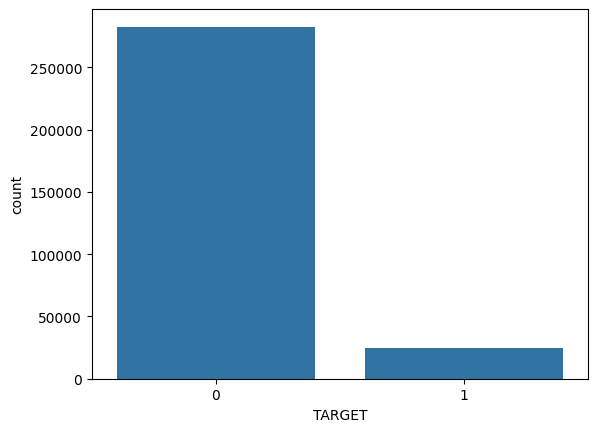

In [ ]:
fig, ax = plt.subplots()
sns.countplot(data=df_final_test, x='TARGET', ax=ax)
xticks = ax.xaxis.get_ticks_position()
ax.xaxis.set_ticks([0, 1])
plt.show()

In [ ]:
df_final_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 49650 entries, 0 to 49649
Columns: 301 entries, EXT_SOURCE_3 to TARGET
dtypes: bool(50), float64(235), int64(16)
memory usage: 97.4 MB


In [ ]:
df_final_test.drop('TARGET',axis=1,inplace=True)
df_final_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307507 entries, 0 to 307506
Columns: 300 entries, EXT_SOURCE_3 to CLOSED_MONTHS_BALANCE_MAX_MAX
dtypes: bool(50), float64(235), int64(15)
memory usage: 601.2 MB


In [ ]:
df_final_train.to_csv('/content/drive/MyDrive/P7/df_final_train.csv', index=False)

In [ ]:
df_final_test.to_csv('/content/drive/MyDrive/P7/df_final_test.csv', index=False)

## <font color="orange">Évaluation de la performance du modèle XGBoost final

Rappel : La matrice de confusion est un outil d'évaluation des performances utilisé en apprentissage automatique pour les problèmes de classification. C'est un tableau de contingence qui permet de visualiser les performances d'un modèle de classification en comparant les prédictions faites par le modèle avec les valeurs réelles connues.

Une matrice de confusion est généralement représentée sous forme d'un tableau à deux dimensions, où les lignes représentent les valeurs réelles (ou classes) et les colonnes représentent les prédictions faites par le modèle. Les éléments de la matrice indiquent le nombre d'instances classées dans chaque catégorie.   

### <font color="**green**">Modèle entrainé et testé sur des jeux équilibrés.

ATTENTION NE PAS FAIRE RETOURNER CETTE PARTIE DE CODE

Taux de vrais négatifs (spécificité) : 0.72
Taux de faux positifs : 0.28
Taux de vrais positifs (sensibilité) : 0.70
Taux de faux négatifs : 0.30
Précision : 0.71
Accuracy : 0.71


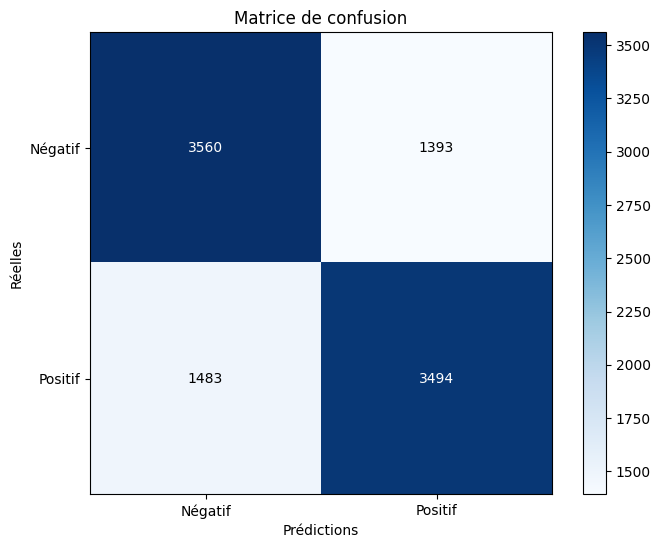

In [ ]:
# Calculer les prédictions sur l'ensemble de test
y_pred_test = xgb_best.predict(X_test_arr[:, top_features_indices])

# Calculer la matrice de confusion
cm = confusion_matrix(y_test, y_pred_test)

# Afficher la matrice de confusion
plt.figure(figsize=(8, 6))
plt.imshow(cm, cmap=plt.cm.Blues, interpolation='nearest')
plt.colorbar()
plt.title('Matrice de confusion')
plt.xlabel('Prédictions')
plt.ylabel('Réelles')
tick_marks = np.arange(2)
plt.xticks(tick_marks, ['Négatif', 'Positif'])
plt.yticks(tick_marks, ['Négatif', 'Positif'])

# Ajouter les valeurs dans les cases
thresh = cm.max() / 2.
for i in range(cm.shape[0]):
    for j in range(cm.shape[1]):
        plt.text(j, i, cm[i, j], ha="center", va="center", color="white" if cm[i, j] > thresh else "black")

# Interprétation de la matrice de confusion
tn, fp, fn, tp = cm.ravel()
total = tn + fp + fn + tp

print(f"Taux de vrais négatifs (spécificité) : {tn / (tn + fp):.2f}")
print(f"Taux de faux positifs : {fp / (tn + fp):.2f}")
print(f"Taux de vrais positifs (sensibilité) : {tp / (tp + fn):.2f}")
print(f"Taux de faux négatifs : {fn / (tp + fn):.2f}")
print(f"Précision : {tp / (tp + fp):.2f}")
print(f"Accuracy : {(tp + tn) / total:.2f}")

plt.show()

Taux de vrais négatifs (spécificité) : 0.72
Ce taux est assez bon, cela signifie que le modèle est capable de correctement identifier 72% des instances négatives.

Taux de faux positifs : 0.28
**Ce taux est un peu élevé**, cela signifie que le modèle a tendance à prédire à tort 28% des instances négatives comme positives. Cela peut être problématique selon le contexte d'utilisation.

Taux de vrais positifs (sensibilité) : 0.70
Ce taux est correct, le modèle arrive à détecter 70% des instances positives. Cependant, un taux plus élevé serait préférable pour ne pas manquer trop d'instances positives.

Taux de faux négatifs : 0.30
**Ce taux est assez élevé**, cela signifie que 30% des instances positives sont manquées par le modèle et prédites à tort comme négatives.

Précision : 0.71
La précision est correcte, cela signifie que 71% des instances prédites comme positives sont effectivement positives.

Accuracy : 0.71
L'accuracy globale du modèle est correcte, avec 71% des instances correctement classées.

### <font color="**green**">Modèle entrainé sur jeu équilibré et entraîné sur la globalité du jeu de test qui est déséquilibré.

Taux de vrais négatifs (spécificité) : 0.83
Taux de faux positifs : 0.17
Taux de vrais positifs (sensibilité) : 0.58
Taux de faux négatifs : 0.42
Précision : 0.23
Accuracy : 0.81


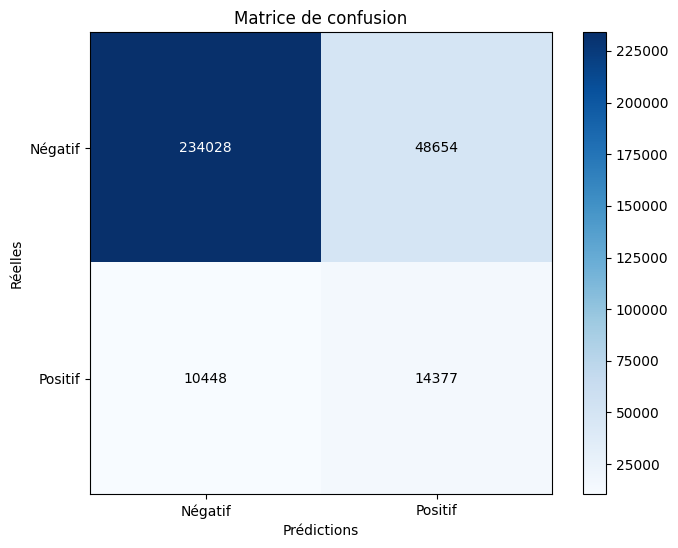

In [ ]:
# Calculer les prédictions sur l'ensemble de test
y_pred_test = y_pred_test_xgb_300

# Calculer la matrice de confusion
cm = confusion_matrix(y_test, y_pred_test)

# Afficher la matrice de confusion
plt.figure(figsize=(8, 6))
plt.imshow(cm, cmap=plt.cm.Blues, interpolation='nearest')
plt.colorbar()
plt.title('Matrice de confusion')
plt.xlabel('Prédictions')
plt.ylabel('Réelles')
tick_marks = np.arange(2)
plt.xticks(tick_marks, ['Négatif', 'Positif'])
plt.yticks(tick_marks, ['Négatif', 'Positif'])

# Ajouter les valeurs dans les cases
thresh = cm.max() / 2.
for i in range(cm.shape[0]):
    for j in range(cm.shape[1]):
        plt.text(j, i, cm[i, j], ha="center", va="center", color="white" if cm[i, j] > thresh else "black")

# Interprétation de la matrice de confusion
tn, fp, fn, tp = cm.ravel()
total = tn + fp + fn + tp

print(f"Taux de vrais négatifs (spécificité) : {tn / (tn + fp):.2f}")
print(f"Taux de faux positifs : {fp / (tn + fp):.2f}")
print(f"Taux de vrais positifs (sensibilité) : {tp / (tp + fn):.2f}")
print(f"Taux de faux négatifs : {fn / (tp + fn):.2f}")
print(f"Précision : {tp / (tp + fp):.2f}")
print(f"Accuracy : {(tp + tn) / total:.2f}")

plt.show()

Modèle entraîné et testé sur un jeu équilibré :

La précision est élevée (0,71), ce qui signifie que le modèle est performant pour classer correctement les exemples positifs (clients avec difficultés).
Le taux de vrais positifs (sensibilité) est également élevé (0,70), ce qui indique que le modèle détecte bien les cas positifs.
L'accuracy est de 0,71, ce qui est cohérent avec un jeu de données équilibré.

Modèle entraîné sur un jeu équilibré et testé sur un jeu déséquilibré :

La précision est faible (0,23), ce qui signifie que le modèle a du mal à classer correctement les exemples positifs (clients avec difficultés).
Le taux de vrais positifs (sensibilité) est également faible (0,58), ce qui indique que le modèle manque de nombreux cas positifs.
Cependant, l'accuracy est élevée (0,81) en raison du déséquilibre des classes dans le jeu de test.
Dans ce cas, le modèle entraîné et testé sur un jeu équilibré semble être plus performant pour détecter les clients avec des difficultés de remboursement (classe minoritaire). Cependant, lorsqu'il est testé sur un jeu déséquilibré, ses performances se dégradent, en particulier pour la détection des cas positifs.

Comme mentionné précédemment, dans ce genre de situation où les classes sont déséquilibrées, il est préférable de se concentrer sur des métriques comme la précision, le rappel (sensibilité) et le F1-score plutôt que sur l'accuracy. L'accuracy peut être trompeuse lorsque les classes sont déséquilibrées, car elle ne tient pas compte de la distribution des classes.


L'AUC-ROC (Area Under the Receiver Operating Characteristic Curve) est une métrique très utile pour évaluer les performances d'un modèle de classification, en particulier lorsque les classes sont déséquilibrées.

Une valeur d'AUC-ROC de 0,79 indique que le modèle a une bonne capacité à distinguer les exemples positifs (clients avec difficultés) des exemples négatifs (clients sans difficulté).

Voici une interprétation générale des valeurs d'AUC-ROC :

0,5 : Le modèle n'est pas meilleur qu'un classifieur aléatoire.
0,6 à 0,7 : Le modèle a une capacité de discrimination faible à modérée.
0,7 à 0,8 : Le modèle a une bonne capacité de discrimination.
0,8 à 0,9 : Le modèle a une très bonne capacité de discrimination.
0,9 à 1,0 : Le modèle a une excellente capacité de discrimination.
Avec une AUC-ROC de 0,79, votre modèle se situe dans la catégorie "bonne capacité de discrimination". Cela signifie qu'il est capable de classer correctement les exemples positifs et négatifs de manière satisfaisante, malgré le déséquilibre des classes.

Cependant, il est important de noter que l'AUC-ROC ne tient pas compte des coûts associés aux faux positifs et aux faux négatifs. Dans notre cas, où il s'agit de prédire si un client aura des difficultés à rembourser son emprunt, ces coûts peuvent être très différents selon le type d'erreur.

## <font color="orange">Ajustement du seuil de décision (pour le modèle entraîné et testé sur jeu équilibré)

Dans ce cas, le modèle de classification fournit une probabilité de prédiction pour chaque client. Par défaut, un seuil de décision de 0,5 est généralement utilisé pour classer les instances comme positives (risque de non-remboursement, TARGET=1) ou négatives (pas de risque, TARGET=0). Cela signifie que si la probabilité prédite est supérieure à 0,5, l'instance est classée comme positive, sinon elle est classée comme négative.

Cependant, ce seuil de décision par défaut de 0,5 peut ne pas être optimal dans certains cas, en fonction des coûts relatifs des faux positifs et des faux négatifs dans votre problème spécifique.

Par exemple, si le coût d'un faux positif (prédire à tort un risque de non-remboursement pour un client solvable) est plus élevé que le coût d'un faux négatif (manquer un client à risque), on peut ajuster le seuil de décision à une valeur plus élevée, disons 0,7. Cela réduira le nombre de faux positifs, mais augmentera le nombre de faux négatifs.

À l'inverse, si le coût d'un faux négatif est plus élevé (manquer un client à risque peut entraîner des pertes financières importantes), on peut abaisser le seuil de décision, disons à 0,3. Cela augmentera le nombre de faux positifs, mais réduira le nombre de faux négatifs.

L'ajustement du seuil de décision permet donc de trouver un compromis entre les taux de faux positifs et de faux négatifs, en fonction des coûts relatifs associés à chaque type d'erreur.

Pour ajuster le seuil de décision, vous pouvez utiliser des courbes ROC (Receiver Operating Characteristic) et la métrique AUC (Area Under the Curve). Ces outils vous permettront de visualiser les compromis entre les taux de vrais positifs et de faux positifs pour différents seuils, et de choisir le seuil optimal en fonction de vos objectifs.

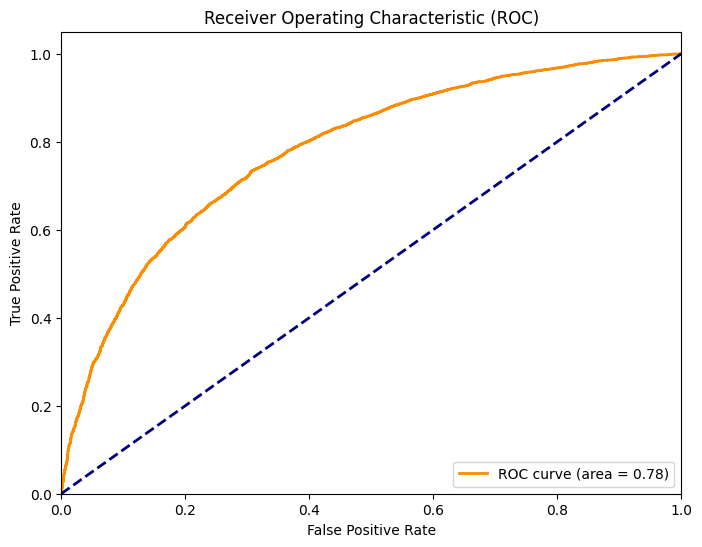

Accuracy avec seuil par défaut (0.5) : 0.71
Précision avec seuil par défaut (0.5) : 0.71
Rappel avec seuil par défaut (0.5) : 0.70
Score F1 avec seuil par défaut (0.5) : 0.71


In [ ]:
# Calculer les probabilités de prédiction sur l'ensemble de test
y_pred_proba = xgb_best.predict_proba(X_test_arr[:, top_features_indices])[:, 1]

# Calculer la courbe ROC et l'AUC
fpr, tpr, thresholds = roc_curve(y_test, y_pred_proba)
roc_auc = auc(fpr, tpr)

# Tracer la courbe ROC
import matplotlib.pyplot as plt
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC)')
plt.legend(loc="lower right")
plt.show()

# Calculer les prédictions binaires avec le seuil par défaut (0.5)
y_pred_test = np.where(y_pred_proba >= 0.5, 1, 0)

# Calculer les métriques avec le seuil par défaut
accuracy = accuracy_score(y_test, y_pred_test)
precision = precision_score(y_test, y_pred_test)
recall = recall_score(y_test, y_pred_test)
f1 = f1_score(y_test, y_pred_test)

print(f"Accuracy avec seuil par défaut (0.5) : {accuracy:.2f}")
print(f"Précision avec seuil par défaut (0.5) : {precision:.2f}")
print(f"Rappel avec seuil par défaut (0.5) : {recall:.2f}")
print(f"Score F1 avec seuil par défaut (0.5) : {f1:.2f}")


Une courbe ROC proche du coin supérieur gauche (AUC proche de 1) indique de bonnes performances de classification

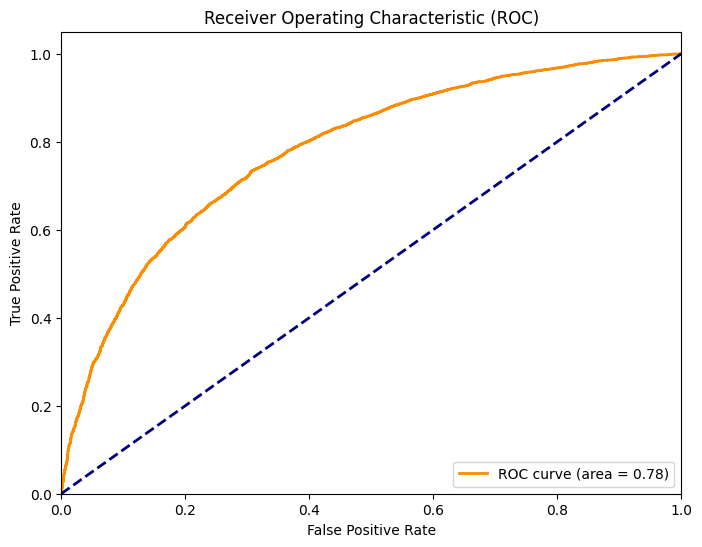

Accuracy avec seuil ajusté à 0.8 : 0.58
Précision avec seuil ajusté à 0.8 : 0.86
Rappel avec seuil ajusté à 0.8 : 0.19
Score F1 avec seuil ajusté à 0.8 : 0.31


In [ ]:
# Calculer les probabilités de prédiction sur l'ensemble de test
y_pred_proba = xgb_best.predict_proba(X_test_arr[:, top_features_indices])[:, 1]

# Calculer la courbe ROC et l'AUC
fpr, tpr, thresholds = roc_curve(y_test, y_pred_proba)
roc_auc = auc(fpr, tpr)

# Tracer la courbe ROC
import matplotlib.pyplot as plt
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC)')
plt.legend(loc="lower right")
plt.show()

# Ajuster le seuil de décision à 0.8
y_pred_test_adjusted = np.where(y_pred_proba >= 0.8, 1, 0)

# Calculer les métriques avec le seuil ajusté
accuracy_adjusted = accuracy_score(y_test, y_pred_test_adjusted)
precision_adjusted = precision_score(y_test, y_pred_test_adjusted)
recall_adjusted = recall_score(y_test, y_pred_test_adjusted)
f1_adjusted = f1_score(y_test, y_pred_test_adjusted)

print(f"Accuracy avec seuil ajusté à 0.8 : {accuracy_adjusted:.2f}")
print(f"Précision avec seuil ajusté à 0.8 : {precision_adjusted:.2f}")
print(f"Rappel avec seuil ajusté à 0.8 : {recall_adjusted:.2f}")
print(f"Score F1 avec seuil ajusté à 0.8 : {f1_adjusted:.2f}")

En ajustant le seuil à 0.8, on observe les changements suivants :

L'accuracy diminue à 0.58, ce qui signifie que le modèle classe correctement moins d'instances.
La précision augmente à 0.86, ce qui signifie que le modèle fait moins de faux positifs (instances négatives prédites comme positives).
Le rappel diminue fortement à 0.19, ce qui signifie que le modèle manque beaucoup d'instances positives (faux négatifs élevés).
Le score F1, qui combine précision et rappel, diminue à 0.31, reflétant les faibles performances du modèle avec ce seuil.

En résumé, en augmentant le seuil de décision à 0.8, le modèle devient **plus conservateur** et prédit moins d'instances comme positives. Cela réduit les faux positifs (précision élevée), mais augmente considérablement les faux négatifs (rappel faible).

L'objectif d'une banque c'est de faire du gain, dans ce cas

Avec un seuil de 0.5 (par défaut) :

Précision de 0.71 : Sur les clients prédits comme risqués, environ 71% le sont réellement.
Rappel de 0.70 : Le modèle détecte 70% des clients réellement risqués.

Avec un seuil de 0.8 :

Précision de 0.86 : Sur les clients prédits comme risqués, 86% le sont réellement, réduisant les faux positifs coûteux.
Rappel de 0.19 : Seulement 19% des clients réellement risqués sont détectés, manquant beaucoup de risques potentiels.

**Pour maximiser les gains, la banque voudra probablement** :

Minimiser les pertes dues aux défauts de paiement des clients risqués (faux négatifs)
Minimiser les coûts liés à un suivi supplémentaire des clients non risqués (faux positifs)
Avec un seuil de 0.5, le rappel de 0.70 permet de détecter une proportion raisonnable des clients risqués, mais la précision de 0.71 implique des coûts supplémentaires pour le suivi des 29% de faux positifs.

Avec un seuil de 0.8, la précision de 0.86 réduit les coûts de suivi des faux positifs, mais le faible rappel de 0.19 manque 81% des clients réellement risqués, ce qui pourrait entraîner des pertes importantes.

Dans ce contexte, je recommanderais un seuil intermédiaire, peut-être autour de 0.6 ou 0.7, pour trouver un meilleur équilibre entre la détection des clients risqués (rappel) et la minimisation des coûts de suivi des faux positifs (précision).

On peut également explorer d'autres techniques comme l'optimisation des coûts ou l'ajustement des poids de classe pour donner plus d'importance à la détection des instances positives (clients risqués).

Une analyse plus approfondie du contexte métier, des coûts réels associés aux différents types d'erreurs et des exigences spécifiques de la banque serait nécessaire pour prendre une décision définitive sur le seuil optimal.

In [ ]:
df_final_train = pd.read_csv('/content/drive/MyDrive/P7/df_final_train.csv')

In [ ]:
df_final_train.info()

# Compter les NaN par colonne
nb_nan_par_colonne = df_final_train.isna().sum()
print(nb_nan_par_colonne)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39720 entries, 0 to 39719
Columns: 301 entries, EXT_SOURCE_3 to TARGET
dtypes: bool(53), float64(231), int64(16), object(1)
memory usage: 77.2+ MB
EXT_SOURCE_3                                         8479
EXT_SOURCE_2                                           74
NAME_EDUCATION_TYPE_Secondary / secondary special       0
CODE_GENDER                                             0
FLAG_DOCUMENT_3                                         0
                                                     ... 
PREV_NAME_GOODS_CATEGORY_Gardening_MEAN              1908
ORGANIZATION_TYPE_Emergency                             0
PREV_CODE_REJECT_REASON_CLIENT_MEAN                  1908
WEEKDAY_APPR_PROCESS_START_TUESDAY                      0
TARGET                                                  0
Length: 301, dtype: int64


In [ ]:
df_final_test = pd.read_csv('/content/drive/MyDrive/P7/df_final_test.csv')

Accuracy avec seuil ajusté à 0.7 : 0.65
Précision avec seuil ajusté à 0.7 : 0.82
Rappel avec seuil ajusté à 0.7 : 0.39
Score F1 avec seuil ajusté à 0.7 : 0.53


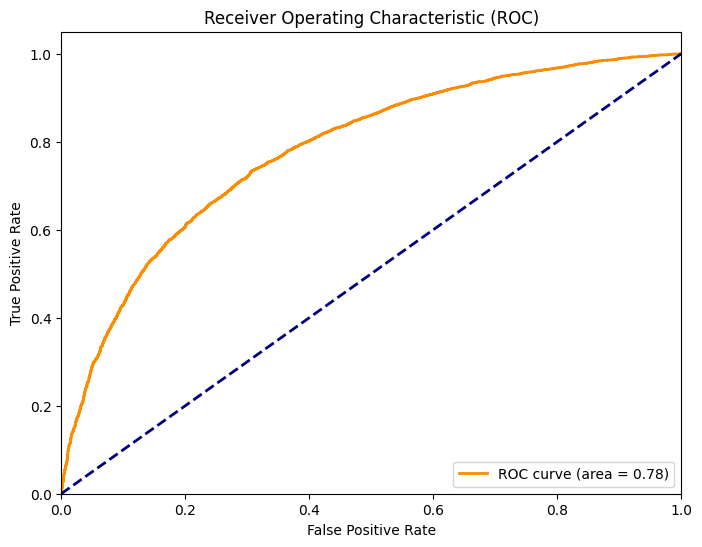

In [ ]:
# Séparation des features et de la cible
X_train = df_final_train.drop('TARGET', axis=1)
y_train = df_final_train['TARGET']
X_test = df_final_test.drop('TARGET', axis=1)
y_test = df_final_test['TARGET']

X_train = X_train.to_numpy()
X_test = X_test.to_numpy()

# Importance des caractéristiques avec XGBoost
xgb = XGBClassifier().fit(X_train, y_train)
importances = xgb.feature_importances_
top_features_indices = np.argsort(importances)[::-1][:300]

# Espace de recherche réduit
param_grid = {
    'max_depth': [3],
    'n_estimators': [200],
    'learning_rate': [0.1]
}

# Création du modèle XGBoost
xgb = XGBClassifier(objective='binary:logistic', eval_metric='auc')

# Recherche d'hyperparamètres avec GridSearchCV
grid_search = GridSearchCV(xgb, param_grid=param_grid, cv=3, scoring='roc_auc', n_jobs=-1)
grid_search.fit(X_train[:, top_features_indices], y_train)

# Meilleurs hyperparamètres
best_params = grid_search.best_params_

# Entraînement du modèle avec les meilleurs hyperparamètres
xgb_best = XGBClassifier(**best_params, objective='binary:logistic', eval_metric='auc')
xgb_best.fit(X_train[:, top_features_indices], y_train)

# Prédictions sur l'ensemble de test
y_pred_proba = xgb_best.predict_proba(X_test[:, top_features_indices])[:, 1]

# Ajuster le seuil de décision à 0.7
y_pred_test_adjusted = np.where(y_pred_proba >= 0.7, 1, 0)

# Calculer les métriques avec le seuil ajusté à 0.7
accuracy_adjusted = accuracy_score(y_test, y_pred_test_adjusted)
precision_adjusted = precision_score(y_test, y_pred_test_adjusted)
recall_adjusted = recall_score(y_test, y_pred_test_adjusted)
f1_adjusted = f1_score(y_test, y_pred_test_adjusted)

print(f"Accuracy avec seuil ajusté à 0.7 : {accuracy_adjusted:.2f}")
print(f"Précision avec seuil ajusté à 0.7 : {precision_adjusted:.2f}")
print(f"Rappel avec seuil ajusté à 0.7 : {recall_adjusted:.2f}")
print(f"Score F1 avec seuil ajusté à 0.7 : {f1_adjusted:.2f}")

# Calculer la courbe ROC et l'AUC
fpr, tpr, thresholds = roc_curve(y_test, y_pred_proba)
roc_auc = auc(fpr, tpr)

# Tracer la courbe ROC
import matplotlib.pyplot as plt
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC)')
plt.legend(loc="lower right")
plt.show()

# Création du graphique avec Plotly
trace1 = go.Bar(x=['Accuracy', 'Precision', 'Recall', 'F1-Score', 'AUC-ROC'],
                y=[accuracy_adjusted, precision_adjusted, recall_adjusted, f1_adjusted, roc_auc],
                name='XGBoost (Seuil 0.7)', marker=dict(color='lightgreen'))

layout = go.Layout(title='Performances du modèle XGBoost', xaxis=dict(title='Métrique'), yaxis=dict(title='Valeur'))

fig = go.Figure(data=[trace1], layout=layout)
fig.show()

D'après les métriques affichées avec un seuil de décision ajusté à 0.7:

Accuracy : 0.65
Une accuracy de 0.65 signifie que le modèle classe correctement 65% des instances. C'est une performance correcte mais qui pourrait être améliorée.

Précision : 0.82
Une précision de 0.82 est assez élevée, ce qui signifie que lorsque le modèle prédit une instance comme positive (risque de non-remboursement), il a **82% de chances d'avoir raison.** Cela permet de minimiser les faux positifs coûteux.

Rappel : 0.39
Un rappel de 0.39 est relativement faible. Cela signifie que le modèle ne détecte que 39% des instances réellement positives (risque de non-remboursement). Ainsi, 61% des clients à risque sont manqués, ce qui peut entraîner des pertes financières importantes pour la banque.

Score F1 : 0.53
Le score F1, qui combine la précision et le rappel, est de 0.53. Cette valeur est correcte mais pourrait être améliorée, car elle est influencée par le faible rappel.

AUC-ROC : 0.7804
Une AUC-ROC de 0.7804 indique des performances globales correctes du modèle, mais pas excellentes. Cette valeur signifie que si l'on sélectionne aléatoirement une instance positive et une instance négative, le modèle attribuera une probabilité de prédiction plus élevée à l'instance positive dans environ 78% des cas.

Dans l'ensemble, ces métriques suggèrent que le modèle actuel avec un seuil de 0.7 est assez précis pour minimiser les faux positifs, mais manque de rappel pour détecter une proportion suffisante des clients à risque. Cela peut être problématique pour la banque, car les pertes potentielles dues aux faux négatifs (clients à risque non détectés) pourraient être importantes.

Métriques sur l'ensemble d'entraînement :
Accuracy avec seuil ajusté à 0.7 : 0.66
Précision avec seuil ajusté à 0.7 : 0.85
Rappel avec seuil ajusté à 0.7 : 0.40
Score F1 avec seuil ajusté à 0.7 : 0.54

Métriques sur l'ensemble de test :
Accuracy avec seuil ajusté à 0.7 : 0.65
Précision avec seuil ajusté à 0.7 : 0.82
Rappel avec seuil ajusté à 0.7 : 0.39
Score F1 avec seuil ajusté à 0.7 : 0.53


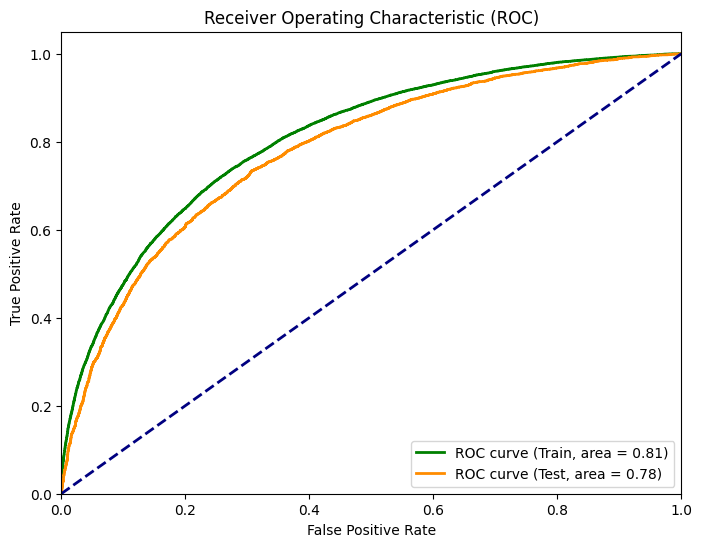

In [ ]:
# Séparation des features et de la cible
X_train = df_final_train.drop('TARGET', axis=1)
y_train = df_final_train['TARGET']
X_test = df_final_test.drop('TARGET', axis=1)
y_test = df_final_test['TARGET']

X_train = X_train.to_numpy()
X_test = X_test.to_numpy()

# Importance des caractéristiques avec XGBoost
xgb = XGBClassifier().fit(X_train, y_train)
importances = xgb.feature_importances_
top_features_indices = np.argsort(importances)[::-1][:300]

# Entraînement du modèle XGBoost avec les 300 features les plus importantes
xgb_best = XGBClassifier(max_depth=3, n_estimators=200, learning_rate=0.1, objective='binary:logistic', eval_metric='auc')
xgb_best.fit(X_train[:, top_features_indices], y_train)

# Prédictions sur l'ensemble de train
y_pred_proba_train = xgb_best.predict_proba(X_train[:, top_features_indices])[:, 1]

# Prédictions sur l'ensemble de test
y_pred_proba_test = xgb_best.predict_proba(X_test[:, top_features_indices])[:, 1]

# Ajuster le seuil de décision à 0.7
y_pred_train_adjusted = np.where(y_pred_proba_train >= 0.7, 1, 0)
y_pred_test_adjusted = np.where(y_pred_proba_test >= 0.7, 1, 0)

# Calculer les métriques sur l'ensemble d'entraînement avec le seuil ajusté à 0.7
accuracy_train_adjusted = accuracy_score(y_train, y_pred_train_adjusted)
precision_train_adjusted = precision_score(y_train, y_pred_train_adjusted)
recall_train_adjusted = recall_score(y_train, y_pred_train_adjusted)
f1_train_adjusted = f1_score(y_train, y_pred_train_adjusted)

# Calculer les métriques sur l'ensemble de test avec le seuil ajusté à 0.7
accuracy_test_adjusted = accuracy_score(y_test, y_pred_test_adjusted)
precision_test_adjusted = precision_score(y_test, y_pred_test_adjusted)
recall_test_adjusted = recall_score(y_test, y_pred_test_adjusted)
f1_test_adjusted = f1_score(y_test, y_pred_test_adjusted)

print("Métriques sur l'ensemble d'entraînement :")
print(f"Accuracy avec seuil ajusté à 0.7 : {accuracy_train_adjusted:.2f}")
print(f"Précision avec seuil ajusté à 0.7 : {precision_train_adjusted:.2f}")
print(f"Rappel avec seuil ajusté à 0.7 : {recall_train_adjusted:.2f}")
print(f"Score F1 avec seuil ajusté à 0.7 : {f1_train_adjusted:.2f}")

print("\nMétriques sur l'ensemble de test :")
print(f"Accuracy avec seuil ajusté à 0.7 : {accuracy_test_adjusted:.2f}")
print(f"Précision avec seuil ajusté à 0.7 : {precision_test_adjusted:.2f}")
print(f"Rappel avec seuil ajusté à 0.7 : {recall_test_adjusted:.2f}")
print(f"Score F1 avec seuil ajusté à 0.7 : {f1_test_adjusted:.2f}")

# Calculer la courbe ROC et l'AUC sur l'ensemble d'entraînement
fpr_train, tpr_train, thresholds_train = roc_curve(y_train, y_pred_proba_train)
roc_auc_train = auc(fpr_train, tpr_train)

# Calculer la courbe ROC et l'AUC sur l'ensemble de test
fpr_test, tpr_test, thresholds_test = roc_curve(y_test, y_pred_proba_test)
roc_auc_test = auc(fpr_test, tpr_test)

# Tracer les courbes ROC
import matplotlib.pyplot as plt
plt.figure(figsize=(8, 6))
plt.plot(fpr_train, tpr_train, color='green', lw=2, label='ROC curve (Train, area = %0.2f)' % roc_auc_train)
plt.plot(fpr_test, tpr_test, color='darkorange', lw=2, label='ROC curve (Test, area = %0.2f)' % roc_auc_test)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC)')
plt.legend(loc="lower right")
plt.show()

# Création du graphique avec Plotly
trace1 = go.Bar(x=['Accuracy', 'Precision', 'Recall', 'F1-Score', 'AUC-ROC'],
                y=[accuracy_train_adjusted, precision_train_adjusted, recall_train_adjusted, f1_train_adjusted, roc_auc_train],
                name='XGBoost (Train, Seuil 0.7)', marker=dict(color='lightgreen'))

trace2 = go.Bar(x=['Accuracy', 'Precision', 'Recall', 'F1-Score', 'AUC-ROC'],
                y=[accuracy_test_adjusted, precision_test_adjusted, recall_test_adjusted, f1_test_adjusted, roc_auc_test],
                name='XGBoost (Test, Seuil 0.7)', marker=dict(color='lightsalmon'))

layout = go.Layout(title='Performances du modèle XGBoost', xaxis=dict(title='Métrique'), yaxis=dict(title='Valeur'),
                   barmode='group')

fig = go.Figure(data=[trace1, trace2], layout=layout)
fig.show()

Métriques sur l'ensemble d'entraînement :
Accuracy avec seuil ajusté à 0.65 : 0.69
Précision avec seuil ajusté à 0.65 : 0.82
Rappel avec seuil ajusté à 0.65 : 0.49
Score F1 avec seuil ajusté à 0.65 : 0.61

Métriques sur l'ensemble de test :
Accuracy avec seuil ajusté à 0.65 : 0.68
Précision avec seuil ajusté à 0.65 : 0.80
Rappel avec seuil ajusté à 0.65 : 0.48
Score F1 avec seuil ajusté à 0.65 : 0.60


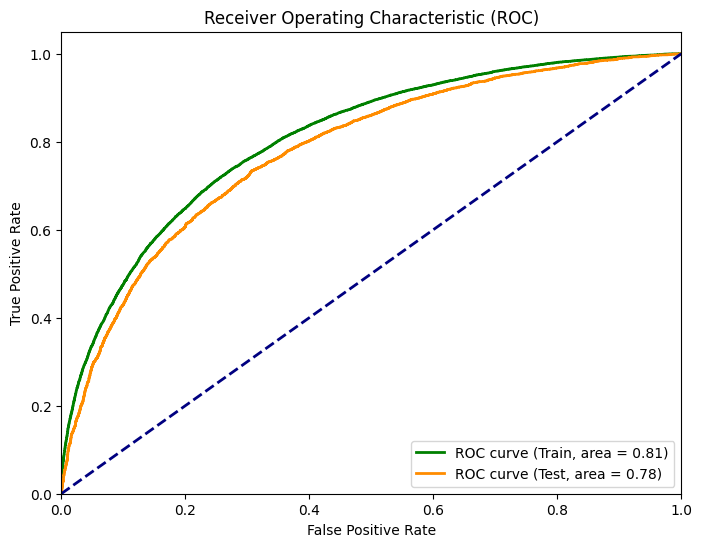

In [ ]:

# Séparation des features et de la cible
X_train = df_final_train.drop('TARGET', axis=1)
y_train = df_final_train['TARGET']
X_test = df_final_test.drop('TARGET', axis=1)
y_test = df_final_test['TARGET']

X_train = X_train.to_numpy()
X_test = X_test.to_numpy()

# Importance des caractéristiques avec XGBoost
xgb = XGBClassifier().fit(X_train, y_train)
importances = xgb.feature_importances_
top_features_indices = np.argsort(importances)[::-1][:300]

# Entraînement du modèle XGBoost avec les 300 features les plus importantes
xgb_best = XGBClassifier(max_depth=3, n_estimators=200, learning_rate=0.1, objective='binary:logistic', eval_metric='auc')
xgb_best.fit(X_train[:, top_features_indices], y_train)

# Prédictions sur l'ensemble de train
y_pred_proba_train = xgb_best.predict_proba(X_train[:, top_features_indices])[:, 1]

# Prédictions sur l'ensemble de test
y_pred_proba_test = xgb_best.predict_proba(X_test[:, top_features_indices])[:, 1]

# Ajuster le seuil de décision à 0.65
y_pred_train_adjusted = np.where(y_pred_proba_train >= 0.65, 1, 0)
y_pred_test_adjusted = np.where(y_pred_proba_test >= 0.65, 1, 0)

# Calculer les métriques sur l'ensemble d'entraînement avec le seuil ajusté à 0.65
accuracy_train_adjusted = accuracy_score(y_train, y_pred_train_adjusted)
precision_train_adjusted = precision_score(y_train, y_pred_train_adjusted)
recall_train_adjusted = recall_score(y_train, y_pred_train_adjusted)
f1_train_adjusted = f1_score(y_train, y_pred_train_adjusted)

# Calculer les métriques sur l'ensemble de test avec le seuil ajusté à 0.65
accuracy_test_adjusted = accuracy_score(y_test, y_pred_test_adjusted)
precision_test_adjusted = precision_score(y_test, y_pred_test_adjusted)
recall_test_adjusted = recall_score(y_test, y_pred_test_adjusted)
f1_test_adjusted = f1_score(y_test, y_pred_test_adjusted)

print("Métriques sur l'ensemble d'entraînement :")
print(f"Accuracy avec seuil ajusté à 0.65 : {accuracy_train_adjusted:.2f}")
print(f"Précision avec seuil ajusté à 0.65 : {precision_train_adjusted:.2f}")
print(f"Rappel avec seuil ajusté à 0.65 : {recall_train_adjusted:.2f}")
print(f"Score F1 avec seuil ajusté à 0.65 : {f1_train_adjusted:.2f}")

print("\nMétriques sur l'ensemble de test :")
print(f"Accuracy avec seuil ajusté à 0.65 : {accuracy_test_adjusted:.2f}")
print(f"Précision avec seuil ajusté à 0.65 : {precision_test_adjusted:.2f}")
print(f"Rappel avec seuil ajusté à 0.65 : {recall_test_adjusted:.2f}")
print(f"Score F1 avec seuil ajusté à 0.65 : {f1_test_adjusted:.2f}")

# Calculer la courbe ROC et l'AUC sur l'ensemble d'entraînement
fpr_train, tpr_train, thresholds_train = roc_curve(y_train, y_pred_proba_train)
roc_auc_train = auc(fpr_train, tpr_train)

# Calculer la courbe ROC et l'AUC sur l'ensemble de test
fpr_test, tpr_test, thresholds_test = roc_curve(y_test, y_pred_proba_test)
roc_auc_test = auc(fpr_test, tpr_test)

# Tracer les courbes ROC
import matplotlib.pyplot as plt
plt.figure(figsize=(8, 6))
plt.plot(fpr_train, tpr_train, color='green', lw=2, label='ROC curve (Train, area = %0.2f)' % roc_auc_train)
plt.plot(fpr_test, tpr_test, color='darkorange', lw=2, label='ROC curve (Test, area = %0.2f)' % roc_auc_test)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC)')
plt.legend(loc="lower right")
plt.show()

# Création du graphique avec Plotly
trace1 = go.Bar(x=['Accuracy', 'Precision', 'Recall', 'F1-Score', 'AUC-ROC'],
                y=[accuracy_train_adjusted, precision_train_adjusted, recall_train_adjusted, f1_train_adjusted, roc_auc_train],
                name='XGBoost (Train, Seuil 0.65)', marker=dict(color='lightgreen'))

trace2 = go.Bar(x=['Accuracy', 'Precision', 'Recall', 'F1-Score', 'AUC-ROC'],
                y=[accuracy_test_adjusted, precision_test_adjusted, recall_test_adjusted, f1_test_adjusted, roc_auc_test],
                name='XGBoost (Test, Seuil 0.65)', marker=dict(color='lightsalmon'))

layout = go.Layout(title='Performances du modèle XGBoost', xaxis=dict(title='Métrique'), yaxis=dict(title='Valeur'),
                   barmode='group')

fig = go.Figure(data=[trace1, trace2], layout=layout)
fig.show()

Ensemble d'entraînement :

Accuracy : 0.69 (69% des instances sont correctement classées)
Précision : 0.82 (82% des instances prédites comme positives sont réellement positives)

Rappel : 0.49 (Le modèle détecte 49% des instances réellement positives)

Score F1 : 0.61 (Moyenne harmonique de la précision et du rappel)

AUC-ROC : 0.80 (Capacité du modèle à séparer les classes positives et négatives sur l'entraînement)

Ensemble de test :

Accuracy : 0.68 (68% des instances sont correctement classées)

Précision : 0.80 (80% des instances prédites comme positives sont réellement positives)

Rappel : 0.48 (Le modèle détecte 48% des instances réellement positives)

Score F1 : 0.60 (Moyenne harmonique de la précision et du rappel)

AUC-ROC : 0.78 (Capacité du modèle à séparer les classes positives et négatives sur le test)

Avec un seuil de 0.65, le modèle a une précision élevée (0.82 sur l'entraînement et 0.80 sur le test), ce qui signifie qu'il commet peu de faux positifs. Cependant, le rappel est relativement faible (0.49 sur l'entraînement et 0.48 sur le test), mais il est meilleur qu'avec un seuil d'ajustement à 0.5.

L'accuracy est similaire sur les deux ensembles (0.69 sur l'entraînement et 0.68 sur le test), ce qui suggère une bonne généralisation du modèle.

Les valeurs de l'AUC-ROC sont élevées, avec 0.80 sur l'entraînement et 0.78 sur le test. Cela indique que le modèle a une bonne capacité à séparer les classes positives et négatives. Cependant, l'écart entre les valeurs de l'AUC-ROC sur l'entraînement et le test pourrait indiquer un léger sur-apprentissage MAIS je le valide au regard du fait qu'il n'est pas supérieur au meilleur de la compéttin kaggle qui est de 0.82.

En résumé, avec un seuil de 0.65, le modèle a une bonne précision et un meilleur rappel.

Suite à un problème de chargement en json des données sur l'api, et après analyse de la feature, j'ai décidé de la supprimer pour éviter de passer en numpy.

In [ ]:
X_train = X_train.to_numpy()
X_test = X_test.to_numpy()

In [ ]:
object_cols = df_final_train.select_dtypes(include=['object']).columns
print(object_cols)

Index(['CC_NAME_CONTRACT_STATUS_Signed_MAX'], dtype='object')


In [ ]:
# Supprimer la colonne CC_NAME_CONTRACT_STATUS_Signed_MAX
df_final_train = df_final_train.drop('CC_NAME_CONTRACT_STATUS_Signed_MAX', axis=1)
df_final_test = df_final_test.drop('CC_NAME_CONTRACT_STATUS_Signed_MAX', axis=1)

In [ ]:
df_final_train.to_csv('/content/drive/MyDrive/P7/df_final_train.csv', index=False)

In [ ]:
df_final_test.to_csv('/content/drive/MyDrive/P7/df_final_test.csv', index=False)

Métriques sur l'ensemble d'entraînement :
Accuracy avec seuil ajusté à 0.45 : 0.73
Précision avec seuil ajusté à 0.45 : 0.70
Rappel avec seuil ajusté à 0.45 : 0.79
Score F1 avec seuil ajusté à 0.45 : 0.74

Métriques sur l'ensemble de test :
Accuracy avec seuil ajusté à 0.45 : 0.71
Précision avec seuil ajusté à 0.45 : 0.69
Rappel avec seuil ajusté à 0.45 : 0.77
Score F1 avec seuil ajusté à 0.45 : 0.72


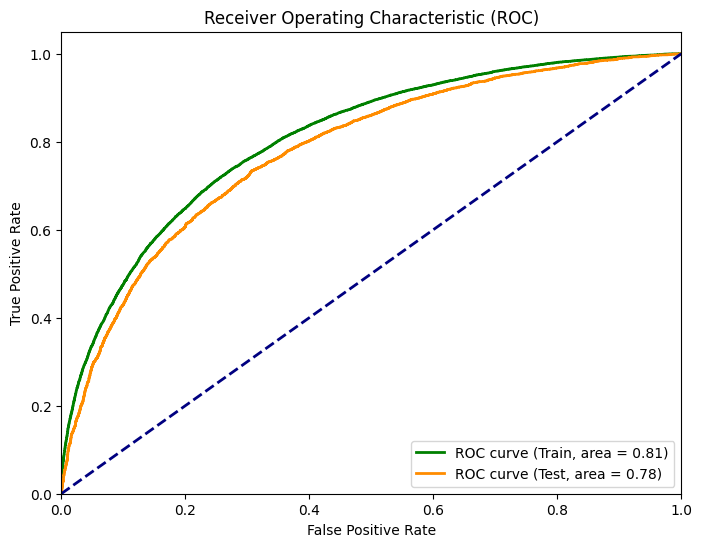

In [ ]:
# Séparation des features et de la cible
X_train = df_final_train.drop('TARGET', axis=1)
y_train = df_final_train['TARGET']
X_test = df_final_test.drop('TARGET', axis=1)
y_test = df_final_test['TARGET']

# Entraînement du modèle XGBoost
xgb_best = XGBClassifier(max_depth=3, n_estimators=200, learning_rate=0.1, objective='binary:logistic', eval_metric='auc')
xgb_best.fit(X_train, y_train)

# Prédictions sur l'ensemble de train
y_pred_proba_train = xgb_best.predict_proba(X_train)[:, 1]

# Prédictions sur l'ensemble de test
y_pred_proba_test = xgb_best.predict_proba(X_test)[:, 1]

# Ajuster le seuil de décision à 0.45
y_pred_train_adjusted = np.where(y_pred_proba_train >= 0.45, 1, 0)
y_pred_test_adjusted = np.where(y_pred_proba_test >= 0.45, 1, 0)

# Calculer les métriques sur l'ensemble d'entraînement avec le seuil ajusté à 0.45
accuracy_train_adjusted = accuracy_score(y_train, y_pred_train_adjusted)
precision_train_adjusted = precision_score(y_train, y_pred_train_adjusted)
recall_train_adjusted = recall_score(y_train, y_pred_train_adjusted)
f1_train_adjusted = f1_score(y_train, y_pred_train_adjusted)

# Calculer les métriques sur l'ensemble de test avec le seuil ajusté à 0.45
accuracy_test_adjusted = accuracy_score(y_test, y_pred_test_adjusted)
precision_test_adjusted = precision_score(y_test, y_pred_test_adjusted)
recall_test_adjusted = recall_score(y_test, y_pred_test_adjusted)
f1_test_adjusted = f1_score(y_test, y_pred_test_adjusted)

print("Métriques sur l'ensemble d'entraînement :")
print(f"Accuracy avec seuil ajusté à 0.45 : {accuracy_train_adjusted:.2f}")
print(f"Précision avec seuil ajusté à 0.45 : {precision_train_adjusted:.2f}")
print(f"Rappel avec seuil ajusté à 0.45 : {recall_train_adjusted:.2f}")
print(f"Score F1 avec seuil ajusté à 0.45 : {f1_train_adjusted:.2f}")

print("\nMétriques sur l'ensemble de test :")
print(f"Accuracy avec seuil ajusté à 0.45 : {accuracy_test_adjusted:.2f}")
print(f"Précision avec seuil ajusté à 0.45 : {precision_test_adjusted:.2f}")
print(f"Rappel avec seuil ajusté à 0.45 : {recall_test_adjusted:.2f}")
print(f"Score F1 avec seuil ajusté à 0.45 : {f1_test_adjusted:.2f}")

# Calculer la courbe ROC et l'AUC sur l'ensemble d'entraînement
fpr_train, tpr_train, thresholds_train = roc_curve(y_train, y_pred_proba_train)
roc_auc_train = auc(fpr_train, tpr_train)

# Calculer la courbe ROC et l'AUC sur l'ensemble de test
fpr_test, tpr_test, thresholds_test = roc_curve(y_test, y_pred_proba_test)
roc_auc_test = auc(fpr_test, tpr_test)

# Tracer les courbes ROC
import matplotlib.pyplot as plt
plt.figure(figsize=(8, 6))
plt.plot(fpr_train, tpr_train, color='green', lw=2, label='ROC curve (Train, area = %0.2f)' % roc_auc_train)
plt.plot(fpr_test, tpr_test, color='darkorange', lw=2, label='ROC curve (Test, area = %0.2f)' % roc_auc_test)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC)')
plt.legend(loc="lower right")
plt.show()

# Création du graphique avec Plotly
trace1 = go.Bar(x=['Accuracy', 'Precision', 'Recall', 'F1-Score', 'AUC-ROC'],
                y=[accuracy_train_adjusted, precision_train_adjusted, recall_train_adjusted, f1_train_adjusted, roc_auc_train],
                name='XGBoost (Train, Seuil 0.45)', marker=dict(color='lightgreen'))

trace2 = go.Bar(x=['Accuracy', 'Precision', 'Recall', 'F1-Score', 'AUC-ROC'],
                y=[accuracy_test_adjusted, precision_test_adjusted, recall_test_adjusted, f1_test_adjusted, roc_auc_test],
                name='XGBoost (Test, Seuil 0.45)', marker=dict(color='lightsalmon'))

layout = go.Layout(title='Performances du modèle XGBoost', xaxis=dict(title='Métrique'), yaxis=dict(title='Valeur'),
                   barmode='group')

fig = go.Figure(data=[trace1, trace2], layout=layout)
fig.show()

Ensemble d'entraînement :

Accuracy : 0.73 (73% des instances sont correctement classées)

Précision : 0.70 (70% des instances prédites comme positives sont réellement positives)

Rappel : 0.79 (Le modèle détecte 79% des instances réellement positives)

Score F1 : 0.74 (Moyenne harmonique de la précision et du rappel)

AUC-ROC : 0.81 (Capacité du modèle à séparer les classes positives et négatives sur l'entraînement)

Ensemble de test :

Accuracy : 0.71 (71% des instances sont correctement classées)

Précision : 0.69 (69% des instances prédites comme positives sont réellement positives)

Rappel : 0.77 (Le modèle détecte 77% des instances réellement positives)

Score F1 : 0.72 (Moyenne harmonique de la précision et du rappel)

AUC-ROC : 0.78 (Capacité du modèle à séparer les classes positives et négatives sur le test)

Avec un seuil de 0.45, le modèle a un bon équilibre entre la précision et le rappel sur les deux ensembles. Le rappel est élevé (0.79 sur l'entraînement et 0.77 sur le test), ce qui signifie que le modèle détecte une grande partie des instances positives. La précision est également acceptable (0.70 sur l'entraînement et 0.69 sur le test), indiquant un taux de faux positifs raisonnable.

L'accuracy est similaire sur les deux ensembles (0.73 sur l'entraînement et 0.71 sur le test), ce qui suggère une bonne généralisation du modèle.

Les valeurs de l'AUC-ROC sont élevées, avec 0.81 sur l'entraînement et 0.78 sur le test. Cela indique que le modèle a une bonne capacité à séparer les classes positives et négatives. L'écart entre les valeurs de l'AUC-ROC sur l'entraînement et le test est réduit par rapport aux seuils précédents, ce qui pourrait indiquer un sur-apprentissage moindre.

En résumé, avec **un seuil de 0.45, le modèle offre un bon compromis entre la précision et le rappel, avec des valeurs élevées pour ces deux métriques. Le choix de ce seuil semble approprié si on souhaite détecter un maximum d'instances positives tout en maintenant un taux de faux positifs raisonnable.**

Mes résultats étant trop performants, il se peut qu'il y ait un problème de data leakage d'une part et d'autre part il faudrait également vérifier que le fait d'équilibrer le jeu de test ne biaise pas non plus les résultats. Je vais alors garder l'entraînement sur le jeu équilibré et tester sur un jeu déséquilibré.

## <font color="orange">Interprétation du modèle : méthode SHAP

SHAP (SHapley Additive exPlanations) est une méthode d'interprétation des modèles d'apprentissage machine, en particulier pour expliquer les prédictions individuelles d'un modèle. Elle a été proposée par Scott M. Lundberg et Su-In Lee en 2017.

L'objectif principal de SHAP est de fournir une explication interprétable des prédictions d'un modèle en attribuant une valeur d'importance (appelée valeur SHAP) à chaque caractéristique pour une instance donnée. Ces valeurs SHAP représentent la contribution de chaque caractéristique à la prédiction du modèle.

La méthode SHAP repose sur des concepts de la théorie des jeux coopératifs, en particulier les valeurs de Shapley. Ces valeurs sont utilisées pour répartir équitablement les contributions des caractéristiques à la prédiction du modèle.

Voici quelques avantages clés de SHAP :

Interprétabilité locale: SHAP fournit des explications pour chaque instance individuelle, ce qui permet de comprendre les raisons spécifiques derrière une prédiction particulière.

Cohérence avec les attentes: Les valeurs SHAP sont conçues pour être cohérentes avec les attentes humaines d'une explication, comme l'additivité des contributions des caractéristiques.

Théorie solide: SHAP repose sur des fondements théoriques solides issus de la théorie des jeux coopératifs, ce qui garantit des propriétés souhaitables pour les explications.

Modèle agnostique: SHAP peut être appliqué à différents types de modèles d'apprentissage machine, tels que les arbres de décision, les forêts aléatoires, les réseaux de neurones, etc.

Visualisations intuitives: Les valeurs SHAP peuvent être visualisées sous forme de graphiques intuitifs, comme les graphiques de force ou les graphiques de dépendance, facilitant l'interprétation des résultats.

SHAP est particulièrement utile dans des domaines où l'interprétabilité des modèles est cruciale, comme la finance, la médecine ou la prise de décision automatisée. Elle permet aux experts du domaine de comprendre les raisons sous-jacentes aux prédictions du modèle et d'identifier les caractéristiques les plus influentes pour une instance donnée.

In [ ]:
shap.initjs()

## <font color="orange">Interprétation globale : importance des features sur l'ensemble du jeu de données

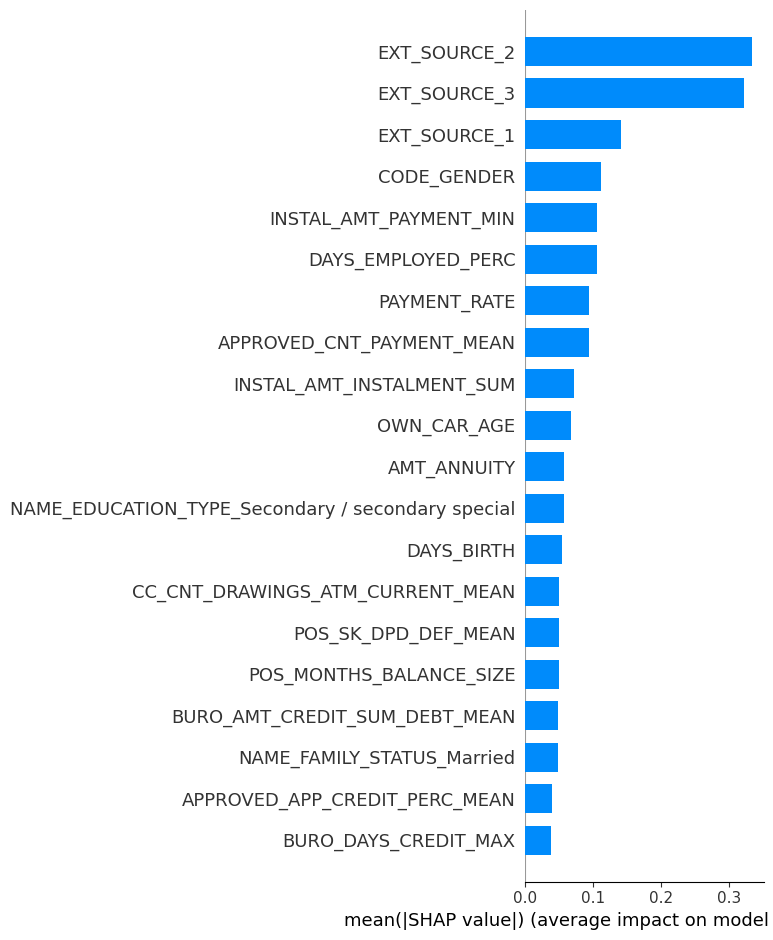

In [ ]:
                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                         # Charger votre modèle XGBoost entraîné
model = xgb.Booster(model_file='/content/drive/MyDrive/P7/mon_modele.json')

# Charger les données d'entraînement
df_final_train = pd.read_csv('/content/drive/MyDrive/P7/df_final_train.csv')

# Séparation des features et de la cible
X_train = df_final_train.drop('TARGET', axis=1)

# Calculer les valeurs SHAP pour l'ensemble du jeu de données
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_train)

# Visualiser l'importance globale des features
shap.summary_plot(shap_values, X_train, plot_type="bar")


## <font color="yellow">Feature EXT_SOURCE
Dans le domaine bancaire, la feature "normalized score from external data source" fait probablement référence à un score normalisé provenant d'une source de données externe, qui est utilisé pour évaluer le risque de crédit ou la solvabilité d'un client.

Voici quelques explications possibles sur ce que pourrait représenter cette feature :

Source de données externe : Il s'agit généralement d'un bureau de crédit ou d'une agence d'évaluation de crédit externe, comme Experian, Equifax ou TransUnion. Ces agences collectent et agrègent des informations sur l'historique de crédit, les dettes, les paiements, etc. des consommateurs à partir de diverses sources (prêteurs, détaillants, services publics, etc.).

Score normalisé : Le score brut fourni par la source de données externe est généralement normalisé ou mis à l'échelle pour faciliter son interprétation et son utilisation dans les modèles de notation de crédit. La normalisation peut impliquer une transformation linéaire ou non linéaire pour ramener le score dans une plage de valeurs spécifique (par exemple, entre 0 et 1 ou entre 300 et 850).

Collecte des données : Les banques et les institutions financières ont généralement des accords ou des contrats avec ces agences d'évaluation de crédit pour accéder à ces scores normalisés. Lorsqu'un client demande un prêt ou une carte de crédit, la banque peut récupérer le score normalisé correspondant à ce client auprès de la source de données externe.

Utilisation : Ce score normalisé est ensuite utilisé comme une feature (variable explicative) dans les modèles de notation de crédit de la banque. Il fournit une évaluation objective du risque de crédit du client, basée sur son historique de crédit et d'autres informations financières. Un score élevé indique généralement un risque de crédit plus faible, tandis qu'un score bas suggère un risque de crédit plus élevé.

## <font color="yellow">Feature INSTAL_AMT_PAYMENT_MIN
Correspond au paiement minimal effectué pour rembourser un emprunt

## <font color="yellow">Feature DAYS_EMPLOYED_PERC
'DAYS_EMPLOYED_PERC' est créée en divisant 'DAYS_EMPLOYED' par 'DAYS_BIRTH'.

'DAYS_EMPLOYED' représente le nombre de jours depuis l'emploi actuel du client au moment de la demande de prêt. 'DAYS_BIRTH' représente l'âge du client en jours au moment de la demande de prêt.

Ainsi, 'DAYS_EMPLOYED_PERC' est un ratio qui indique la proportion de la vie du client qu'il a passée dans son emploi actuel. Cette feature peut être utile pour capturer la stabilité de l'emploi du client, qui est un facteur important dans l'évaluation du risque de crédit.

Un ratio élevé (proche de 1) indique que le client a occupé son emploi actuel pendant une grande partie de sa vie, ce qui pourrait suggérer une situation d'emploi stable. Un ratio faible pourrait indiquer une instabilité d'emploi récente ou fréquente, ce qui pourrait être un signal de risque plus élevé.

## <font color="yellow">Feature PAYMENT_RATE
'PAYMENT_RATE' est créée en divisant 'AMT_ANNUITY' par 'AMT_CREDIT'.

'AMT_ANNUITY' représente le montant des paiements annuels à rembourser pour le prêt demandé.
'AMT_CREDIT' représente le montant du crédit demandé par le client.

Ainsi, 'PAYMENT_RATE' est un ratio qui indique la proportion du montant du prêt que le client devra rembourser chaque année. Cette feature peut être utile pour évaluer la capacité du client à rembourser le prêt demandé en fonction de son revenu et de ses autres obligations financières.

Un ratio élevé (proche de 1) indique que les paiements annuels représentent une grande partie du montant du prêt, ce qui pourrait suggérer une charge de remboursement élevée pour le client. Un ratio faible pourrait indiquer que les paiements annuels sont plus gérables par rapport au montant du prêt.

En résumé, 'PAYMENT_RATE' est une feature dérivée qui fournit une mesure de la charge de remboursement du prêt demandé par rapport à son montant total. Cette feature peut aider à évaluer la capacité du client à rembourser le prêt et à estimer le risque de défaut de paiement.

## <font color="yellow">Feature APPROVED_CNT_PAYMENT_MEAN
"APPROVED_CNT_PAYMENT_MEAN" contiend la moyenne de 'CNT_PAYMENT' pour les demandes de prêt précédentes approuvées de chaque client.

Cette feature peut être utile pour capturer le comportement de paiement du client pour les prêts précédents qui ont été approuvés. Une valeur élevée de 'APPROVED_CNT_PAYMENT_MEAN' pourrait indiquer que le client a tendance à effectuer un nombre élevé de paiements pour les prêts approuvés, ce qui pourrait suggérer une bonne capacité de remboursement.

## <font color="yellow">Feature INSTAL_AMT_INSTALMENT_SUM
"INSTAL_AMT_INSTALMENT_SUM" contiend la somme de 'AMT_INSTALMENT' pour chaque client.

'AMT_INSTALMENT' représente le montant de chaque paiement échelonné (installment) pour les prêts à remboursement échelonné du client.

La feature 'INSTAL_AMT_INSTALMENT_SUM' peut être utile pour capturer le montant total des paiements échelonnés que le client doit effectuer pour ses prêts à remboursement échelonné. Une valeur élevée pourrait indiquer une charge de remboursement importante pour le client, ce qui pourrait affecter sa capacité à rembourser un nouveau prêt.

En résumé, 'INSTAL_AMT_INSTALMENT_SUM' est une feature dérivée qui fournit une mesure du montant total des paiements échelonnés que le client doit effectuer pour ses prêts existants. Cette feature peut aider à évaluer la charge de remboursement globale du client et à estimer le risque de défaut de paiement.

## <font color="yellow">Feature OWN_CAR_AGE
l'âge de la voiture d'un client peut être considéré comme un indicateur de sa situation financière globale. Une voiture très ancienne pourrait suggérer que le client n'a pas les moyens d'en acheter une plus récente, ce qui pourrait être un signal de risque de crédit plus élevé.

## <font color="yellow">Feature AMT_ANNUITY
Une annuité de prêt est un type de plan de remboursement de prêt.En analysant ces facteurs liés à l'annuité de prêt proposée, le prêteur peut mieux évaluer si le client dispose des ressources financières suffisantes et d'une situation stable pour assumer les obligations de remboursement sur le long terme. Cela permet de minimiser les risques de défaut de paiement et d'assurer la viabilité du prêt pour les deux parties.

## <font color="yellow">Feature NAME_EDUCATION_TYPE_SECONDARY SPECIAL
NAME_EDUCATION_TYPE_SECONDARY fait probablement référence à un niveau d'éducation secondaire standard ou général.

NAME_EDUCATION_TYPE_SECONDARY SPECIAL fait probablement référence à un niveau d'éducation secondaire spécialisé ou technique.

Lors du prétraitement avec one_hot_encoder, ces variables catégorielles sont encodées en variables binaires (0 ou 1) à l'aide du codage One-Hot.

L'encodage One-Hot permet de représenter les variables catégorielles sous forme numérique pour qu'elles puissent être utilisées dans les modèles de machine learning. Ainsi, pour chaque modalité de la variable catégorielle, une nouvelle colonne binaire est créée.

Par exemple, si NAME_EDUCATION_TYPE a trois modalités : "Secondary", "Secondary Special" et "Higher", après le codage One-Hot, trois nouvelles colonnes binaires seront créées : NAME_EDUCATION_TYPE_Secondary, NAME_EDUCATION_TYPE_Secondary Special et NAME_EDUCATION_TYPE_Higher.

Cet encodage permet au modèle de prendre en compte les informations sur le niveau d'éducation des demandeurs lors de l'entraînement et des prédictions.

## <font color="yellow">Feature DAYS_BIRTH
Le DAYS_BIRTH est une variable qui représente l'âge du demandeur de crédit au moment de la demande. Elle est calculée en soustrayant la date de naissance du demandeur de la date de la demande de crédit, et en convertissant cette différence en jours.

L'âge du demandeur peut influencer la décision d'octroi de crédit pour plusieurs raisons :

Stabilité financière : Les personnes plus âgées sont généralement considérées comme ayant une situation financière plus stable et un revenu plus régulier que les jeunes. Cela peut réduire le risque de défaut de paiement perçu par le prêteur.

Historique de crédit : Les personnes plus âgées ont généralement eu plus de temps pour établir un historique de crédit solide, ce qui peut être un facteur positif dans l'évaluation du risque de crédit.

Capacité de remboursement : L'âge est souvent lié au revenu et aux actifs accumulés. Les demandeurs plus âgés peuvent avoir des revenus plus élevés et plus d'actifs, ce qui augmente leur capacité de remboursement perçue.

Responsabilités financières : Les demandeurs plus jeunes peuvent avoir des responsabilités financières moindres (pas de famille à charge, pas de prêt immobilier, etc.), ce qui peut être perçu comme un risque plus élevé de défaut de paiement.

Durée de vie restante : Pour les prêts à long terme, comme les prêts immobiliers, l'âge du demandeur peut être pris en compte pour s'assurer qu'il aura suffisamment de temps pour rembourser le prêt avant sa retraite ou la fin de sa vie active.

## <font color="yellow">Feature CC_CNT_DRAWINGS_ATM_CURRENT_MEAN
CC_CNT_DRAWINGS_ATM_CURRENT_MEAN est une variable dérivée qui semble provenir du prétraitement des données de solde de carte de crédit (credit_card_balance.csv).

Voici ce que signifie cette variable :

CC = Credit Card (Carte de Crédit)
CNT = Count (Compte)
DRAWINGS = Retraits
ATM = Guichet Automatique Bancaire
CURRENT = Actuel
MEAN = Moyenne

Donc, CC_CNT_DRAWINGS_ATM_CURRENT_MEAN représente la moyenne du nombre de retraits actuels effectués aux guichets automatiques pour chaque demandeur de prêt.

Cette variable est calculée en agrégeant (regroupant par SK_ID_CURR et en prenant la moyenne) la colonne CNT_DRAWINGS_ATM_CURRENT du dataset credit_card_balance.csv.

La raison pour laquelle cette variable est incluse est qu'elle peut fournir des informations sur les habitudes de dépenses et le comportement financier du demandeur. Un nombre élevé de retraits aux guichets automatiques pourrait indiquer des dépenses élevées ou une gestion financière peu prudente, ce qui pourrait influencer le risque de crédit perçu par le prêteur.

Cependant, l'importance réelle de cette variable dans la décision d'octroi de crédit dépendra de la corrélation qu'elle a avec le risque de défaut de paiement, qui sera déterminée par le modèle de machine learning pendant l'entraînement.

## <font color="yellow">Feature POS_SK_DPD_DEF_MEAN
POS_SK_DPD_DEF_MEAN est une autre variable dérivée qui semble provenir du prétraitement des données de solde POS/Cash (POS_CASH_balance.csv).

Voici ce que signifie cette variable :

POS = Point of Sale (Point de Vente)
SK_DPD_DEF = SK_DPD_DEF (Nombre de jours de retard de paiement pour le compte POS/Cash)
MEAN = Moyenne

Donc, POS_SK_DPD_DEF_MEAN représente la moyenne du nombre de jours de retard de paiement pour les comptes POS/Cash du demandeur de prêt.

Cette variable est calculée en agrégeant (regroupant par SK_ID_CURR et en prenant la moyenne) la colonne SK_DPD_DEF du dataset POS_CASH_balance.csv.

SK_DPD_DEF est une variable qui indique le nombre de jours de retard de paiement pour un compte POS/Cash spécifique. Un nombre élevé de jours de retard peut indiquer des difficultés financières ou une mauvaise gestion de la dette.

En calculant la moyenne de cette variable pour chaque demandeur de prêt, on obtient une mesure de la ponctualité de paiement du demandeur pour ses comptes POS/Cash. Une moyenne élevée de POS_SK_DPD_DEF_MEAN pourrait indiquer un risque de crédit plus élevé, car le demandeur a tendance à être en retard sur ses paiements POS/Cash.

Cette variable peut être utile pour le modèle de machine learning pour évaluer le risque de défaut de paiement du demandeur, en combinaison avec d'autres variables liées à l'historique de paiement et à la gestion de la dette.

## <font color="yellow">Feature POS_MONTHS_BALANCE_SIZE
POS_MONTHS_BALANCE_SIZE est une autre variable dérivée qui provient du prétraitement des données de solde POS/Cash (POS_CASH_balance.csv).

Voici ce que signifie cette variable :

POS = Point of Sale (Point de Vente)
MONTHS_BALANCE = Mois de solde
SIZE = Taille

Donc, POS_MONTHS_BALANCE_SIZE représente le nombre de mois pour lesquels il existe des données de solde POS/Cash pour chaque demandeur de prêt.

Cette variable est calculée en agrégeant (regroupant par SK_ID_CURR et en prenant la taille/count) la colonne MONTHS_BALANCE du dataset POS_CASH_balance.csv.

La colonne MONTHS_BALANCE contient le nombre de mois écoulés avant la date de la demande de prêt pour chaque ligne de données de solde POS/Cash. En agrégeant cette colonne par demandeur de prêt (SK_ID_CURR) et en prenant la taille/count, on obtient le nombre total de mois pour lesquels il existe des données de solde POS/Cash pour ce demandeur.

Une valeur élevée de POS_MONTHS_BALANCE_SIZE peut indiquer que le demandeur a un historique de solde POS/Cash plus long, ce qui peut fournir plus d'informations sur son comportement de paiement et sa gestion financière.

D'un autre côté, une valeur faible de POS_MONTHS_BALANCE_SIZE peut signifier que le demandeur n'a pas beaucoup d'historique de solde POS/Cash, ce qui peut rendre plus difficile l'évaluation de son risque de crédit basé sur ces données.

Cette variable peut être utile pour le modèle de machine learning pour pondérer l'importance des autres variables dérivées des données de solde POS/Cash en fonction de la quantité d'historique disponible pour chaque demandeur.

## <font color="yellow">Feature BURO_AMT_CREDIT_SUM_DEBT_MEAN
BURO_AMT_CREDIT_SUM_DEBT_MEAN est une variable dérivée qui provient du prétraitement des données de bureau de crédit (bureau.csv et bureau_balance.csv).

Voici ce que signifie cette variable :

BURO = Bureau (de crédit)
AMT_CREDIT_SUM_DEBT = Somme des dettes de crédit
MEAN = Moyenne

Donc, BURO_AMT_CREDIT_SUM_DEBT_MEAN représente la moyenne de la somme des dettes de crédit pour chaque demandeur de prêt, calculée à partir des données du bureau de crédit.

Cette variable est calculée en agrégeant (regroupant par SK_ID_CURR et en prenant la moyenne) la colonne AMT_CREDIT_SUM_DEBT du dataset bureau_balance.csv, après avoir rejoint les données de bureau.csv et bureau_balance.csv.

La colonne AMT_CREDIT_SUM_DEBT contient la somme des dettes de crédit restantes pour chaque ligne de données du bureau de crédit. En agrégeant cette colonne par demandeur de prêt (SK_ID_CURR) et en prenant la moyenne, on obtient une mesure de la dette de crédit moyenne du demandeur.

Une valeur élevée de BURO_AMT_CREDIT_SUM_DEBT_MEAN peut indiquer que le demandeur a un niveau d'endettement élevé, ce qui peut être perçu comme un risque de crédit plus élevé par le prêteur.

D'un autre côté, une valeur faible de BURO_AMT_CREDIT_SUM_DEBT_MEAN peut indiquer que le demandeur a peu ou pas de dettes de crédit, ce qui peut être perçu comme un risque de crédit plus faible.

Cette variable peut être utile pour le modèle de machine learning pour évaluer la capacité du demandeur à rembourser un nouveau prêt, en tenant compte de son niveau d'endettement existant.

## <font color="yellow">Feature NAME_FAMILY_STATUS_MARRIED
NAME_FAMILY_STATUS_MARRIED est une variable catégorielle qui indique si le demandeur de prêt est marié ou non.

Voici ce que signifie cette variable :

NAME_FAMILY_STATUS = Statut familial
MARRIED = Marié(e)

Cette variable fait probablement partie des données d'application initiales (application_train.csv ou application_test.csv). Elle a deux modalités possibles :

1 (ou True) si le demandeur est marié
0 (ou False) si le demandeur n'est pas marié
Lors du prétraitement des données avec la fonction one_hot_encoder, cette variable catégorielle a été encodée en une variable binaire (0 ou 1) à l'aide du codage One-Hot.

Le statut marital du demandeur peut être un facteur pertinent pour évaluer le risque de crédit, car il peut refléter certains aspects de la stabilité financière et des responsabilités du demandeur.

Par exemple, les personnes mariées peuvent être perçues comme ayant une situation financière plus stable et des responsabilités familiales plus importantes, ce qui pourrait les rendre plus prudentes dans la gestion de leurs dettes et de leurs remboursements.

Cependant, l'importance réelle de cette variable dans la décision d'octroi de crédit dépendra de la corrélation qu'elle a avec le risque de défaut de paiement, qui sera déterminée par le modèle de machine learning pendant l'entraînement.

Il est important de noter que cette variable ne doit pas être utilisée de manière discriminatoire et que d'autres facteurs, tels que le revenu, les actifs et l'historique de crédit, devraient avoir un poids plus important dans l'évaluation du risque de crédit.

## <font color="yellow">Feature APPROVED_APP_CREDIT_PERC_MEAN
APPROVED_APP_CREDIT_PERC_MEAN est une variable dérivée qui provient du prétraitement des données des demandes de prêt précédentes (previous_application.csv).

Voici ce que signifie cette variable :

APPROVED = Approuvé
APP_CREDIT_PERC = Pourcentage du montant de crédit demandé par rapport au montant de crédit accordé
MEAN = Moyenne

Donc, APPROVED_APP_CREDIT_PERC_MEAN représente la moyenne du pourcentage du montant de crédit demandé par rapport au montant de crédit accordé pour les demandes de prêt précédentes approuvées du demandeur.

Cette variable est calculée en suivant ces étapes :

Filtrer les lignes du dataset previous_application.csv où NAME_CONTRACT_STATUS_Approved = 1 (demandes approuvées)
Calculer APP_CREDIT_PERC = AMT_APPLICATION / AMT_CREDIT pour chaque ligne (pourcentage du montant demandé par rapport au montant accordé)
Agréger (regrouper par SK_ID_CURR et prendre la moyenne) la colonne APP_CREDIT_PERC pour les demandes approuvées
Une valeur élevée de APPROVED_APP_CREDIT_PERC_MEAN peut indiquer que le demandeur a tendance à demander des montants de crédit plus élevés que ce qui lui est accordé, ce qui pourrait être perçu comme un comportement plus risqué ou une surestimation de sa capacité d'emprunt.

À l'inverse, une valeur faible de APPROVED_APP_CREDIT_PERC_MEAN peut indiquer que le demandeur a tendance à demander des montants de crédit plus raisonnables par rapport à ce qui lui est accordé, ce qui pourrait être perçu comme un comportement plus prudent.

Cette variable peut être utile pour le modèle de machine learning pour évaluer le comportement d'emprunt et la gestion financière du demandeur, en se basant sur son historique de demandes de prêt précédentes approuvées.

## <font color="yellow">Feature BURO_DAYS_CREDIT_MAX
BURO_DAYS_CREDIT_MAX est une variable dérivée qui provient du prétraitement des données du bureau de crédit (bureau.csv et bureau_balance.csv).

Voici ce que signifie cette variable :

BURO = Bureau (de crédit)
DAYS_CREDIT = Jours de crédit
MAX = Maximum

Donc, BURO_DAYS_CREDIT_MAX représente le nombre maximum de jours de crédit pour les crédits enregistrés dans le bureau de crédit pour chaque demandeur de prêt.

Cette variable est calculée en agrégeant (regroupant par SK_ID_CURR et en prenant la valeur maximale) la colonne DAYS_CREDIT du dataset bureau.csv, après avoir rejoint les données de bureau.csv et bureau_balance.csv.

La colonne DAYS_CREDIT indique le nombre de jours écoulés entre la date d'ouverture du crédit et la date de la demande de prêt actuelle. Un nombre de jours élevé signifie que le crédit a été ouvert il y a longtemps.

En prenant la valeur maximale de DAYS_CREDIT pour chaque demandeur, BURO_DAYS_CREDIT_MAX représente le crédit le plus ancien enregistré dans le bureau de crédit pour ce demandeur.

Une valeur élevée de BURO_DAYS_CREDIT_MAX peut indiquer que le demandeur a un historique de crédit plus long, ce qui peut être perçu comme un facteur positif dans l'évaluation du risque de crédit, car cela fournit plus d'informations sur son comportement de remboursement à long terme.

À l'inverse, une valeur faible de BURO_DAYS_CREDIT_MAX peut indiquer que le demandeur n'a pas beaucoup d'historique de crédit, ce qui peut rendre plus difficile l'évaluation de son risque de crédit.

Cette variable peut être utile pour le modèle de machine learning pour pondérer l'importance des autres variables dérivées des données du bureau de crédit en fonction de la durée de l'historique de crédit disponible pour chaque demandeur.


In [ ]:
# Charger le modèle XGBoost
model = xgb.Booster(model_file='/content/drive/MyDrive/P7/mon_modele.json')

# Charger les données d'entraînement
df_final_train = pd.read_csv('/content/drive/MyDrive/P7/df_final_train.csv')

# Séparation des features et de la cible
X_train = df_final_train.drop('TARGET', axis=1)

# Calculer les valeurs SHAP pour l'ensemble du jeu de données
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_train)

# Calculer la valeur absolue moyenne des valeurs SHAP pour chaque feature
feature_importance = pd.DataFrame([], columns=X_train.columns)
feature_importance['importance'] = (abs(shap_values).mean(0))

# Trier les features par ordre décroissant d'importance
feature_importance = feature_importance.sort_values('importance', ascending=False)

# Afficher les noms des 30 features les plus importantes
print("Les 30 features les plus importantes sont :")
top_features = list(feature_importance.head(30).index)
for feature in top_features:
    print(X_train.columns[feature])

Les 30 features les plus importantes sont :
EXT_SOURCE_2
EXT_SOURCE_3
EXT_SOURCE_1
CODE_GENDER
INSTAL_AMT_PAYMENT_MIN
DAYS_EMPLOYED_PERC
PAYMENT_RATE
APPROVED_CNT_PAYMENT_MEAN
INSTAL_AMT_INSTALMENT_SUM
OWN_CAR_AGE
AMT_ANNUITY
NAME_EDUCATION_TYPE_Secondary / secondary special
DAYS_BIRTH
CC_CNT_DRAWINGS_ATM_CURRENT_MEAN
POS_SK_DPD_DEF_MEAN
POS_MONTHS_BALANCE_SIZE
BURO_AMT_CREDIT_SUM_DEBT_MEAN
NAME_FAMILY_STATUS_Married
APPROVED_APP_CREDIT_PERC_MEAN
BURO_DAYS_CREDIT_MAX
PREV_NAME_YIELD_GROUP_high_MEAN
BURO_CREDIT_ACTIVE_Active_MEAN
PREV_APP_CREDIT_PERC_MAX
ACTIVE_DAYS_CREDIT_ENDDATE_MEAN
PREV_CODE_REJECT_REASON_XAP_MEAN
FLOORSMAX_MODE
AMT_CREDIT
FLAG_DOCUMENT_3
CC_AMT_DRAWINGS_CURRENT_VAR
NAME_CONTRACT_TYPE_Revolving loans


## <font color="orange">Interprétation locale : importance des features sur chaque individu (Client) du jeu de données

L'importance globale ne dit pas comment le modèle traite une instance particulière.

L'interprétation locale des valeurs SHAP permet de comprendre comment le modèle a pris sa décision pour une instance spécifique. Chaque instance (chaque ligne de données) aura ses propres valeurs SHAP pour chaque feature, **indiquant la contribution de cette feature à la prédiction du modèle pour cette instance particulière.**

Par exemple, imaginons que je souhaite expliquer la prédiction du modèle pour un client spécifique. Je veux pouvoir utiliser les valeurs SHAP locales **pour voir quelles features ont contribué positivement ou négativement à la prédiction pour ce client.** Cela vous donne un aperçu des raisons pour lesquelles le modèle a fait cette prédiction particulière.

In [ ]:
# Charger votre modèle XGBoost entraîné
model = xgb.Booster(model_file='/content/drive/MyDrive/P7/mon_modele.json')

# Charger les données d'entraînement
df_final_train = pd.read_csv('/content/drive/MyDrive/P7/df_final_train.csv')

# Séparation des features et de la cible
X_train = df_final_train.drop('TARGET', axis=1)
y_train = df_final_train['TARGET']

# Calculer les valeurs SHAP pour l'ensemble du jeu de données
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_train)

# Visualiser l'interprétation locale pour une instance spécifique
# Sélectionner une instance (ici, la deuxième instance)
instance = X_train.values[1]
instance_label = y_train.values[1]  # Récupérer la valeur cible pour cette instance

# Convertir l'instance en une matrice 2D
instance_2d = instance.reshape(1, -1)

# Obtenir les valeurs SHAP pour cette instance
shap_values_instance = explainer.shap_values(instance_2d)

# Aplatir le tableau 2D shap_values_instance en un tableau 1D
shap_values_instance_1d = shap_values_instance.flatten()

# Créer un DataFrame avec les valeurs SHAP et les noms de features
shap_df = pd.DataFrame({'feature': X_train.columns, 'shap_value': shap_values_instance_1d})

# Sélectionner les 10 features les plus importantes (en valeur absolue)
top_features = pd.concat([shap_df.nlargest(10, 'shap_value'), shap_df.nsmallest(10, 'shap_value')])

# Créer la trace Plotly
trace = go.Bar(x=top_features['feature'], y=top_features['shap_value'],
               marker=dict(color=top_features['shap_value'].apply(lambda x: 'red' if x > 0 else 'green')))

# Configurer la mise en page
if instance_label == 0:
    prediction_label = "emprunt non risqué"
else:
    prediction_label = "emprunt à risque"

layout = go.Layout(title=f"Contributions des features pour une instance spécifique (Prédiction: {prediction_label})",
                   xaxis=dict(title='Feature'),
                   yaxis=dict(title='Valeur SHAP'),
                   legend=dict(x=0.8, y=1, traceorder='normal', font=dict(size=12),
                                bgcolor='rgba(0,0,0,0)',
                                bordercolor='Black',
                                borderwidth=2),
                   annotations=[dict(x=0.8, y=1.1, text="<b>Légende :</b>", showarrow=False, font=dict(size=12)),
                                dict(x=0.8, y=1.05, text="<span style='color:green'>Vert : Contribution négative (emprunt non risqué)</span>", showarrow=False, font=dict(size=12)),
                                dict(x=0.8, y=1, text="<span style='color:red'>Rouge : Contribution positive (emprunt à risque)</span>", showarrow=False, font=dict(size=12))])

# Créer la figure Plotly
fig = go.Figure(data=[trace], layout=layout)

# Afficher la figure
fig.show()

## <font color="orange">Sauvegarde du modèle

In [ ]:
# Chemin du répertoire où sauvegarder le modèle et le seuil
model_dir = '/content/drive/MyDrive/P7/'

# Charger les données
df_final_train = pd.read_csv('/content/drive/MyDrive/P7/df_final_train.csv')

# Séparation des features et de la cible
X_train = df_final_train.drop('TARGET', axis=1)
y_train = df_final_train['TARGET']

# Conversion en numpy array
X_train_arr = X_train.to_numpy()
y_train_arr = y_train.to_numpy()

# Entraînement du modèle XGBoost
xgb_best = XGBClassifier(max_depth=3, n_estimators=200, learning_rate=0.1, objective='binary:logistic', eval_metric='auc')
xgb_best.fit(X_train_arr, y_train_arr)

# Sauvegarder le modèle XGBoost
model_path = os.path.join(model_dir, 'mon_modele.bin')
xgb_best.save_model(model_path)

# Sauvegarder le seuil de décision
threshold = 0.6
threshold_path = os.path.join(model_dir, 'seuil_decision.pkl')
with open(threshold_path, 'wb') as file:
    pickle.dump(threshold, file)

/usr/local/lib/python3.10/dist-packages/xgboost/core.py:160: UserWarning: [11:36:29] WARNING: /workspace/src/c_api/c_api.cc:1240: Saving into deprecated binary model format, please consider using `json` or `ubj`. Model format will default to JSON in XGBoost 2.2 if not specified.
  warnings.warn(smsg, UserWarning)


In [ ]:
# Chemin du répertoire où sauvegarder le modèle et le seuil
model_dir = '/content/drive/MyDrive/P7/'

# Charger les données
df_final_train = pd.read_csv('/content/drive/MyDrive/P7/df_final_train.csv')

# Séparation des features et de la cible
X_train = df_final_train.drop('TARGET', axis=1)
y_train = df_final_train['TARGET']

# Conversion en numpy array
X_train_arr = X_train.to_numpy()
y_train_arr = y_train.to_numpy()

# Entraînement du modèle XGBoost
xgb_best = XGBClassifier(max_depth=3, n_estimators=200, learning_rate=0.1, objective='binary:logistic', eval_metric='auc')
xgb_best.fit(X_train_arr, y_train_arr)

# Sauvegarder le modèle XGBoost
model_path = os.path.join(model_dir, 'mon_modele.json')
xgb_best.save_model(model_path)

# Sauvegarder le seuil de décision
threshold = 0.6
threshold_path = os.path.join(model_dir, 'seuil_decision.pkl')
with open(threshold_path, 'wb') as file:
    pickle.dump(threshold, file)

## <font color="orange">Tracking et stockage des modèles via MLFLow

In [ ]:
pip install mlflow

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 26.3/26.3 MB 16.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 32.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 233.0/233.0 kB 12.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 147.8/147.8 kB 9.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 128.2/128.2 kB 5.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 84.4/84.4 kB 5.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.8/52.8 kB 3.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 505.6/505.6 kB 15.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.3/207.3 kB 10.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 202.9/202.9 kB 10.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.5/61.5 kB 3.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 109.5/109.5 kB 6.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13

In [ ]:
pip install pyngrok

  Using cached pyngrok-7.2.0-py3-none-any.whl.metadata (7.4 kB)
Using cached pyngrok-7.2.0-py3-none-any.whl (22 kB)


In [ ]:
import os
import warnings
import mlflow
import xgboost as xgb
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, precision_score, recall_score, roc_auc_score, f1_score

# Ignorer les avertissements spécifiques
warnings.filterwarnings("ignore", category=UserWarning, module="xgboost")
warnings.filterwarnings("ignore", category=UserWarning, module="_distutils_hack")

# Définir le répertoire de tracking MLflow dans votre Google Drive
tracking_dir = "/content/drive/MyDrive/P7/mlruns"

# Créer le répertoire s'il n'existe pas
if not os.path.exists(tracking_dir):
    os.makedirs(tracking_dir)

# Configurer MLflow pour utiliser ce répertoire
mlflow.set_tracking_uri(f"file://{tracking_dir}")

# Définir le nom de l'expérience
mlflow.set_experiment("XGBoost_Experiment")

# Préparer les données d'entraînement
X_train = df_final_train.drop('TARGET', axis=1)
y_train = df_final_train['TARGET']

# Définissez vos paramètres
params = {
    'max_depth': 3,
    'n_estimators': 200,
    'learning_rate': 0.1,
    'objective': 'binary:logistic'
}

# Commencez une run MLflow
with mlflow.start_run():
    # Ajoutez des tags
    mlflow.set_tag("model_type", "XGBoost")
    mlflow.set_tag("data_version", "v1.0")

    # Enregistrez les paramètres
    mlflow.log_params(params)

    # Créez le modèle XGBoost
    model = xgb.XGBClassifier(**params)
    model.fit(X_train, y_train)

    # Sélectionner 50% de df_final_train pour le test
    _, X_test, _, y_test = train_test_split(X_train, y_train, test_size=0.5, random_state=42)

    # Faites des prédictions
    y_pred_proba = model.predict_proba(X_test)[:, 1]
    y_pred = (y_pred_proba >= 0.6).astype(int)  # Seuil de précision à 0.6

    # Calculez les métriques
    accuracy = accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred)
    recall = recall_score(y_test, y_pred)
    auc_roc = roc_auc_score(y_test, y_pred_proba)
    f1 = f1_score(y_test, y_pred)

    # Enregistrez les métriques
    mlflow.log_metric("accuracy", accuracy)
    mlflow.log_metric("precision", precision)
    mlflow.log_metric("recall", recall)
    mlflow.log_metric("auc_roc", auc_roc)
    mlflow.log_metric("f1_score", f1)

    # Enregistrez le modèle dans MLflow avec un exemple d'entrée
    mlflow.xgboost.log_model(model, "xgboost_model", input_example=X_train.iloc[:5])

print("Expérimentation terminée et modèle enregistré avec MLflow")

# Afficher l'URL pour accéder à l'interface MLflow
print(f"MLflow UI disponible à l'adresse : {mlflow.get_tracking_uri()}")

/usr/local/lib/python3.10/dist-packages/mlflow/types/utils.py:406: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/mlflow/types/utils.py:406: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference tim

Expérimentation terminée et modèle enregistré avec MLflow
MLflow UI disponible à l'adresse : file:///content/drive/MyDrive/P7/mlruns


## <font color="orange">Création API et chargement du modèle

In [ ]:
#Crée l'objet application Flask, qui contient les données de l'application et les méthodes correspondant aux actions susceptible d'être effcetuées sur l'objet
app = flask.Flask(__name__)

In [ ]:
# Charger le modèle XGBoost
model = xgb.Booster(model_file='/content/drive/MyDrive/P7/mon_modele.json')

# Charger le seuil de décision
with open('/content/drive/MyDrive/P7/seuil_decision.pkl', 'rb') as file:
    threshold = pickle.load(file)

@app.route('/predict', methods=['POST'])
def predict():
    # Récupérer les données envoyées par la requête POST
    data = request.get_json()['data']

    # Convertir les données JSON en tableau NumPy 2D
    X = np.array([np.array(instance) for instance in data])

    # Faire des prédictions avec votre modèle
    prediction_proba = model.predict(xgb.DMatrix(X))[0]

    # Appliquer le seuil de décision
    prediction = 1 if prediction_proba >= threshold else 0

    # Renvoyer les prédictions sous forme de réponse JSON
    return jsonify({'prediction': int(prediction), 'prediction_proba': float(prediction_proba)})


In [ ]:
if __name__ == '__main__':
    app.run(debug=True)

 * Serving Flask app '__main__'
 * Debug mode: on


INFO:werkzeug:WARNING: This is a development server. Do not use it in a production deployment. Use a production WSGI server instead.
 * Running on http://127.0.0.1:5000
INFO:werkzeug:Press CTRL+C to quit
INFO:werkzeug: * Restarting with stat


--------------------------------------------------------

Si besoin>>> arrêter le processus qui utilise le port 5000 sur Google Colab

In [ ]:
print(os.popen('lsof -i :8000').read())

COMMAND PID USER   FD   TYPE DEVICE SIZE/OFF NODE NAME
python3 775 root   52u  IPv4 111416      0t0  TCP localhost:8000 (LISTEN)



In [ ]:
os.kill(775, 9)

------------------------------------------

In [ ]:
#Exécuter le serveur Flask dans un thread séparé

def run_flask():
    app.run(host='0.0.0.0', port=8000, debug=True, use_reloader=False)

flask_thread = threading.Thread(target=run_flask)
flask_thread.start()

 * Serving Flask app '__main__'
 * Debug mode: on


Address already in use
Port 8000 is in use by another program. Either identify and stop that program, or start the server with a different port.


* Serving Flask app '__main__' : Cela indique que Flask sert l'application principale (__main__).

* Debug mode: on : Cela signifie que le mode debug est activé. En mode debug, Flask fournit un débogueur intégré et un reloader automatique qui redémarre le serveur chaque fois que vous modifiez le code source.

INFO:werkzeug:WARNING: This is a development server. Do not use it in a production deployment. Use a production WSGI server instead. : C'est un avertissement de Werkzeug (le serveur web léger utilisé par Flask en mode debug) indiquant que ce serveur ne doit pas être utilisé en production. Pour un déploiement en production, il faut utiliser un serveur web WSGI (Web Server Gateway Interface) plus robuste comme Gunicorn ou uWSGI.

* Running on http://127.0.0.1:5000 : Cela indique que l application Flask est en cours d'exécution sur l'adresse http://127.0.0.1:5000, qui est l'adresse locale (localhost) sur le port 5000.

INFO:werkzeug:Press CTRL+C to quit : Un message  indiquant comment arrêter le serveur de développement (en appuyant sur Ctrl+C dans le terminal).

INFO:werkzeug: * Restarting with stat : Ce message apparaît chaque fois que le serveur de développement redémarre après une modification du code source (grâce au reloader automatique en mode debug).

**## <font color="orange">**Interaction avec l'API

Pour interagir avec l'API Flask  et envoyer des requêtes POST à l'endpoint /predict afin d'obtenir des prédictions de mon modèle XGBoost, il y a plusieurs options mais je choisi d' écrire un script Python pour interagir avec mon API.

In [ ]:
# Charger les données de test
df_final_test = pd.read_csv('/content/drive/MyDrive/P7/df_final_test.csv')

# Supprimer la colonne cible 'TARGET' des données de test
X_test = df_final_test.drop('TARGET', axis=1)

# Remplacer les valeurs hors plage par NaN
X_test = X_test.replace([np.inf, -np.inf], np.nan)

# Convertir les valeurs flottantes en chaînes de caractères
X_test = X_test.astype(str)

# Convertir le DataFrame X_test en dictionnaire
X_test_dict = X_test.to_dict(orient='records')

# URL de votre API Flask
url = 'http://localhost:8000/predict'

# Envoyer une requête POST avec les données de test
data = {'data': X_test_dict}
response = requests.post(url, json=data)

# Afficher la réponse de l'API
print(response.json())

INFO:werkzeug:127.0.0.1 - - [21/Jun/2024 09:35:36] "POST /predict HTTP/1.1" 500 -
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/flask/app.py", line 2552, in __call__
    return self.wsgi_app(environ, start_response)
  File "/usr/local/lib/python3.10/dist-packages/flask/app.py", line 2532, in wsgi_app
    response = self.handle_exception(e)
  File "/usr/local/lib/python3.10/dist-packages/flask/app.py", line 2529, in wsgi_app
    response = self.full_dispatch_request()
  File "/usr/local/lib/python3.10/dist-packages/flask/app.py", line 1825, in full_dispatch_request
    rv = self.handle_user_exception(e)
  File "/usr/local/lib/python3.10/dist-packages/flask/app.py", line 1823, in full_dispatch_request
    rv = self.dispatch_request()
  File "/usr/local/lib/python3.10/dist-packages/flask/app.py", line 1799, in dispatch_request
    return self.ensure_sync(self.view_functions[rule.endpoint])(**view_args)
  File "<ipython-input-6-f84787bd33c0>", line 17, 

JSONDecodeError: Expecting value: line 1 column 1 (char 0)

----------------------------------------------------------------------------------------------------------------------------------------------------------------

#<font color="yellow">SURVEILLANCE  : data drift

In [ ]:
pip install evidently

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 103.1/103.1 kB 6.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.4/3.4 MB 64.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 231.1/231.1 kB 16.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 531.5/531.5 kB 26.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.5/61.5 kB 5.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.5/52.5 kB 4.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 109.5/109.5 kB 9.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 138.0/138.0 kB 10.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 64.9/64.9 kB 5.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.6/53.6 kB 4.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.8/62.8 kB 5.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 83.0/83.0 kB 7.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.3/5

In [ ]:
from evidently.report import Report
from evidently.metric_preset import DataDriftPreset
from evidently.metrics import *

**<font color="orange">Préparation des données :**

- jeu de données de référence (données d'entraînement >>> df_final_train)
- jeu de données actuel (données de production >>> df_final_test)

In [ ]:
df_final_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 49650 entries, 0 to 49649
Columns: 301 entries, EXT_SOURCE_3 to TARGET
dtypes: bool(50), float64(235), int64(16)
memory usage: 97.4 MB


In [ ]:
df_final_train.head(2)

,EXT_SOURCE_3,EXT_SOURCE_2,NAME_EDUCATION_TYPE_Secondary / secondary special,CODE_GENDER,NAME_CONTRACT_TYPE_Revolving loans,EXT_SOURCE_1,CC_CNT_DRAWINGS_ATM_CURRENT_MEAN,FLAG_DOCUMENT_3,PREV_NAME_PRODUCT_TYPE_walk-in_MEAN,BURO_CREDIT_TYPE_Microloan_MEAN,...,HOUR_APPR_PROCESS_START,ORGANIZATION_TYPE_University,"PREV_NAME_TYPE_SUITE_Spouse, partner_MEAN",FLAG_OWN_CAR,CLOSED_AMT_CREDIT_SUM_LIMIT_SUM,ORGANIZATION_TYPE_Transport: type 3,CLOSED_AMT_CREDIT_SUM_LIMIT_MEAN,FONDKAPREMONT_MODE_not specified,OCCUPATION_TYPE_Sales staff,CLOSED_MONTHS_BALANCE_MAX_MAX
0,0.200926,0.673593,True,1,True,0.655019,NaN,0,0.333333,0.0,...,6,False,0.0,1,0.0,False,NaN,False,False,NaN
1,0.652897,0.376551,True,0,False,NaN,0.111111,1,0.000000,0.0,...,14,False,0.0,1,0.0,False,0.0,False,False,NaN


In [ ]:
df_final_train = df_final_train.drop('TARGET', axis=1)

In [ ]:
df_final_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307507 entries, 0 to 307506
Columns: 300 entries, EXT_SOURCE_3 to CLOSED_MONTHS_BALANCE_MAX_MAX
dtypes: bool(50), float64(235), int64(15)
memory usage: 601.2 MB


In [ ]:
#Création d'un rapport de data drift :

data_drift_report = Report(metrics=[
    DataDriftPreset(),
])

In [ ]:
#Calcul du rapport :

data_drift_report.run(reference_data=df_final_train, current_data=df_final_test)

In [ ]:
#Visualisation du rapport :

data_drift_report.show()

Concrètement, le rapport généré par Evidently examine plusieurs aspects des données pour détecter le data drift. Voici les principaux éléments analysés :

Distribution des features :

Compare la distribution de chaque feature entre le jeu de données de référence et le jeu de données actuel.
Utilise des tests statistiques comme le test de Kolmogorov-Smirnov pour quantifier les différences.
Statistiques descriptives :

Moyenne, médiane, écart-type, min, max pour chaque feature.
Compare ces statistiques entre les deux jeux de données.
Corrélations :

Examine les changements dans les corrélations entre les features.
Valeurs manquantes :

Compare le pourcentage de valeurs manquantes pour chaque feature.
Cardinality des features catégorielles :

Vérifie si de nouvelles catégories sont apparues ou si certaines ont disparu.
Détection d'outliers :

Identifie les changements dans la proportion d'outliers.
Stabilité des features :

Mesure la stabilité de chaque feature au fil du temps.
Dérive conceptuelle :

Si la variable cible est fournie, examine les changements dans la relation entre les features et la cible.
Métriques de drift spécifiques :

Population Stability Index (PSI)
Jensen-Shannon divergence
Wasserstein distance
Visualisations :

Histogrammes comparatifs
Graphiques de densité
Heatmaps de corrélation
Résumé global :

Score global de drift pour l'ensemble du dataset
Identification des features les plus affectées par le drift
Analyse temporelle (si applicable) :

Tendances de drift au fil du temps
Tests d'hypothèse :

Résultats de divers tests statistiques pour quantifier le drift
Le rapport fournit une vue d'ensemble complète de la façon dont les données ont changé, permettant d'identifier rapidement les zones problématiques et de prendre des décisions éclairées sur la nécessité de réentraîner le modèle ou d'ajuster le pipeline de données.



**<font color="orange">Interprétation du data drift :**

La dérive des données N'EST PAS détectée. Le seuil de détection de la dérive des données est de 0,5.

Explication :

La dérive des données n'a PAS été détectée dans ce cas.
Le seuil pour détecter la dérive des données est fixé à 0,5.
La dérive des données fait référence au changement des propriétés statistiques d'une variable cible (ce que votre modèle essaie de prédire) au fil du temps. Cela peut se produire pour diverses raisons, telles que des changements dans les méthodes de collecte de données, des modifications dans les modèles sous-jacents ou l'évolution du système modélisé.

Le fait que la dérive n'ait pas été détectée suggère que la distribution actuelle des données est suffisamment similaire à la distribution de données de référence ou de base. Le seuil de 0,5 indique le niveau de différence qui devrait être dépassé pour que le système signale une dérive.

Il est important de noter que :

Ne pas détecter de dérive ne signifie pas nécessairement qu'il n'y a aucun changement, mais simplement que les changements éventuels sont inférieurs au seuil fixé.
Une surveillance régulière de la dérive reste importante car les conditions peuvent changer avec le temps.
La pertinence du seuil de 0,5 dépend du contexte spécifique et des exigences de votre application.

In [ ]:
import pandas as pd
from IPython.display import display, HTML

# Obtenir les résultats sous forme de dictionnaire
results_dict = data_drift_report.as_dataframe()

# Accéder au contenu de DataDriftTable
df = results_dict['DataDriftTable']

# Vérifier la structure du DataFrame
print(df.columns)
print(df.head())

# Fonction pour appliquer une couleur de fond basée sur la comparaison entre drift_score et stattest_threshold
def color_drift(row):
    if pd.isna(row['drift_score']) or pd.isna(row['stattest_threshold']):
        return [''] * len(row)
    color = 'red' if row['drift_score'] > row['stattest_threshold'] else 'green'
    return [f'background-color: {color}' if col == 'drift_score' else '' for col in row.index]

# Appliquer le style au DataFrame
styled_df = df.style.apply(color_drift, axis=1)

# Convertir le DataFrame stylisé en HTML
html_table = styled_df.to_html(escape=False)

# Ajouter un titre et une note de bas de page
html_content = f"""
<h2>Rapport de Dérive des Données</h2>
{html_table}
<p><strong>Note:</strong> Le drift_score est en rouge s'il est supérieur au stattest_threshold, sinon il est en vert.</p>
"""

# Afficher le HTML dans Colab
display(HTML(html_content))

Index(['type', 'column_name', 'column_type', 'stattest_name',
       'stattest_threshold', 'drift_score', 'drift_detected', 'metric_id',
       'metric_fingerprint'],
      dtype='object')
                                                                                 type  \
column_name                                                                             
ACTIVE_AMT_ANNUITY_MAX              evidently.calculations.data_drift.ColumnDataDr...   
ACTIVE_AMT_CREDIT_MAX_OVERDUE_MEAN  evidently.calculations.data_drift.ColumnDataDr...   
ACTIVE_DAYS_CREDIT_ENDDATE_MEAN     evidently.calculations.data_drift.ColumnDataDr...   
ACTIVE_DAYS_CREDIT_ENDDATE_MIN      evidently.calculations.data_drift.ColumnDataDr...   
ACTIVE_DAYS_CREDIT_UPDATE_MEAN      evidently.calculations.data_drift.ColumnDataDr...   

                                                           column_name  \
column_name                                                              
ACTIVE_AMT_ANNUITY_MAX                 

,type,column_name,column_type,stattest_name,stattest_threshold,drift_score,drift_detected,metric_id,metric_fingerprint
column_name,,,,,,,,,
ACTIVE_AMT_ANNUITY_MAX,evidently.calculations.data_drift.ColumnDataDriftMetrics,ACTIVE_AMT_ANNUITY_MAX,num,Wasserstein distance (normed),0.100000,0.008938,False,DataDriftTable,8c49b4dcadf84ddd94342d386ee3f214
ACTIVE_AMT_CREDIT_MAX_OVERDUE_MEAN,evidently.calculations.data_drift.ColumnDataDriftMetrics,ACTIVE_AMT_CREDIT_MAX_OVERDUE_MEAN,num,Wasserstein distance (normed),0.100000,0.031117,False,DataDriftTable,8c49b4dcadf84ddd94342d386ee3f214
ACTIVE_DAYS_CREDIT_ENDDATE_MEAN,evidently.calculations.data_drift.ColumnDataDriftMetrics,ACTIVE_DAYS_CREDIT_ENDDATE_MEAN,num,Wasserstein distance (normed),0.100000,0.043159,False,DataDriftTable,8c49b4dcadf84ddd94342d386ee3f214
ACTIVE_DAYS_CREDIT_ENDDATE_MIN,evidently.calculations.data_drift.ColumnDataDriftMetrics,ACTIVE_DAYS_CREDIT_ENDDATE_MIN,num,Wasserstein distance (normed),0.100000,0.018739,False,DataDriftTable,8c49b4dcadf84ddd94342d386ee3f214
ACTIVE_DAYS_CREDIT_UPDATE_MEAN,evidently.calculations.data_drift.ColumnDataDriftMetrics,ACTIVE_DAYS_CREDIT_UPDATE_MEAN,num,Wasserstein distance (normed),0.100000,0.041237,False,DataDriftTable,8c49b4dcadf84ddd94342d386ee3f214
ACTIVE_DAYS_CREDIT_VAR,evidently.calculations.data_drift.ColumnDataDriftMetrics,ACTIVE_DAYS_CREDIT_VAR,num,Wasserstein distance (normed),0.100000,0.068932,False,DataDriftTable,8c49b4dcadf84ddd94342d386ee3f214
ACTIVE_MONTHS_BALANCE_MIN_MIN,evidently.calculations.data_drift.ColumnDataDriftMetrics,ACTIVE_MONTHS_BALANCE_MIN_MIN,num,Wasserstein distance (normed),0.100000,0.066888,False,DataDriftTable,8c49b4dcadf84ddd94342d386ee3f214
ACTIVE_MONTHS_BALANCE_SIZE_SUM,evidently.calculations.data_drift.ColumnDataDriftMetrics,ACTIVE_MONTHS_BALANCE_SIZE_SUM,num,Wasserstein distance (normed),0.100000,0.008097,False,DataDriftTable,8c49b4dcadf84ddd94342d386ee3f214
AMT_ANNUITY,evidently.calculations.data_drift.ColumnDataDriftMetrics,AMT_ANNUITY,num,Wasserstein distance (normed),0.100000,0.041643,False,DataDriftTable,8c49b4dcadf84ddd94342d386ee3f214


In [ ]:
!apt-get update
!apt-get install -y wkhtmltopdf

Get:1 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease [3,626 B]
Get:2 http://security.ubuntu.com/ubuntu jammy-security InRelease [129 kB]
Get:3 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease [1,581 B]
Hit:4 http://archive.ubuntu.com/ubuntu jammy InRelease
Get:5 http://archive.ubuntu.com/ubuntu jammy-updates InRelease [128 kB]
Ign:6 https://r2u.stat.illinois.edu/ubuntu jammy InRelease
Hit:7 http://archive.ubuntu.com/ubuntu jammy-backports InRelease
Get:8 https://r2u.stat.illinois.edu/ubuntu jammy Release [5,713 B]
Get:9 https://r2u.stat.illinois.edu/ubuntu jammy Release.gpg [793 B]
Get:10 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  Packages [920 kB]
Hit:11 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease
Hit:12 https://ppa.launchpadcontent.net/graphics-drivers/ppa/ubuntu jammy InRelease
Get:13 http://security.ubuntu.com/ubuntu jammy-security/universe amd64 Packages [1,132 kB

In [ ]:
pip install pdfkit

In [ ]:
import pdfkit

# Définir la configuration
config = pdfkit.configuration(wkhtmltopdf='/usr/bin/wkhtmltopdf')

options = {
    'page-size': 'A3',
    'orientation': 'Landscape',
}

# Assurez-vous que html_content est défini avant cette ligne
pdfkit.from_string(html_content, 'mon_tableau_data_drift.pdf', options=options, configuration=config)

# Pour télécharger le fichier dans Colab
from google.colab import files
files.download('mon_tableau_data_drift.pdf')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>